In [1]:
!pip install torch_snippets
from torch_snippets import *
device = 'cuda' if torch.cuda.is_available() else 'cpu'

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 65.4/65.4 kB 2.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 115.3/115.3 kB 6.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.5/62.5 kB 7.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 78.6/78.6 kB 9.4 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 203.7/203.7 kB 21.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.3/4.3 MB 55.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 75.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 98.9/98.9 kB 11.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.7/3.7 MB 91.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 30.6/30.6 MB 57.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 172.9/172.9 kB 22.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.2/3.2 MB 72.7 MB/s eta 0:00:0

In [2]:
from torchvision import datasets
import torch
data_folder = '~/cifar10/cifar/'
datasets.CIFAR10(data_folder, download=True)

100%|██████████| 170498071/170498071 [00:14<00:00, 12136278.24it/s]


Extracting /root/cifar10/cifar/cifar-10-python.tar.gz to /root/cifar10/cifar/


Dataset CIFAR10
    Number of datapoints: 50000
    Root location: /root/cifar10/cifar/
    Split: Train

In [3]:
class Colorize(torchvision.datasets.CIFAR10):
  def __init__(self, root, train):
    super().__init__(root, train)
  def __getitem__(self, ix):
    im, _ = super().__getitem__(ix)
    bw = im.convert('L').convert('RGB')
    bw, im = np.array(bw)/255., np.array(im)/255.
    bw, im = [torch.tensor(i).permute(2, 0, 1).to(device).float() for i in [bw, im]]
    return bw, im

trn_ds = Colorize('~/cifar10/cifar/', train=True)
val_ds = Colorize('~/cifar10/cifar/', train=False)

trn_dl = DataLoader(trn_ds, batch_size=256, shuffle=True)
val_dl = DataLoader(val_ds, batch_size=256, shuffle=False)

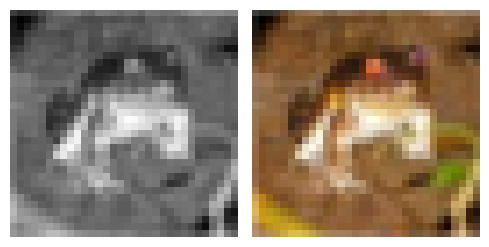

In [4]:
a, b = trn_ds[0]
subplots([a, b], nc=2)

In [5]:
class Identity(nn.Module):
    def __init__(self):
        super().__init__()
    def forward(self, x):
        return x

class DownConv(nn.Module):
    def __init__(self, ni, no, maxpool=True):
        super().__init__()
        self.model = nn.Sequential(
            nn.MaxPool2d(2) if maxpool else Identity(),
            nn.Conv2d(ni, no, 3, padding=1),
            nn.BatchNorm2d(no),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(no, no, 3, padding=1),
            nn.BatchNorm2d(no),
            nn.LeakyReLU(0.2, inplace=True),
        )
    def forward(self, x):
        return self.model(x)

class UpConv(nn.Module):
    def __init__(self, ni, no, maxpool=True):
        super().__init__()
        self.convtranspose = nn.ConvTranspose2d(ni, no, 2, stride=2)
        self.convlayers = nn.Sequential(
            nn.Conv2d(no+no, no, 3, padding=1),
            nn.BatchNorm2d(no),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(no, no, 3, padding=1),
            nn.BatchNorm2d(no),
            nn.LeakyReLU(0.2, inplace=True),
        )

    def forward(self, x, y):
        x = self.convtranspose(x)
        x = torch.cat([x,y], axis=1)
        x = self.convlayers(x)
        return x

class UNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.d1 = DownConv( 3, 64, maxpool=False)
        self.d2 = DownConv( 64, 128)
        self.d3 = DownConv( 128, 256)
        self.d4 = DownConv( 256, 512)
        self.d5 = DownConv( 512, 1024)
        self.u5 = UpConv (1024, 512)
        self.u4 = UpConv ( 512, 256)
        self.u3 = UpConv ( 256, 128)
        self.u2 = UpConv ( 128, 64)
        self.u1 = nn.Conv2d(64, 3, kernel_size=1, stride=1)

    def forward(self, x):
        x0 = self.d1( x) # 32
        x1 = self.d2(x0) # 16
        x2 = self.d3(x1) # 8
        x3 = self.d4(x2) # 4
        x4 = self.d5(x3) # 2
        X4 = self.u5(x4, x3)# 4
        X3 = self.u4(X4, x2)# 8
        X2 = self.u3(X3, x1)# 16
        X1 = self.u2(X2, x0)# 32
        X0 = self.u1(X1) # 3
        return X0

In [6]:
def get_model():
    model = UNet().to(device)
    optimizer = optim.Adam(model.parameters(), lr=1e-3)
    loss_fn = nn.MSELoss()
    return model, optimizer, loss_fn

In [7]:
def train_batch(model, data, optimizer, criterion):
    model.train()
    x, y = data
    _y = model(x)
    optimizer.zero_grad()
    loss = criterion(_y, y)
    loss.backward()
    optimizer.step()
    return loss.item()

@torch.no_grad()
def validate_batch(model, data, criterion):
    model.eval()
    x, y = data
    _y = model(x)
    loss = criterion(_y, y)
    return loss.item()

EPOCH: 0.250  trn_loss: 0.008  (34.68s - 13837.53s remaining)

EPOCH: 0.255  trn_loss: 0.008  (35.19s - 13760.07s remaining)

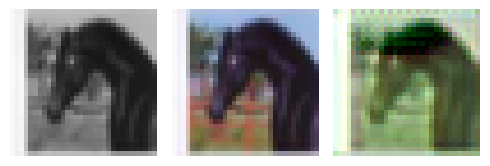

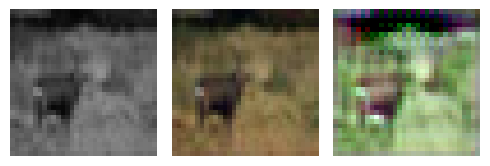

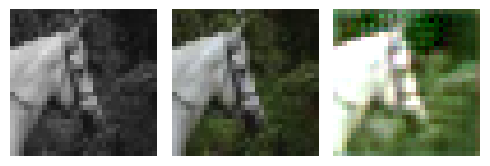

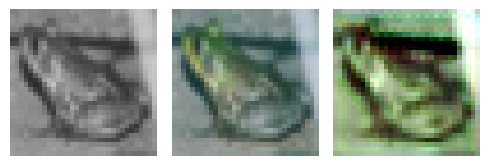

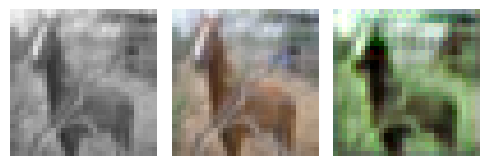

EPOCH: 0.510  trn_loss: 0.007  (60.90s - 11876.21s remaining)

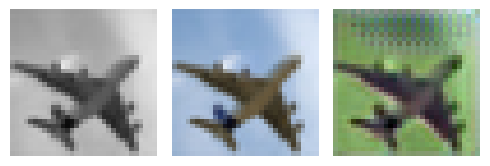

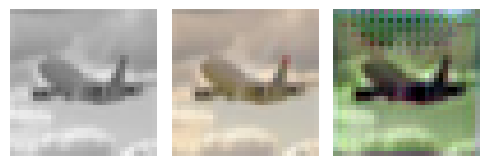

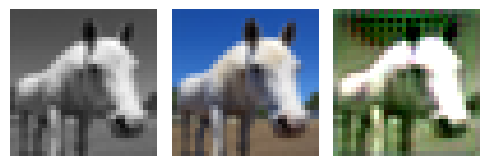

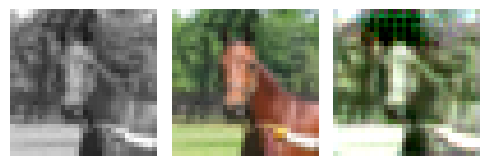

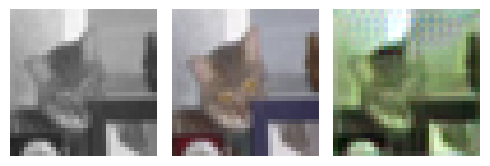

EPOCH: 0.765  trn_loss: 0.006  (87.25s - 11313.26s remaining)

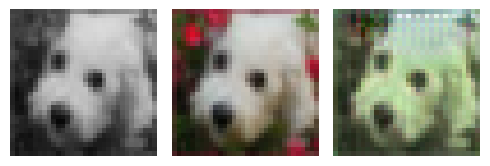

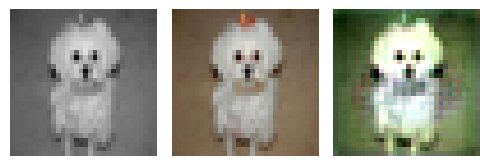

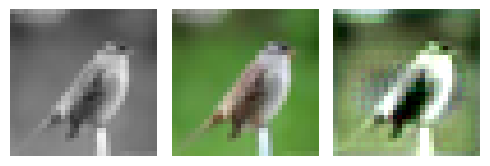

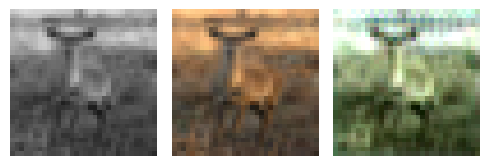

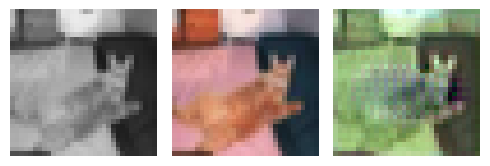

EPOCH: 1.000  val_loss: 0.005  (118.13s - 11695.10s remaining)

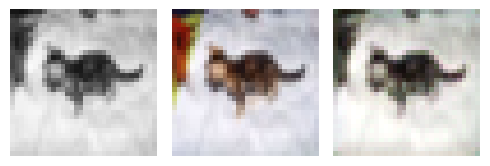

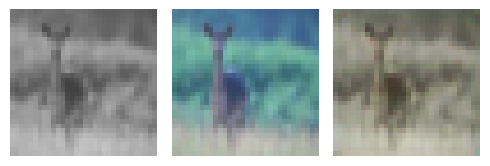

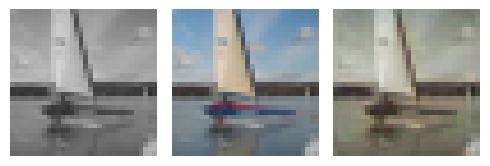

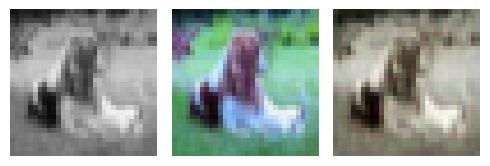

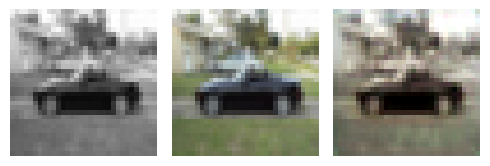

EPOCH: 1.250  trn_loss: 0.007  (143.45s - 11332.31s remaining)

EPOCH: 1.255  trn_loss: 0.006  (143.94s - 11324.60s remaining)

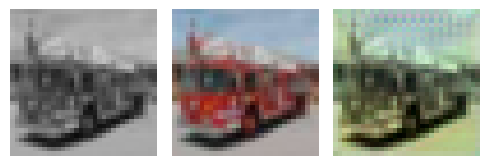

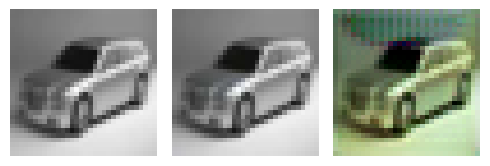

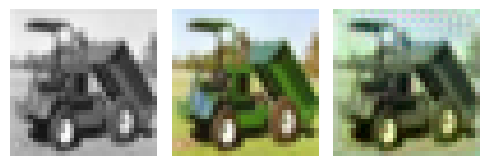

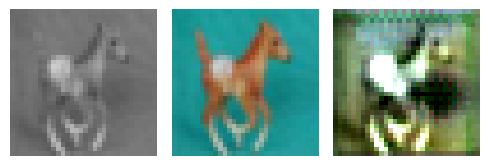

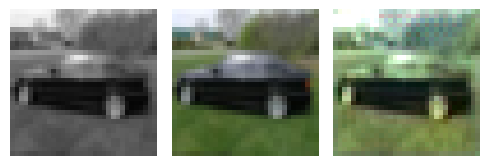

EPOCH: 1.505  trn_loss: 0.007  (169.21s - 11073.47s remaining)

EPOCH: 1.510  trn_loss: 0.006  (169.71s - 11067.68s remaining)

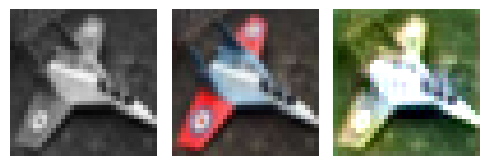

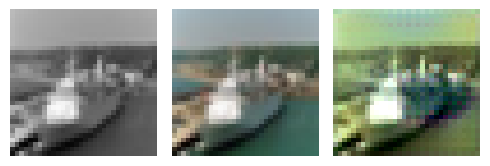

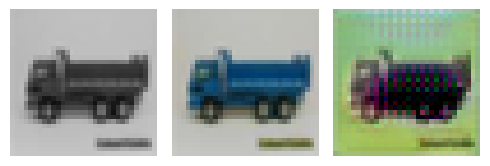

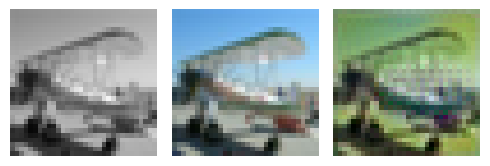

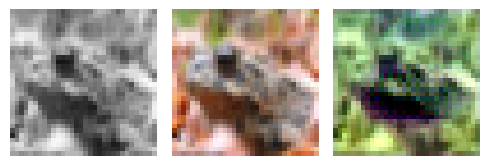

EPOCH: 1.760  trn_loss: 0.006  (195.13s - 10890.48s remaining)

EPOCH: 1.765  trn_loss: 0.005  (195.62s - 10885.73s remaining)

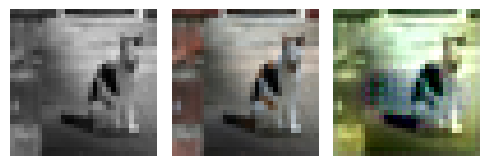

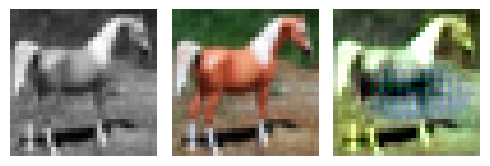

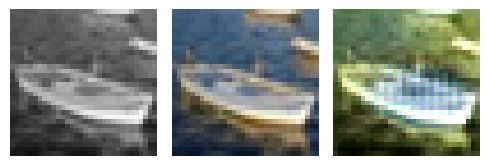

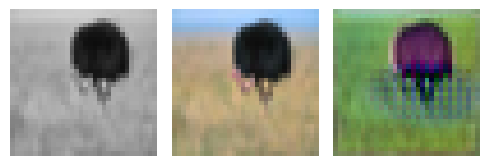

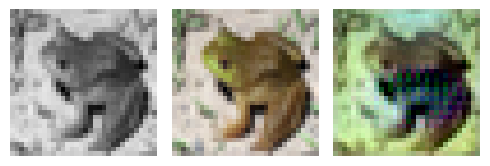

EPOCH: 1.950  val_loss: 0.007  (225.87s - 11357.16s remaining)

EPOCH: 2.000  val_loss: 0.004  (226.11s - 11079.38s remaining)

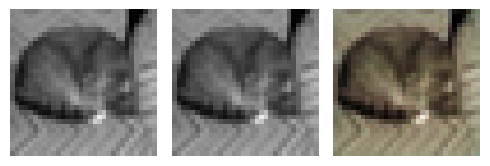

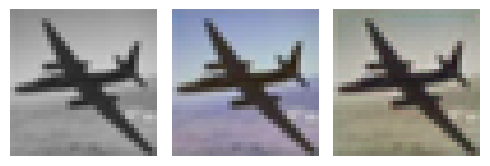

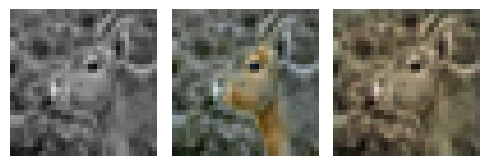

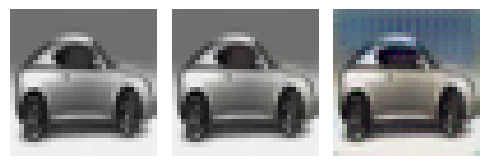

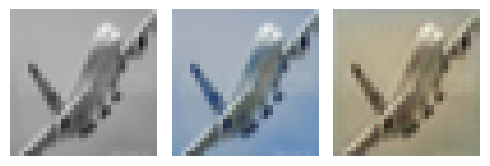

EPOCH: 2.250  trn_loss: 0.005  (251.76s - 10937.70s remaining)

EPOCH: 2.255  trn_loss: 0.005  (252.30s - 10935.49s remaining)

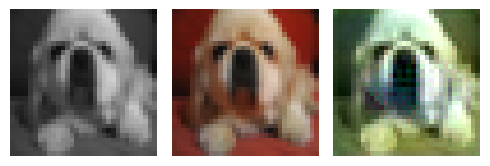

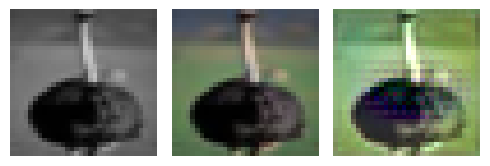

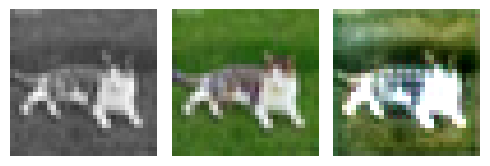

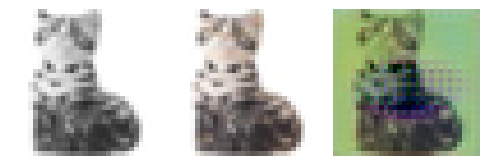

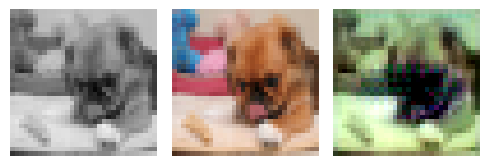

EPOCH: 2.505  trn_loss: 0.006  (278.09s - 10822.78s remaining)

EPOCH: 2.510  trn_loss: 0.006  (278.61s - 10820.44s remaining)

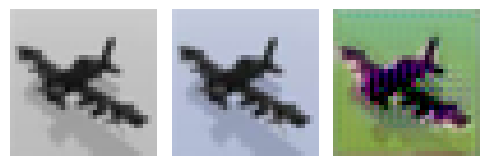

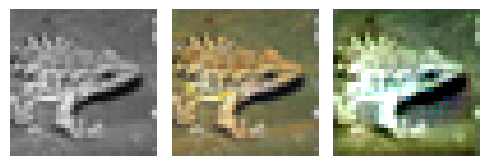

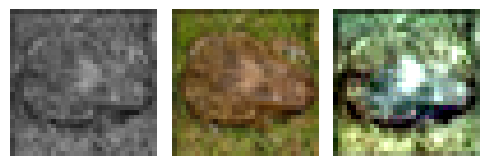

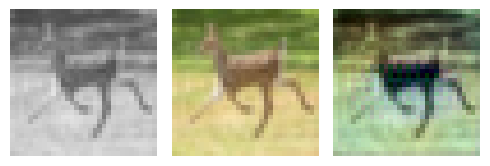

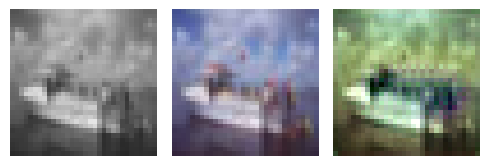

EPOCH: 2.765  trn_loss: 0.006  (305.06s - 10726.62s remaining)

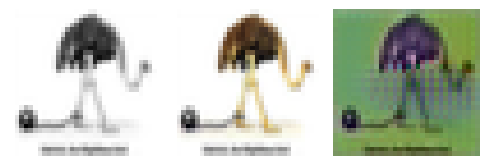

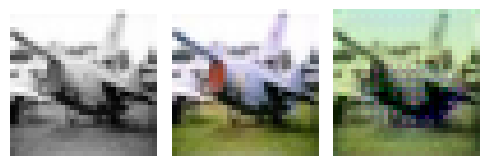

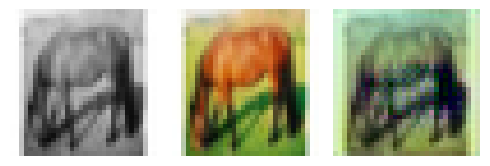

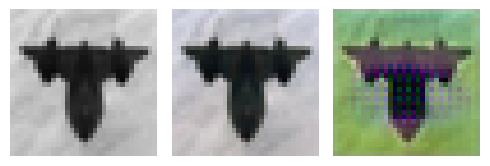

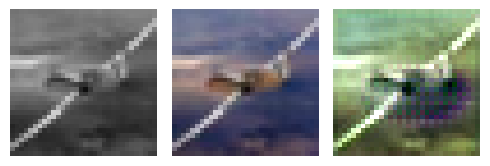

EPOCH: 3.000  val_loss: 0.005  (335.91s - 10861.20s remaining)

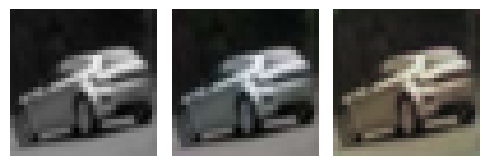

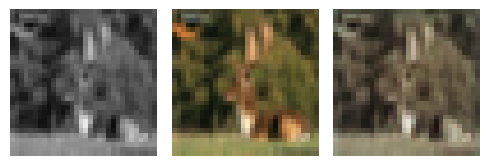

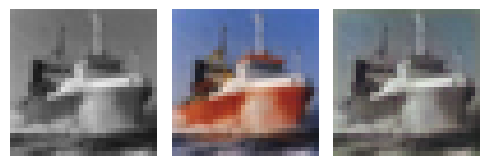

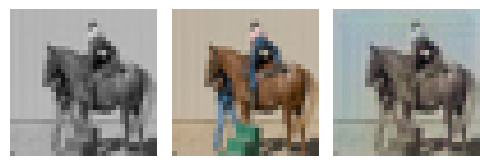

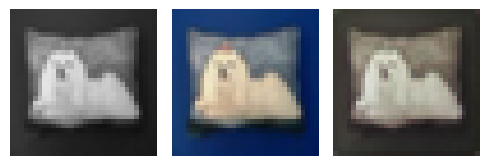

EPOCH: 3.250  trn_loss: 0.005  (361.18s - 10752.08s remaining)

EPOCH: 3.255  trn_loss: 0.006  (361.67s - 10749.23s remaining)

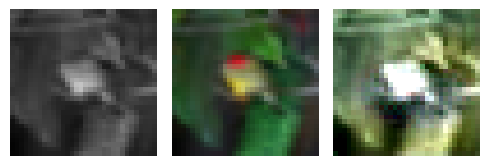

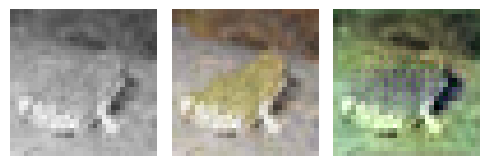

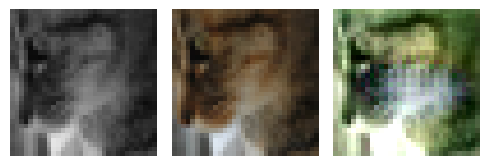

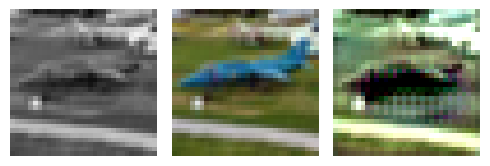

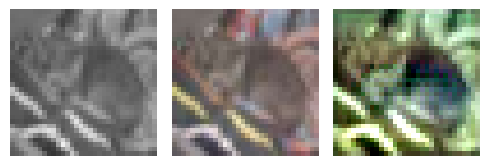

EPOCH: 3.505  trn_loss: 0.005  (387.17s - 10658.78s remaining)

EPOCH: 3.510  trn_loss: 0.005  (387.67s - 10656.53s remaining)

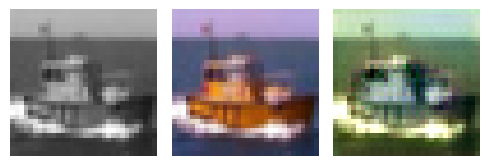

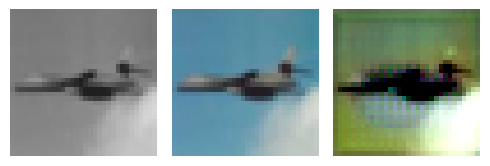

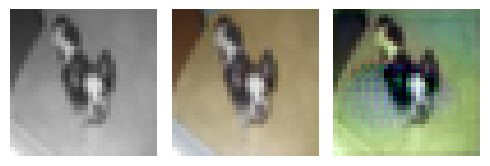

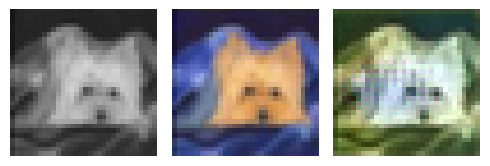

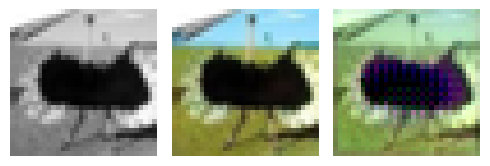

EPOCH: 3.760  trn_loss: 0.006  (413.32s - 10578.59s remaining)

EPOCH: 3.765  trn_loss: 0.005  (413.80s - 10576.12s remaining)

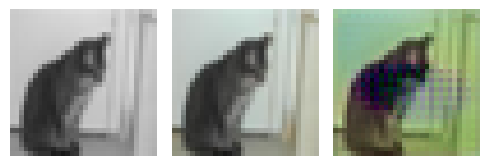

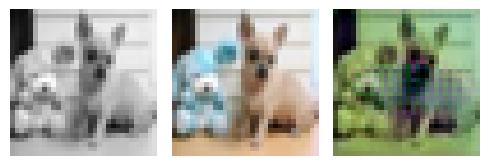

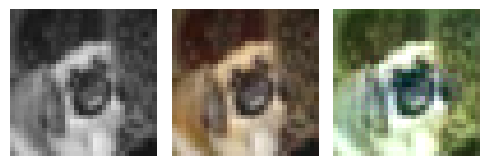

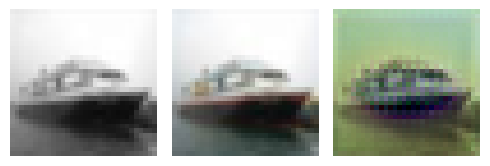

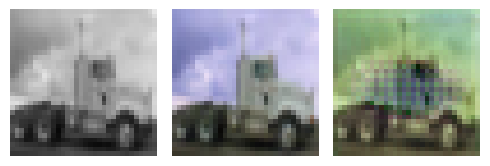

EPOCH: 3.950  val_loss: 0.006  (444.07s - 10798.18s remaining)

EPOCH: 4.000  val_loss: 0.004  (444.31s - 10663.38s remaining)

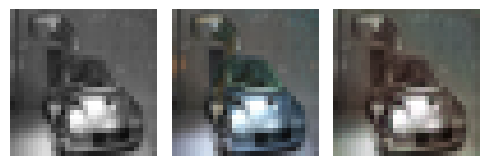

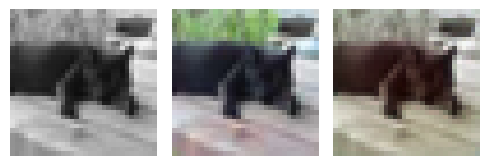

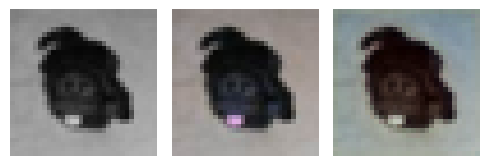

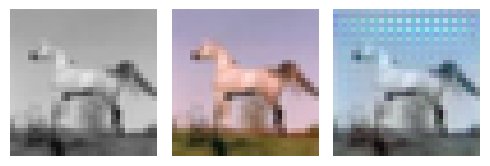

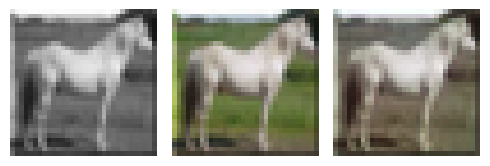

EPOCH: 4.250  trn_loss: 0.006  (470.14s - 10591.99s remaining)

EPOCH: 4.255  trn_loss: 0.005  (470.67s - 10590.61s remaining)

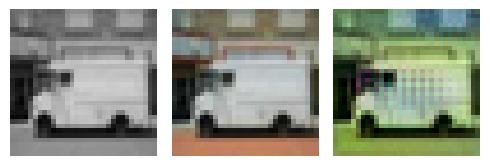

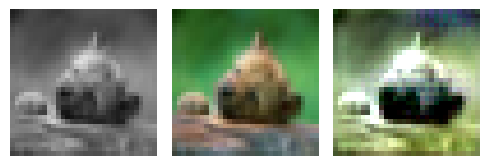

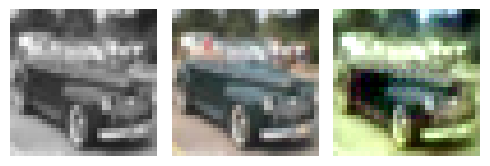

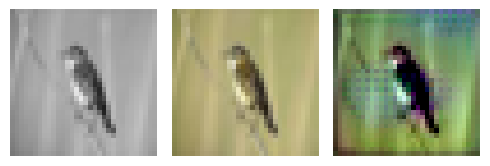

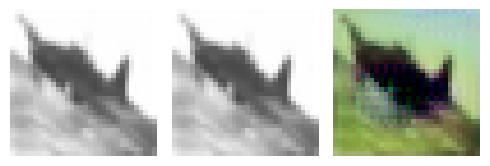

EPOCH: 4.505  trn_loss: 0.005  (496.72s - 10528.96s remaining)

EPOCH: 4.510  trn_loss: 0.006  (497.25s - 10527.83s remaining)

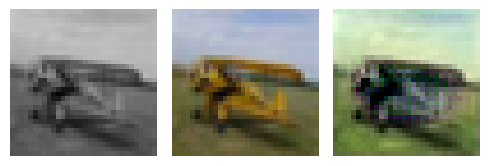

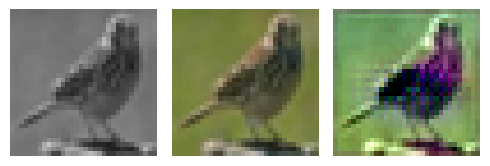

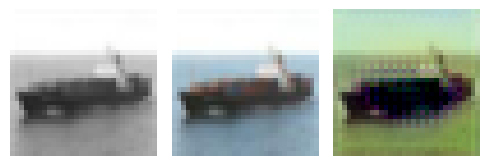

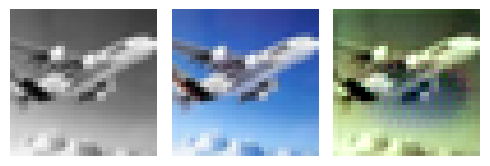

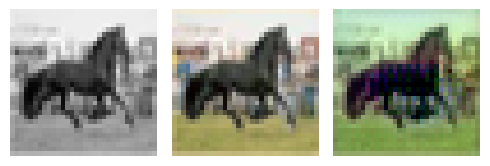

EPOCH: 4.760  trn_loss: 0.004  (523.23s - 10468.49s remaining)

EPOCH: 4.765  trn_loss: 0.005  (523.77s - 10467.58s remaining)

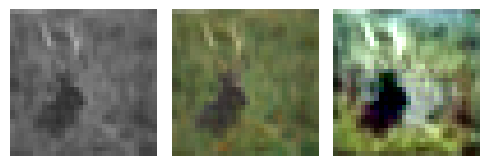

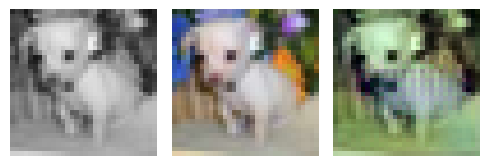

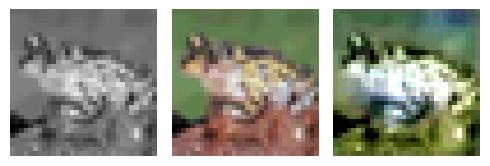

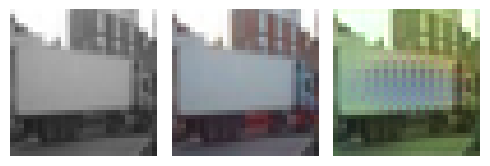

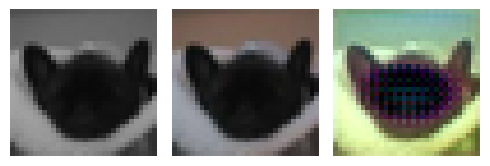

EPOCH: 5.000  trn_loss: 0.005  val_loss: 0.005  (554.87s - 10542.55s remaining)


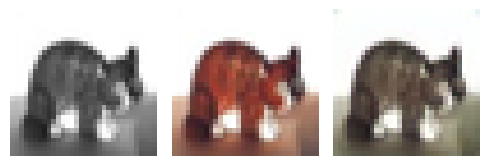

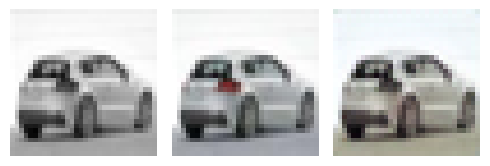

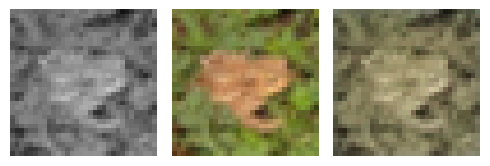

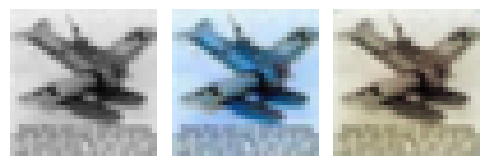

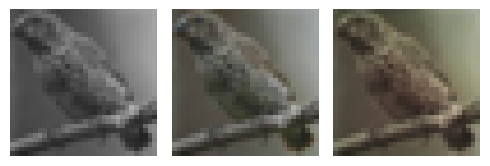

EPOCH: 5.250  trn_loss: 0.006  (580.71s - 10480.51s remaining)

EPOCH: 5.255  trn_loss: 0.005  (581.21s - 10478.71s remaining)

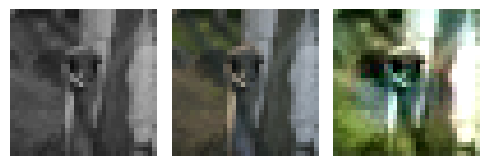

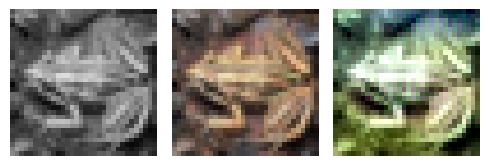

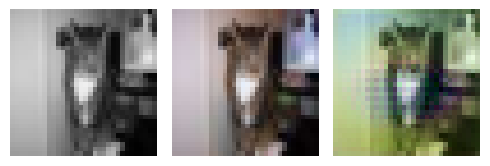

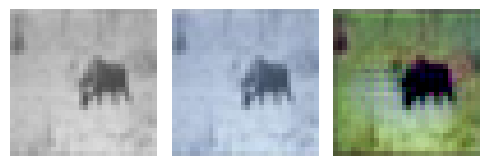

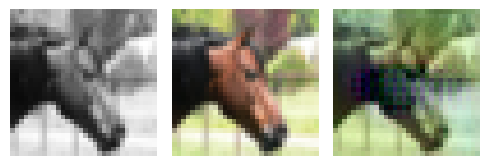

EPOCH: 5.505  trn_loss: 0.005  (606.91s - 10417.57s remaining)

EPOCH: 5.510  trn_loss: 0.005  (607.42s - 10416.20s remaining)

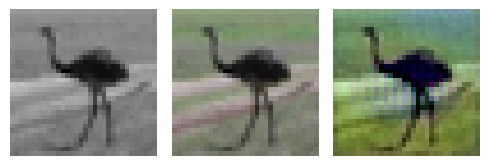

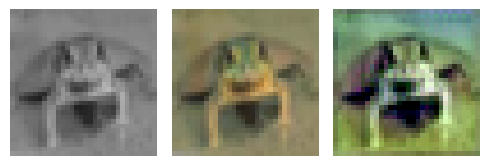

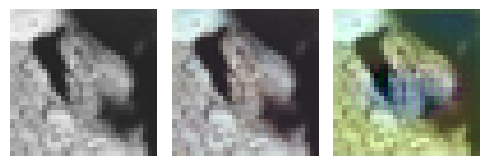

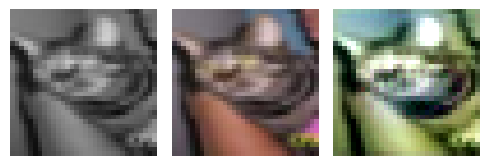

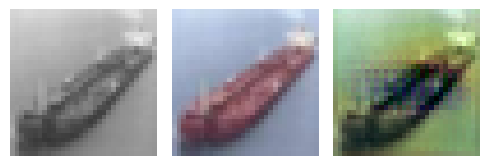

EPOCH: 5.760  trn_loss: 0.005  (633.15s - 10358.72s remaining)

EPOCH: 5.765  trn_loss: 0.005  (633.65s - 10357.10s remaining)

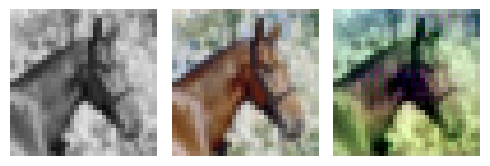

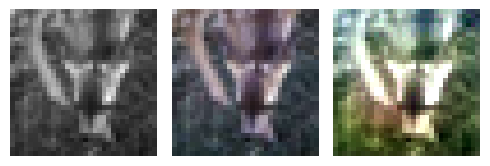

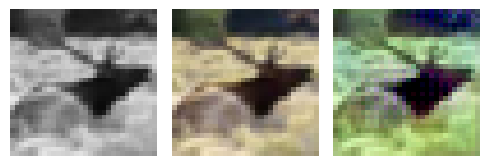

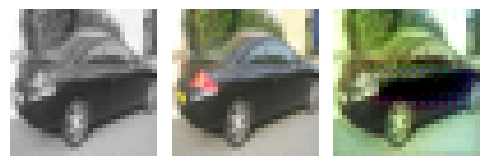

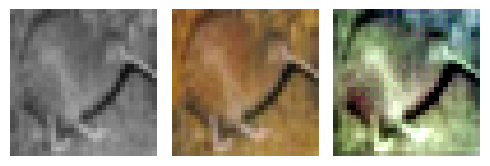

EPOCH: 6.000  val_loss: 0.004  (664.34s - 10407.96s remaining)

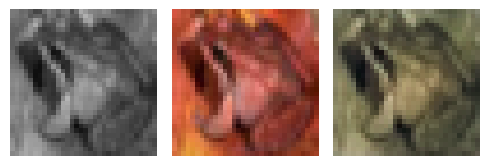

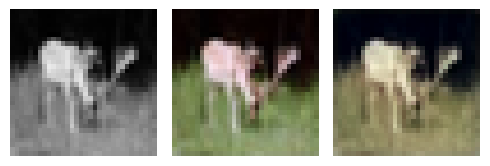

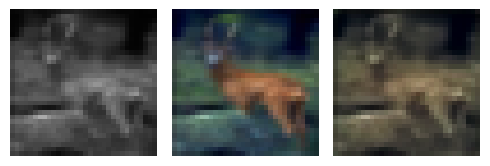

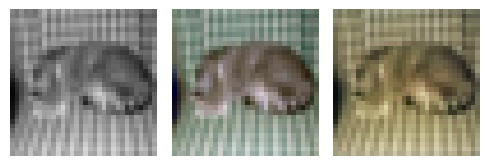

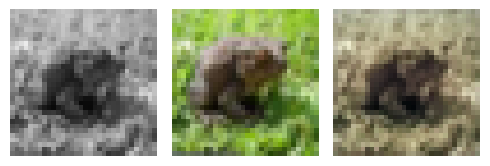

EPOCH: 6.250  trn_loss: 0.005  (690.61s - 10359.12s remaining)

EPOCH: 6.255  trn_loss: 0.006  (691.14s - 10358.11s remaining)

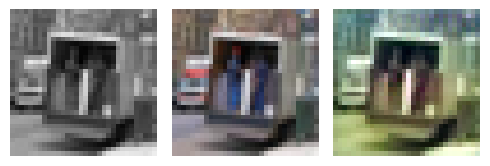

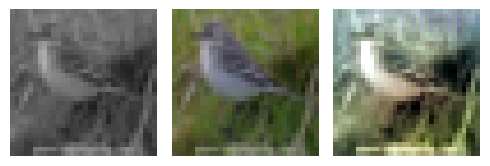

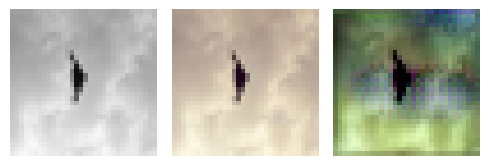

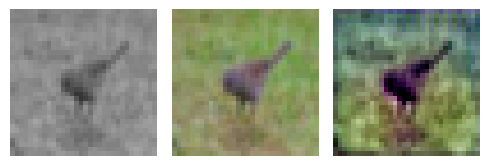

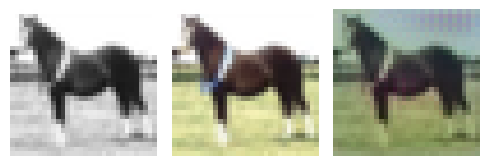

EPOCH: 6.505  trn_loss: 0.006  (716.97s - 10304.73s remaining)

EPOCH: 6.510  trn_loss: 0.005  (717.51s - 10303.85s remaining)

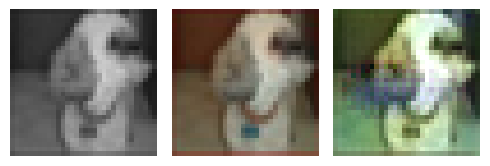

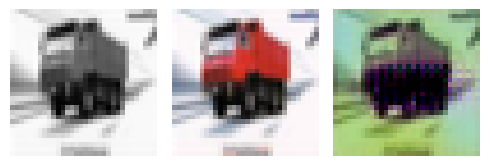

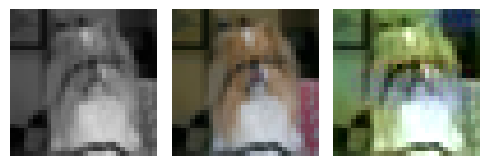

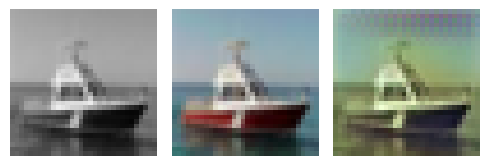

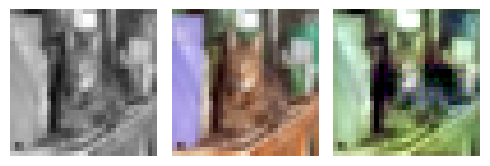

EPOCH: 6.760  trn_loss: 0.005  (743.44s - 10253.84s remaining)

EPOCH: 6.765  trn_loss: 0.005  (743.98s - 10253.03s remaining)

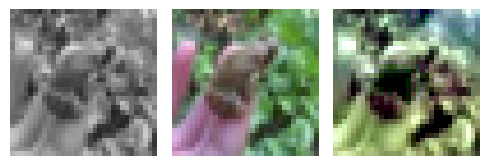

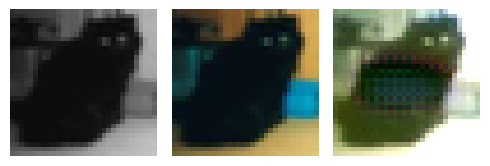

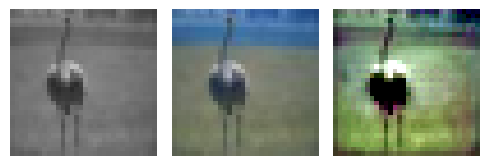

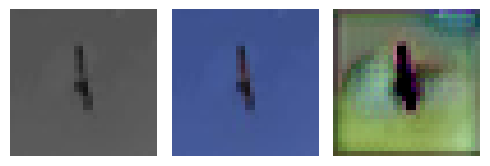

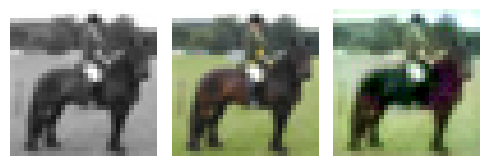

EPOCH: 7.000  val_loss: 0.003  (775.48s - 10302.85s remaining)

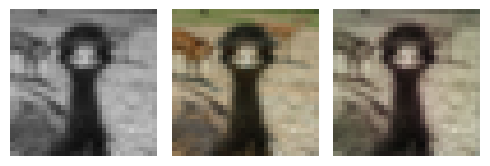

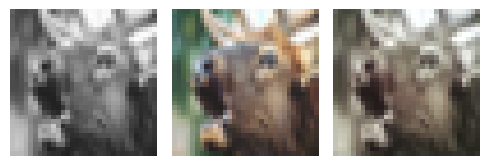

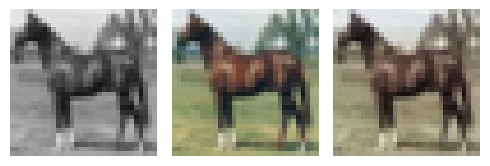

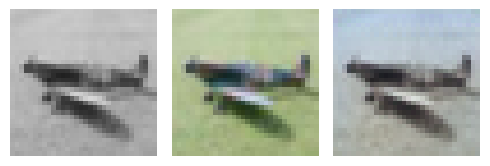

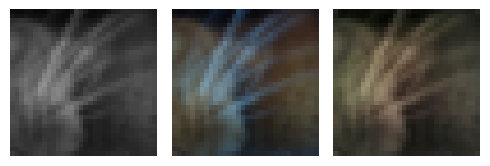

EPOCH: 7.250  trn_loss: 0.005  (801.03s - 10247.63s remaining)

EPOCH: 7.255  trn_loss: 0.005  (801.52s - 10246.20s remaining)

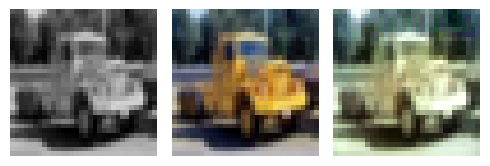

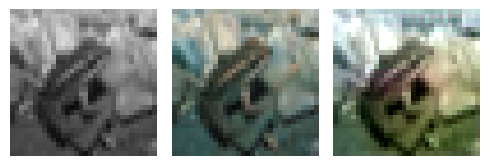

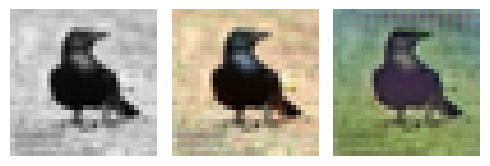

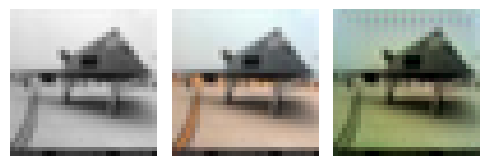

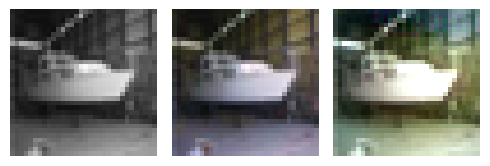

EPOCH: 7.505  trn_loss: 0.005  (827.12s - 10193.59s remaining)

EPOCH: 7.510  trn_loss: 0.005  (827.62s - 10192.28s remaining)

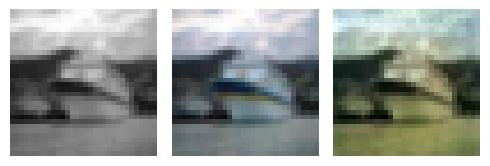

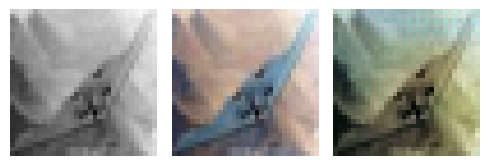

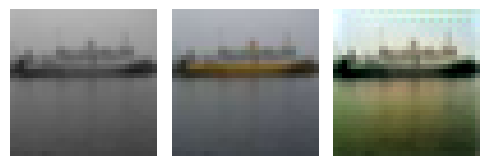

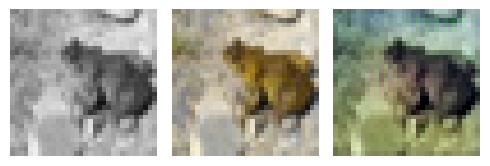

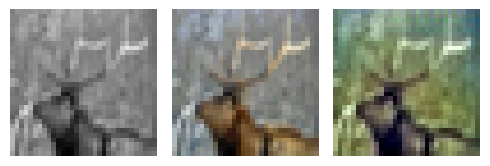

EPOCH: 7.765  trn_loss: 0.005  (853.70s - 10140.08s remaining)

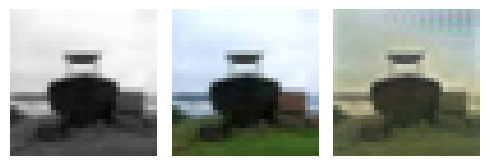

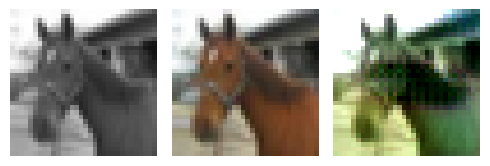

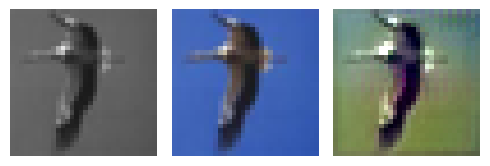

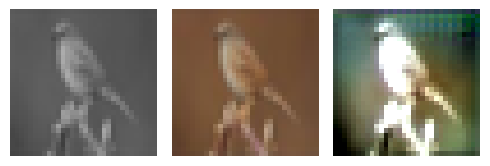

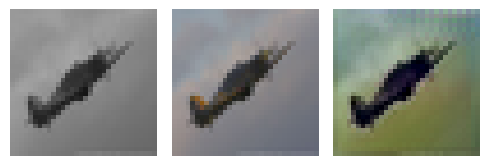

EPOCH: 8.000  val_loss: 0.003  (884.81s - 10175.34s remaining)

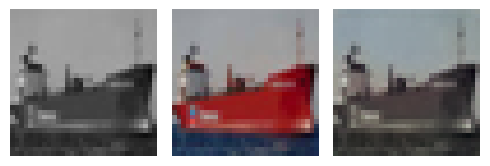

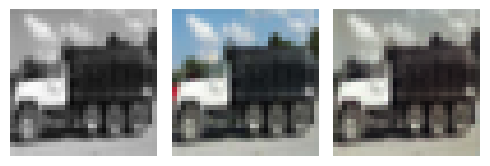

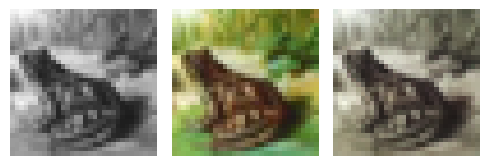

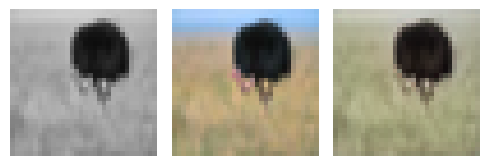

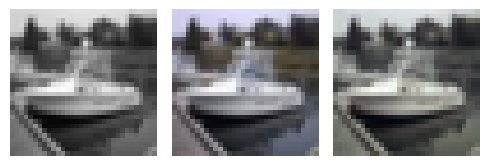

EPOCH: 8.250  trn_loss: 0.005  (910.89s - 10130.24s remaining)

EPOCH: 8.255  trn_loss: 0.005  (911.44s - 10129.51s remaining)

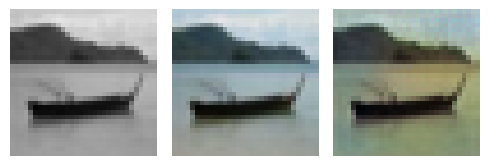

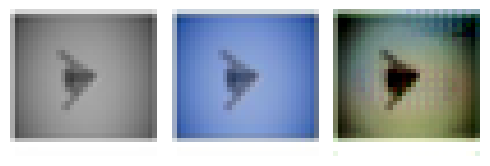

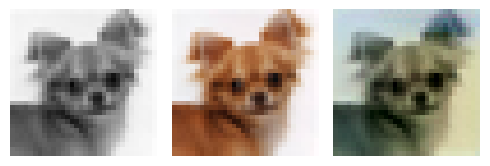

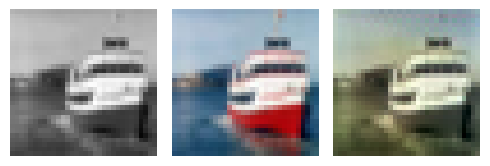

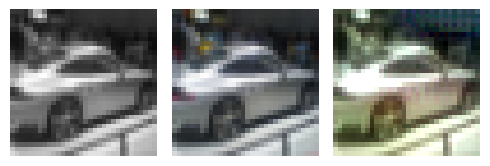

EPOCH: 8.505  trn_loss: 0.005  (937.81s - 10088.68s remaining)

EPOCH: 8.510  trn_loss: 0.005  (938.35s - 10087.83s remaining)

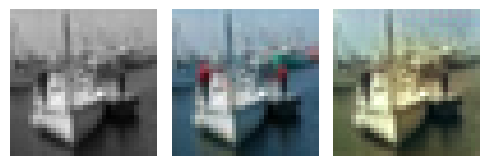

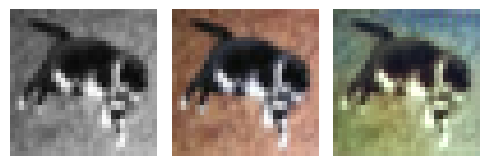

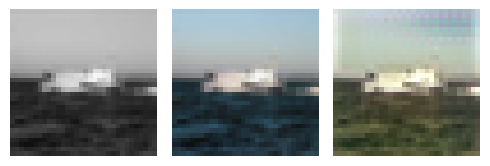

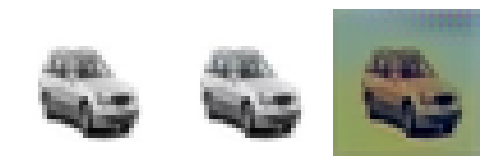

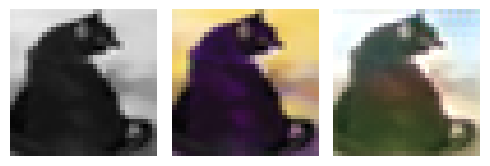

EPOCH: 8.760  trn_loss: 0.005  (964.69s - 10047.48s remaining)

EPOCH: 8.765  trn_loss: 0.005  (965.21s - 10046.47s remaining)

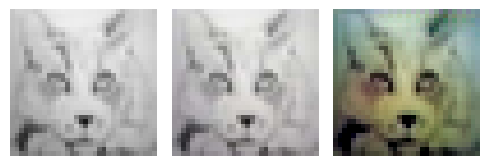

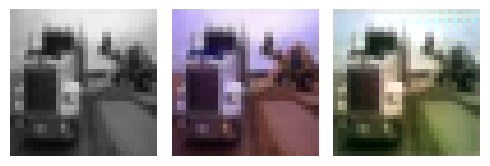

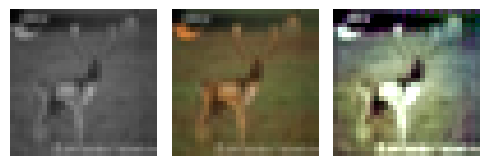

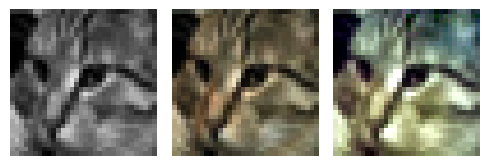

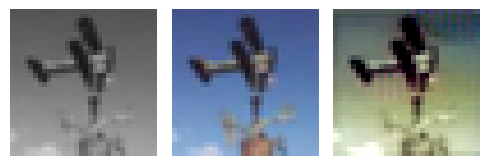

EPOCH: 8.950  val_loss: 0.006  (996.23s - 10134.87s remaining)

EPOCH: 9.000  val_loss: 0.004  (996.42s - 10074.95s remaining)

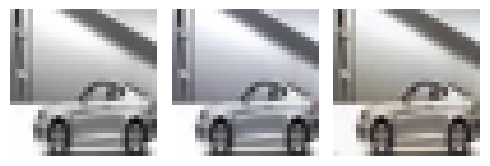

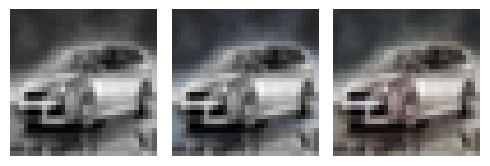

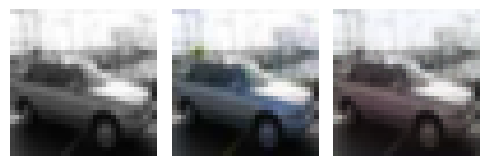

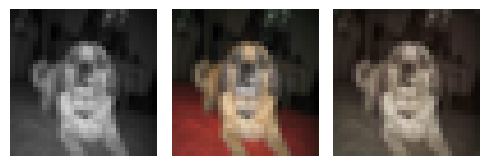

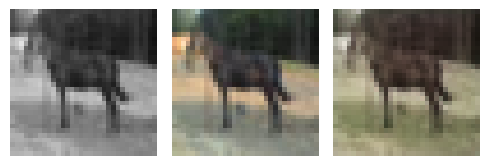

EPOCH: 9.250  trn_loss: 0.005  (1022.17s - 10028.30s remaining)

EPOCH: 9.255  trn_loss: 0.006  (1022.67s - 10027.09s remaining)

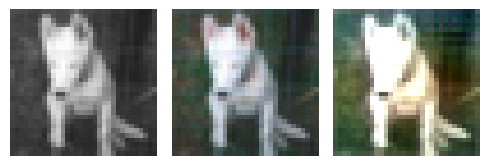

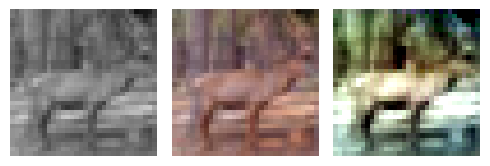

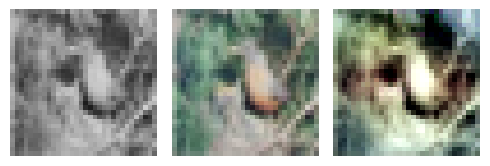

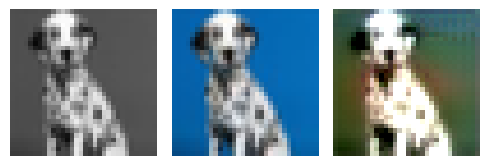

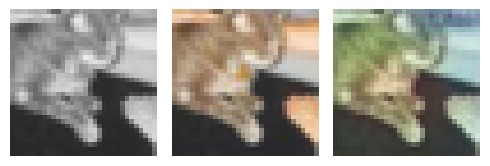

EPOCH: 9.505  trn_loss: 0.005  (1048.68s - 9984.10s remaining)

EPOCH: 9.510  trn_loss: 0.005  (1049.17s - 9982.86s remaining)

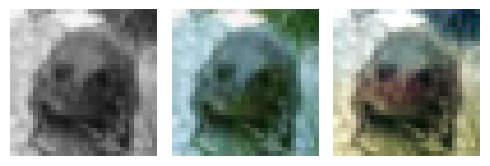

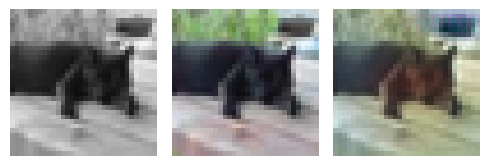

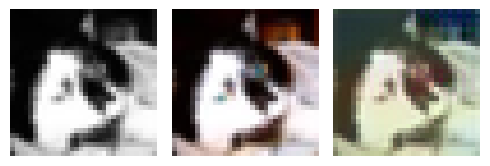

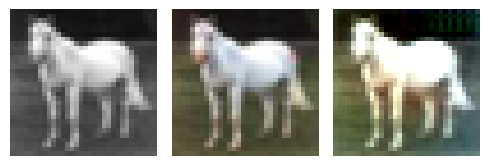

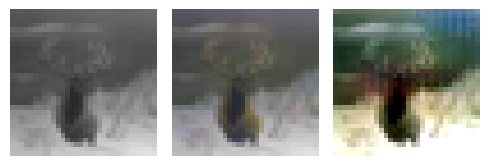

EPOCH: 9.755  trn_loss: 0.005  (1074.83s - 9943.33s remaining)

EPOCH: 9.765  trn_loss: 0.005  (1075.86s - 9941.27s remaining)

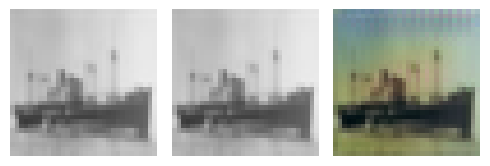

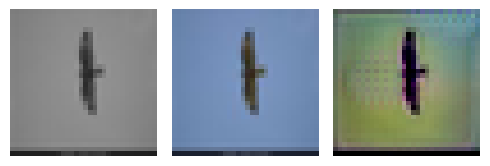

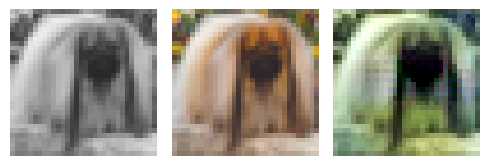

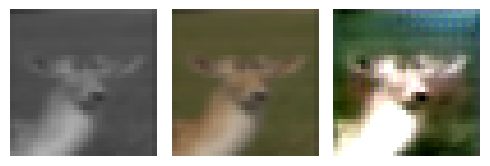

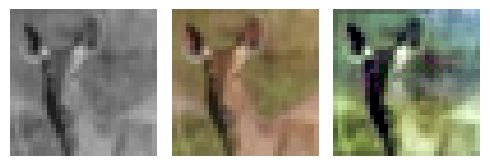

EPOCH: 9.950  val_loss: 0.006  (1106.98s - 10018.49s remaining)

EPOCH: 10.000  trn_loss: 0.005  val_loss: 0.006  (1107.24s - 9965.15s remaining)


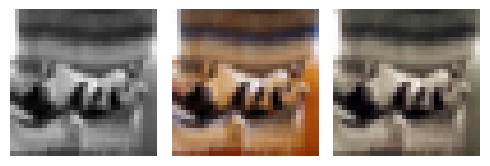

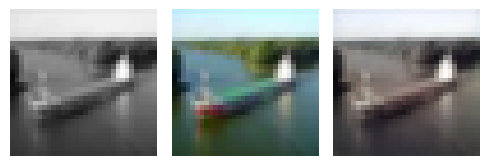

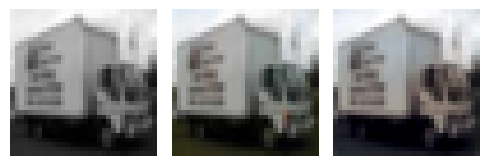

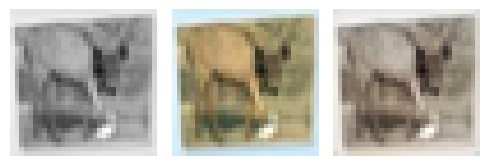

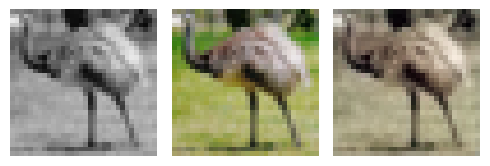

EPOCH: 10.250  trn_loss: 0.005  (1133.25s - 9922.83s remaining)

EPOCH: 10.255  trn_loss: 0.005  (1133.80s - 9922.16s remaining)

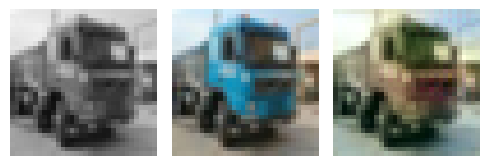

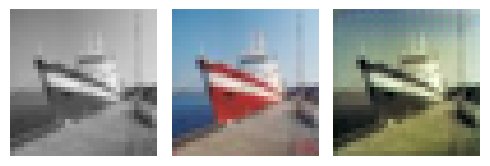

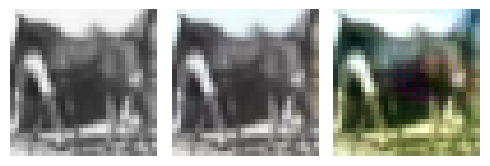

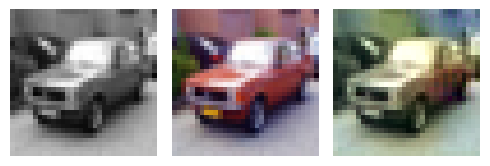

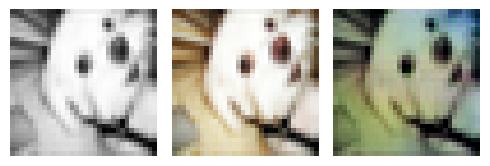

EPOCH: 10.505  trn_loss: 0.006  (1160.22s - 9884.14s remaining)

EPOCH: 10.510  trn_loss: 0.005  (1160.72s - 9883.04s remaining)

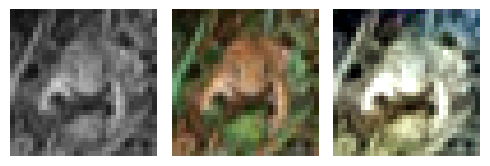

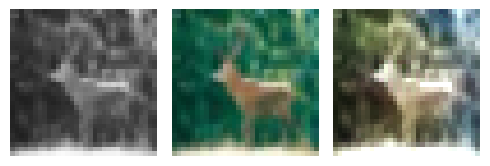

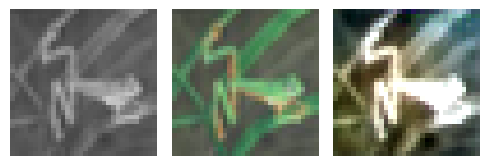

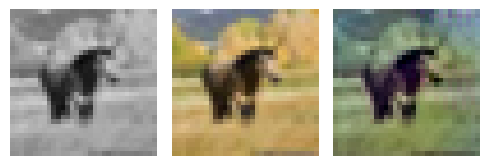

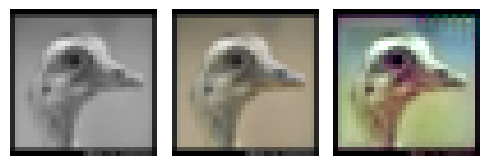

EPOCH: 10.760  trn_loss: 0.005  (1186.80s - 9842.74s remaining)

EPOCH: 10.765  trn_loss: 0.004  (1187.31s - 9841.75s remaining)

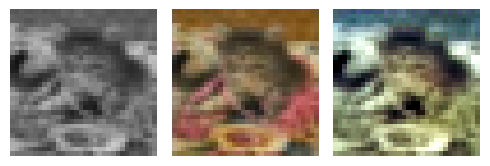

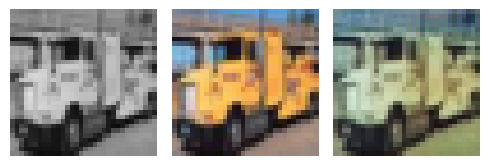

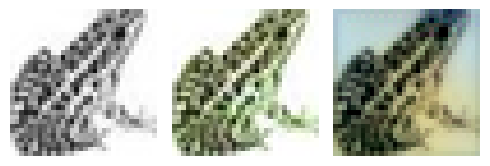

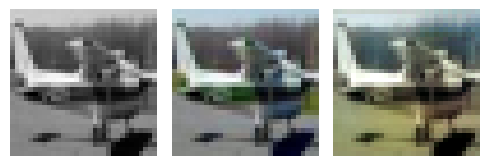

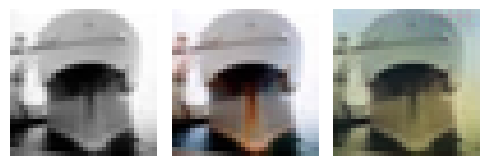

EPOCH: 11.000  val_loss: 0.003  (1218.47s - 9858.51s remaining)

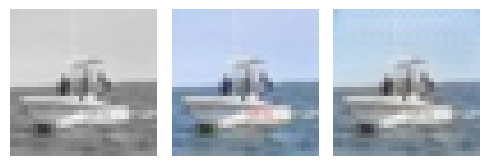

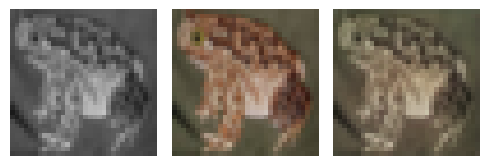

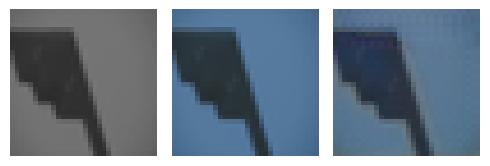

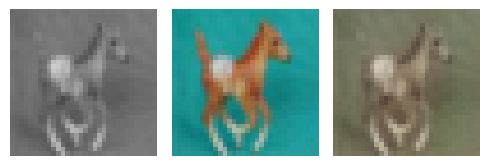

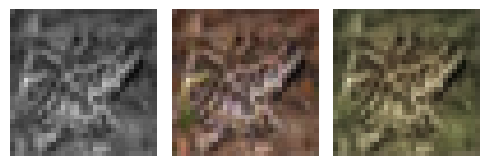

EPOCH: 11.250  trn_loss: 0.004  (1244.61s - 9818.56s remaining)

EPOCH: 11.255  trn_loss: 0.004  (1245.11s - 9817.53s remaining)

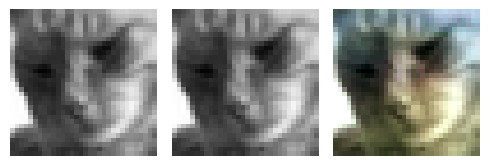

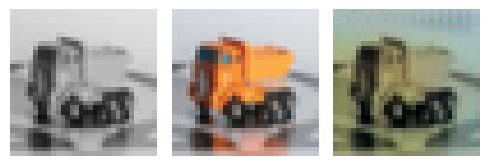

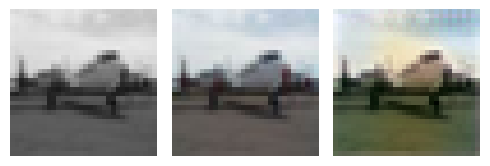

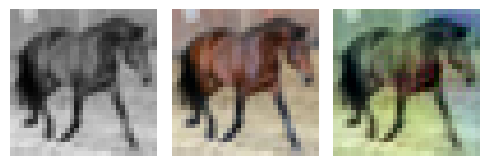

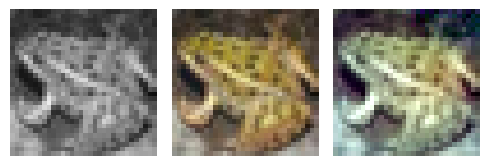

EPOCH: 11.505  trn_loss: 0.005  (1271.28s - 9778.45s remaining)

EPOCH: 11.510  trn_loss: 0.005  (1271.79s - 9777.42s remaining)

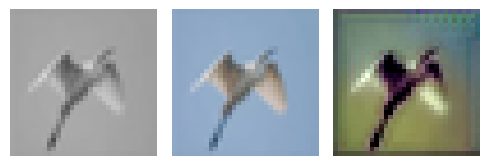

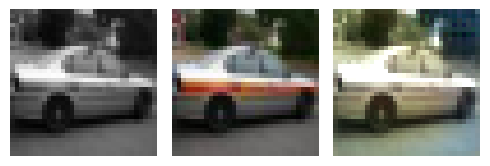

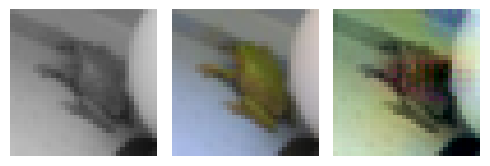

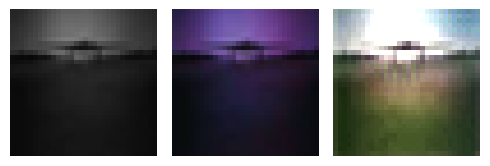

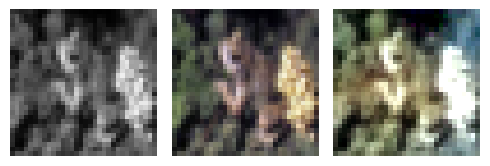

EPOCH: 11.760  trn_loss: 0.005  (1297.97s - 9739.01s remaining)

EPOCH: 11.765  trn_loss: 0.005  (1298.48s - 9738.01s remaining)

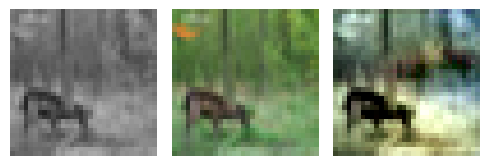

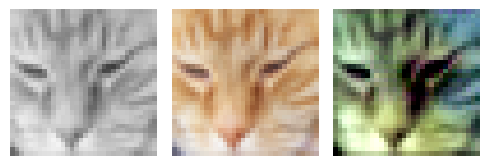

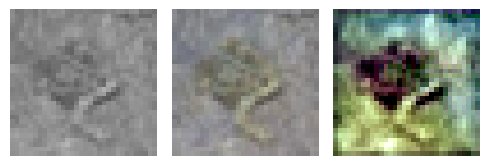

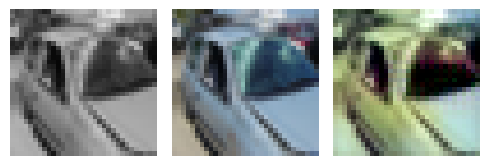

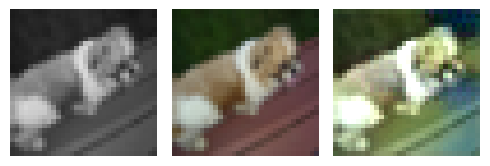

EPOCH: 12.000  val_loss: 0.003  (1330.64s - 9758.05s remaining)

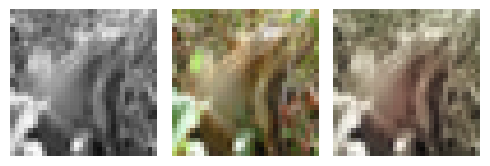

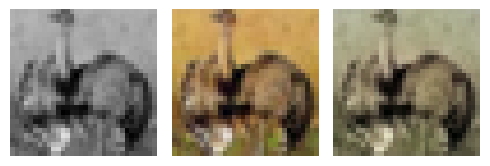

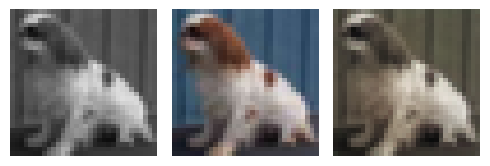

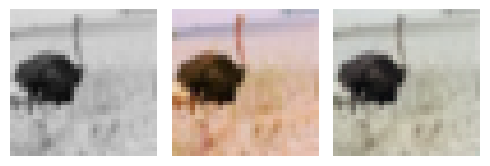

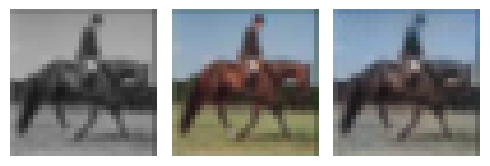

EPOCH: 12.250  trn_loss: 0.006  (1356.53s - 9717.20s remaining)

EPOCH: 12.255  trn_loss: 0.005  (1357.04s - 9716.21s remaining)

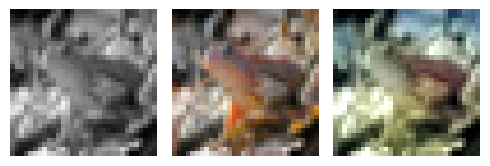

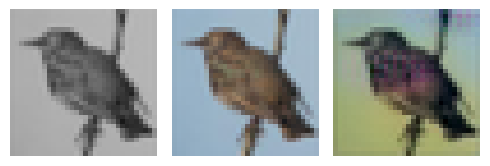

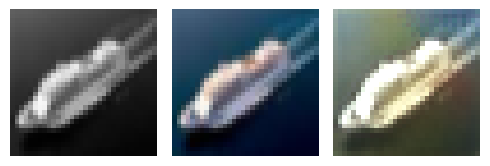

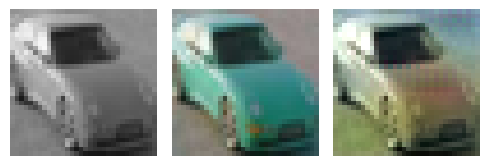

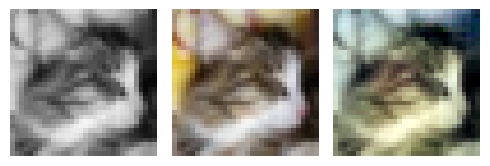

EPOCH: 12.505  trn_loss: 0.006  (1383.20s - 9677.91s remaining)

EPOCH: 12.510  trn_loss: 0.005  (1383.72s - 9677.04s remaining)

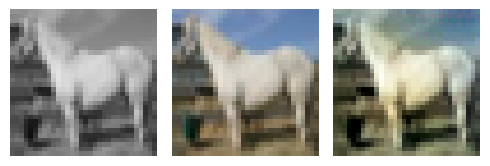

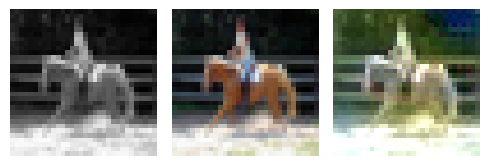

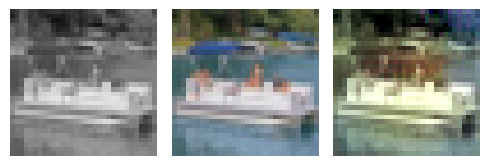

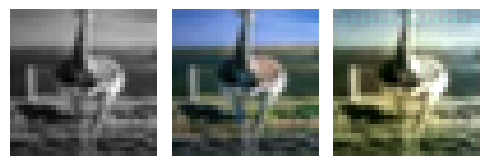

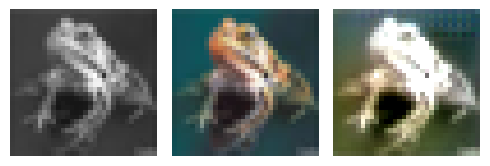

EPOCH: 12.760  trn_loss: 0.005  (1409.73s - 9638.15s remaining)

EPOCH: 12.765  trn_loss: 0.004  (1410.23s - 9637.16s remaining)

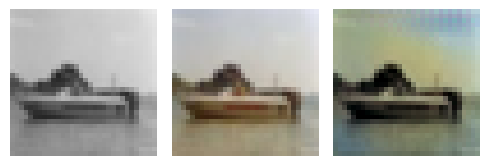

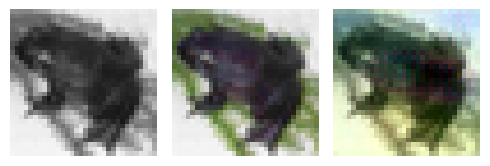

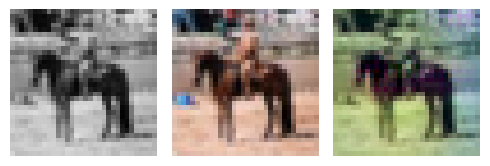

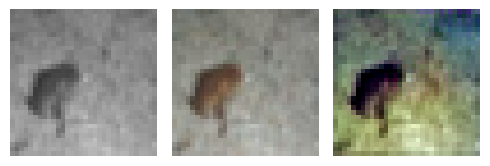

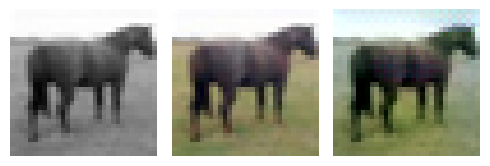

EPOCH: 13.000  val_loss: 0.003  (1441.74s - 9648.55s remaining)

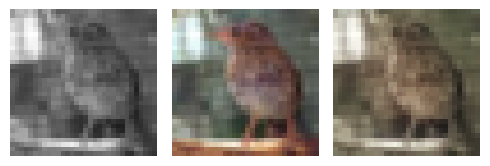

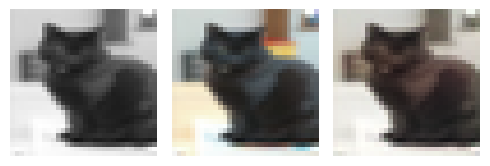

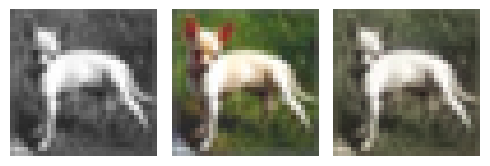

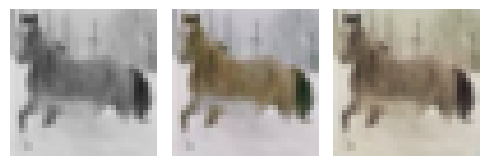

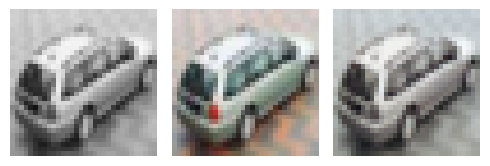

EPOCH: 13.245  trn_loss: 0.005  (1467.51s - 9612.32s remaining)

EPOCH: 13.255  trn_loss: 0.005  (1468.52s - 9610.37s remaining)

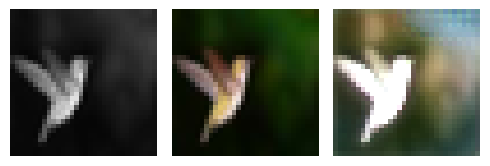

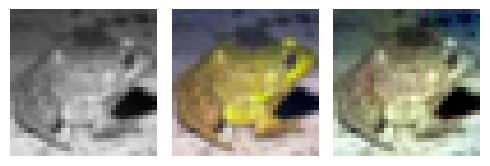

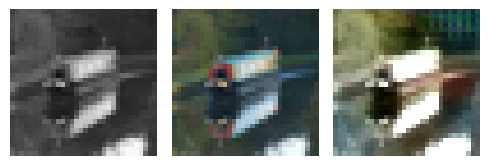

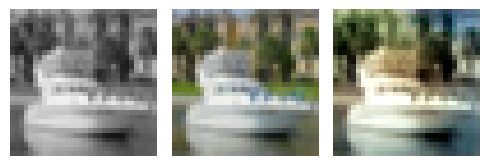

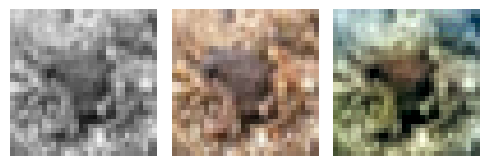

EPOCH: 13.505  trn_loss: 0.005  (1494.70s - 9572.98s remaining)

EPOCH: 13.510  trn_loss: 0.005  (1495.24s - 9572.22s remaining)

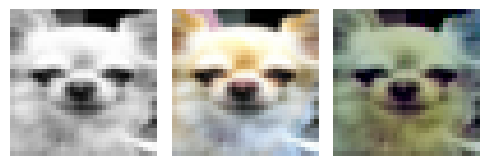

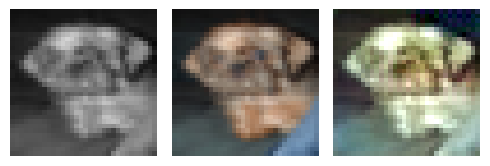

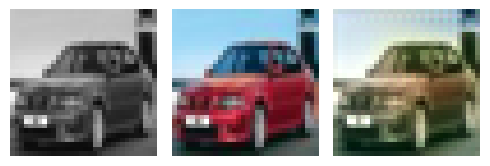

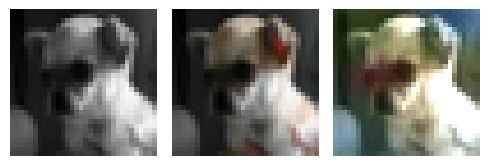

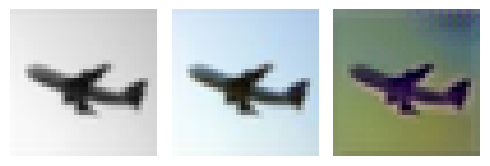

EPOCH: 13.765  trn_loss: 0.004  (1522.59s - 9538.47s remaining)

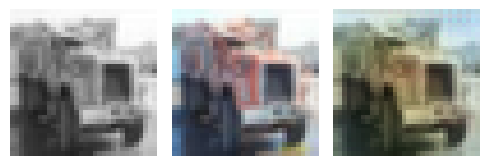

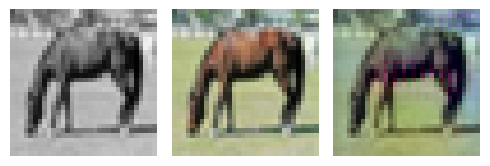

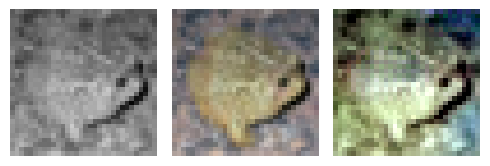

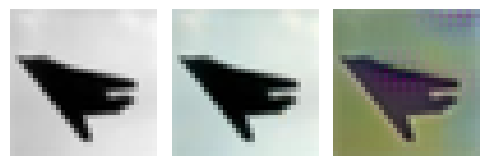

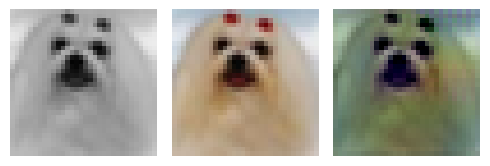

EPOCH: 14.000  val_loss: 0.003  (1554.55s - 9549.35s remaining)

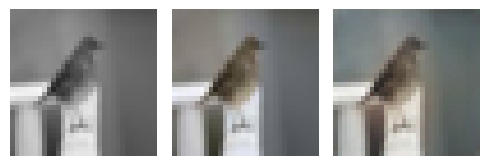

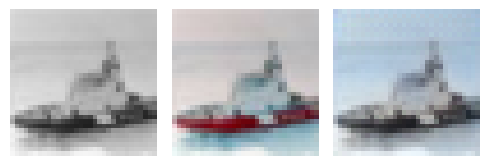

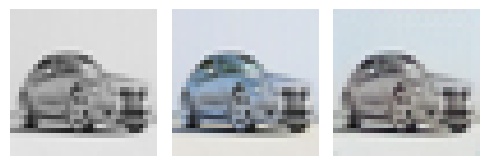

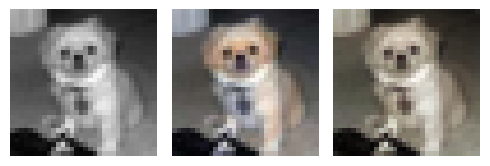

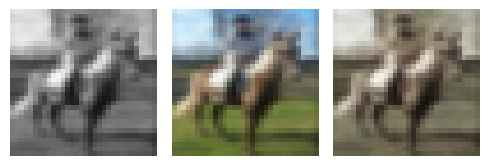

EPOCH: 14.250  trn_loss: 0.005  (1580.65s - 9511.62s remaining)

EPOCH: 14.255  trn_loss: 0.005  (1581.15s - 9510.67s remaining)

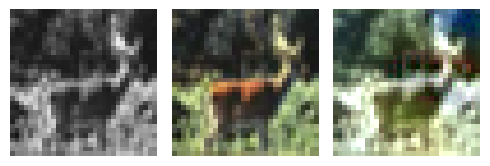

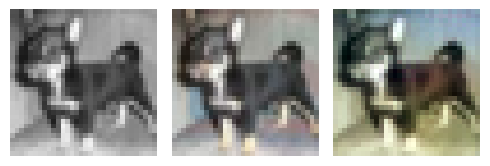

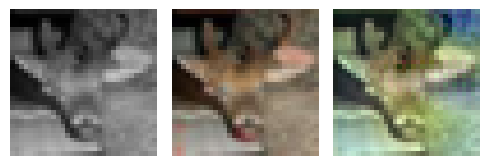

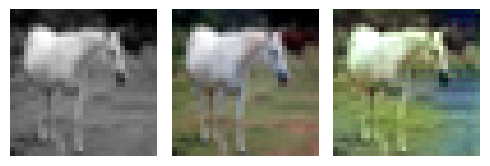

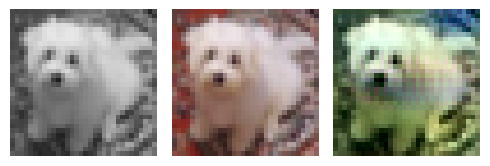

EPOCH: 14.505  trn_loss: 0.005  (1607.48s - 9474.67s remaining)

EPOCH: 14.510  trn_loss: 0.005  (1607.98s - 9473.75s remaining)

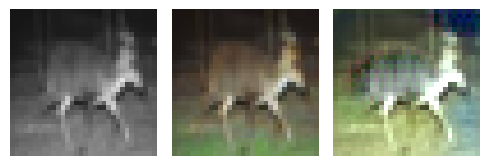

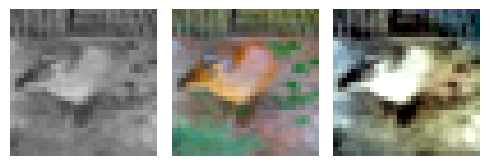

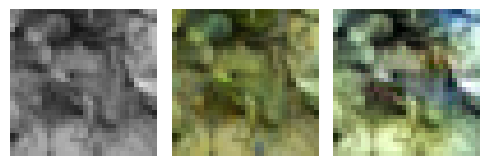

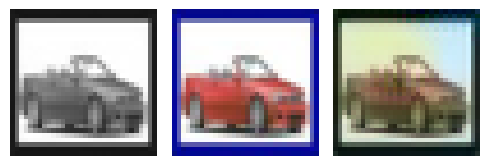

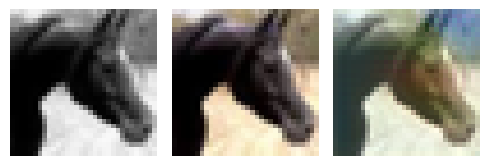

EPOCH: 14.760  trn_loss: 0.005  (1634.44s - 9438.84s remaining)

EPOCH: 14.765  trn_loss: 0.005  (1634.94s - 9437.93s remaining)

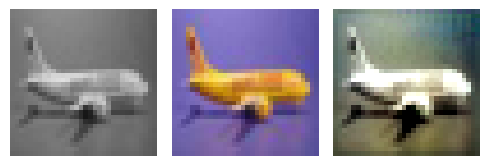

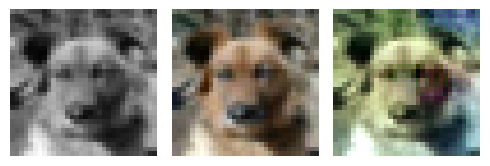

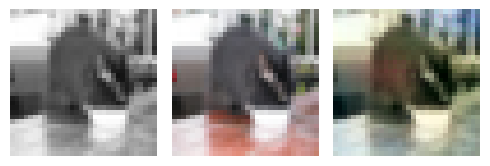

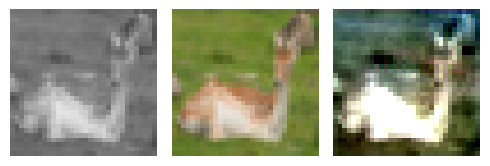

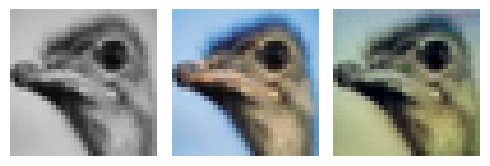

EPOCH: 15.000  trn_loss: 0.005  val_loss: 0.005  (1666.67s - 9444.49s remaining)


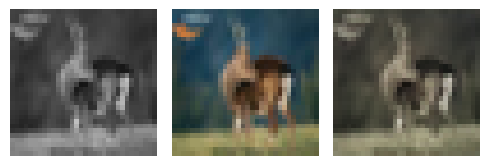

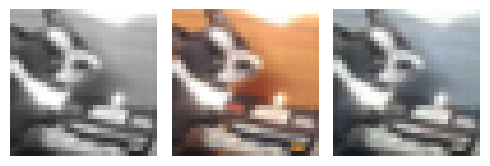

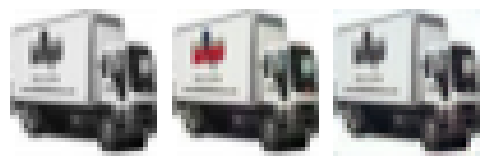

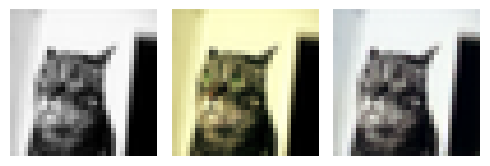

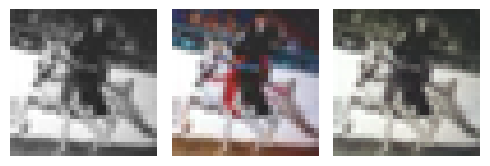

EPOCH: 15.255  trn_loss: 0.005  (1693.58s - 9408.17s remaining)

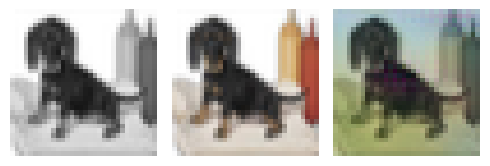

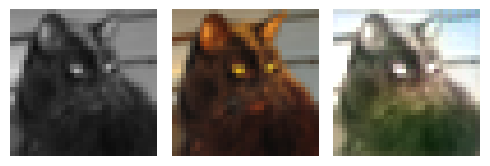

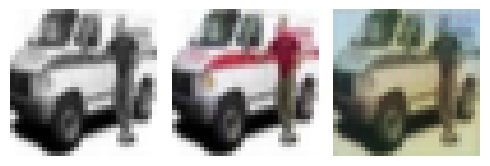

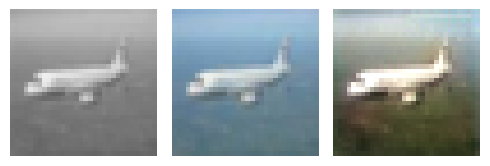

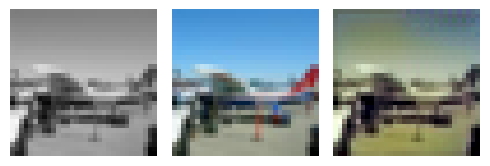

EPOCH: 15.505  trn_loss: 0.005  (1720.05s - 9373.42s remaining)

EPOCH: 15.510  trn_loss: 0.005  (1720.57s - 9372.56s remaining)

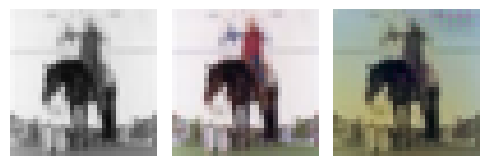

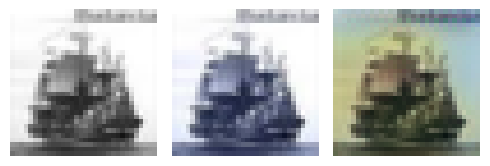

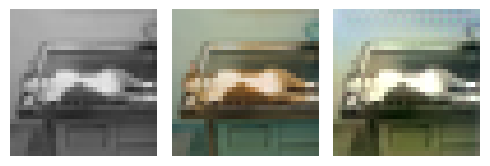

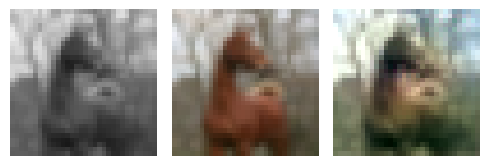

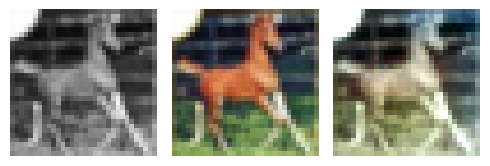

EPOCH: 15.760  trn_loss: 0.005  (1746.80s - 9336.79s remaining)

EPOCH: 15.765  trn_loss: 0.004  (1747.30s - 9335.90s remaining)

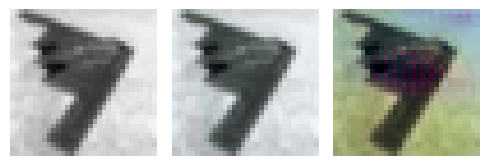

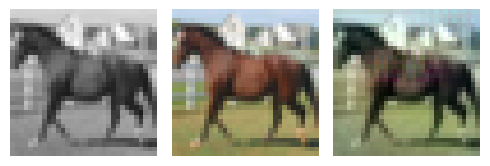

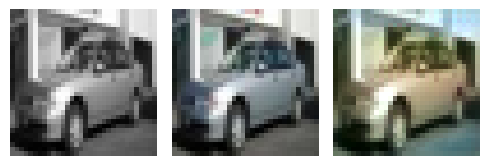

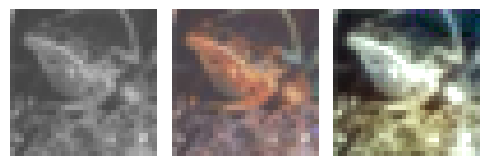

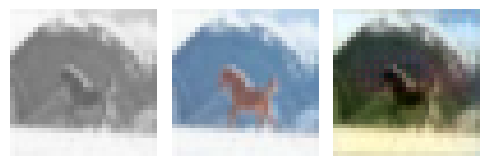

EPOCH: 15.950  val_loss: 0.005  (1778.24s - 9370.59s remaining)

EPOCH: 16.000  val_loss: 0.003  (1778.43s - 9336.77s remaining)

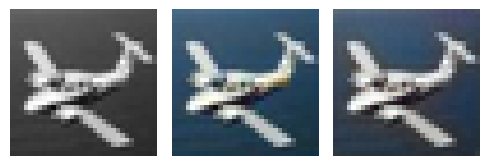

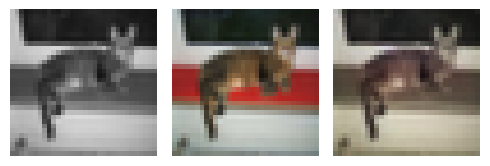

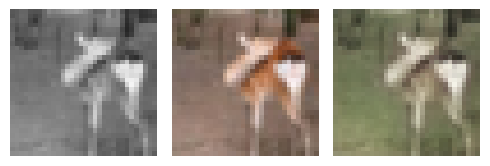

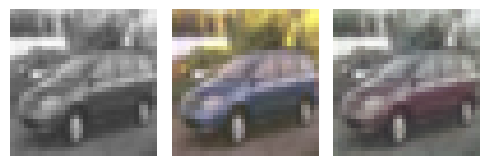

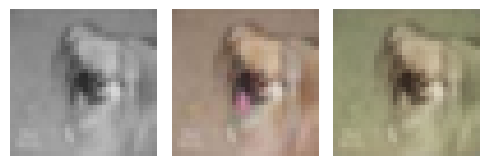

EPOCH: 16.250  trn_loss: 0.005  (1804.62s - 9300.76s remaining)

EPOCH: 16.255  trn_loss: 0.004  (1805.13s - 9299.89s remaining)

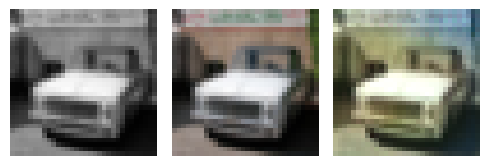

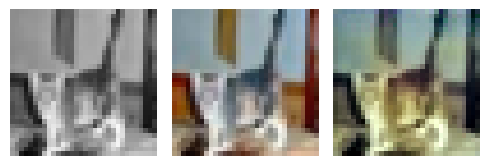

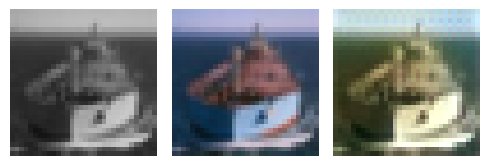

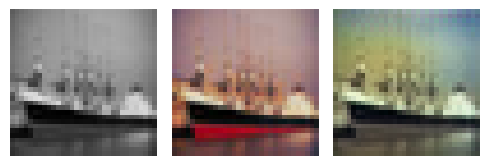

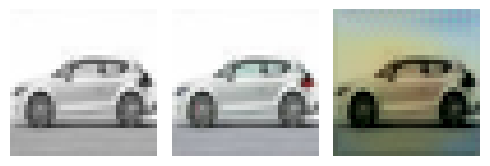

EPOCH: 16.505  trn_loss: 0.004  (1831.64s - 9265.76s remaining)

EPOCH: 16.510  trn_loss: 0.005  (1832.16s - 9264.98s remaining)

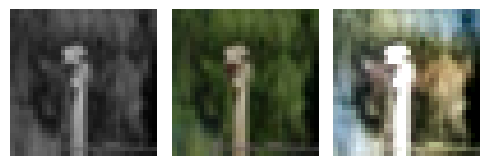

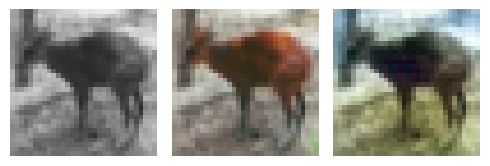

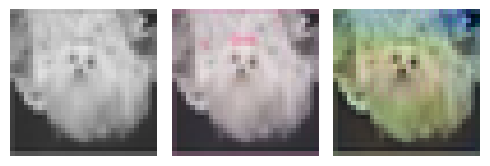

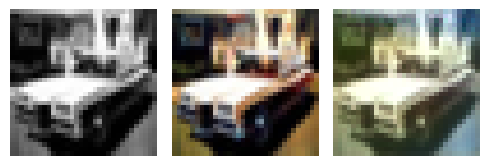

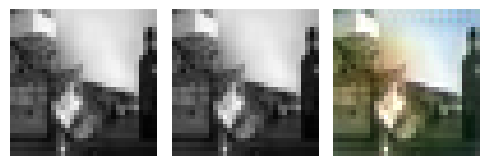

EPOCH: 16.760  trn_loss: 0.005  (1858.65s - 9231.01s remaining)

EPOCH: 16.765  trn_loss: 0.005  (1859.17s - 9230.20s remaining)

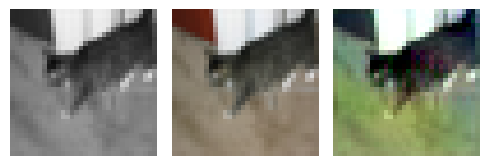

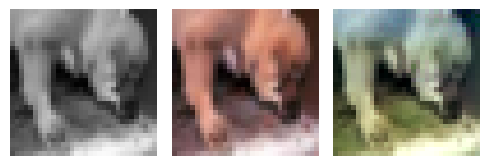

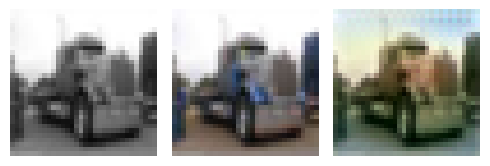

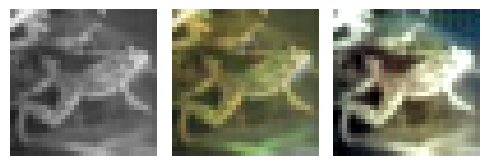

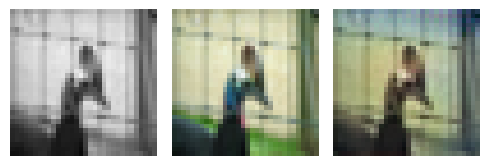

EPOCH: 17.000  val_loss: 0.003  (1891.27s - 9233.84s remaining)

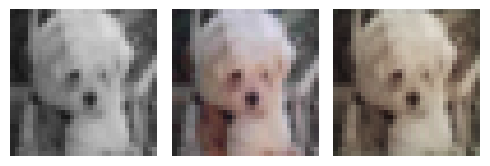

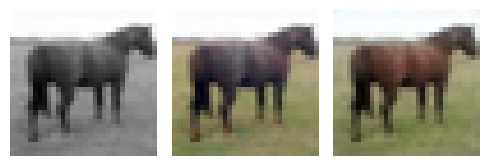

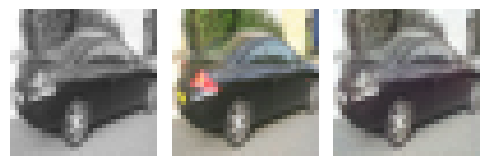

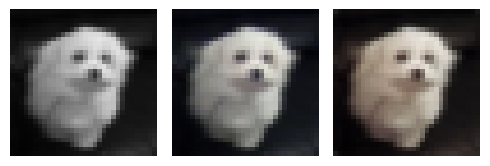

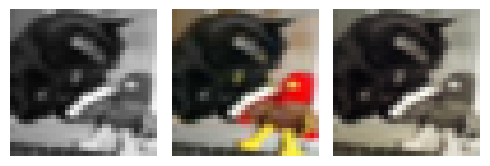

EPOCH: 17.250  trn_loss: 0.004  (1917.82s - 9199.99s remaining)

EPOCH: 17.255  trn_loss: 0.005  (1918.33s - 9199.12s remaining)

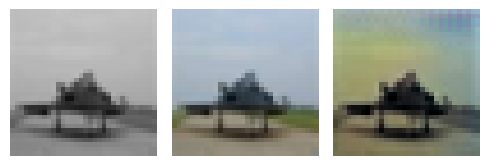

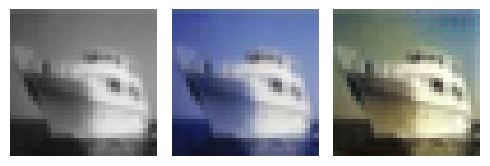

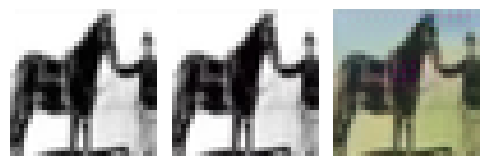

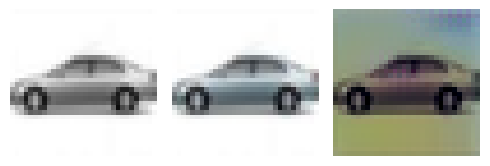

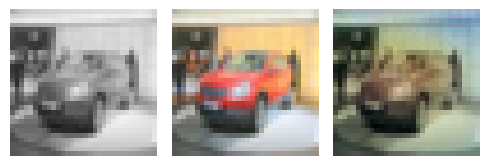

EPOCH: 17.510  trn_loss: 0.005  (1944.95s - 9162.58s remaining)

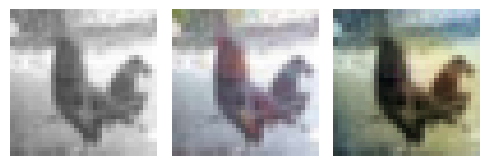

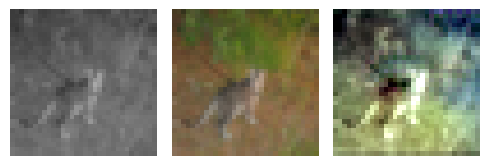

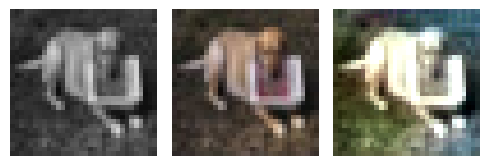

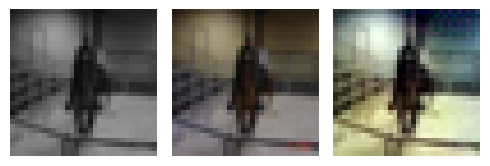

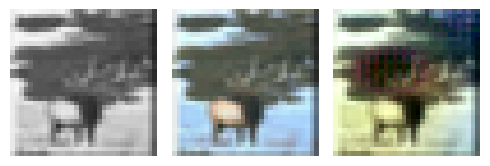

EPOCH: 17.755  trn_loss: 0.004  (1970.79s - 9129.04s remaining)

EPOCH: 17.765  trn_loss: 0.005  (1971.79s - 9127.32s remaining)

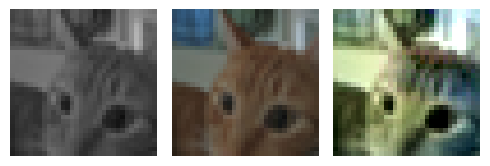

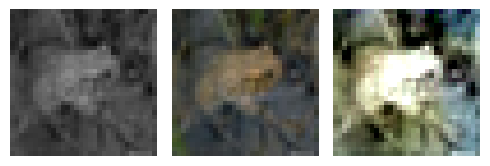

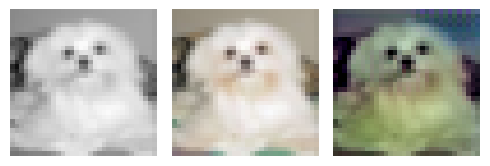

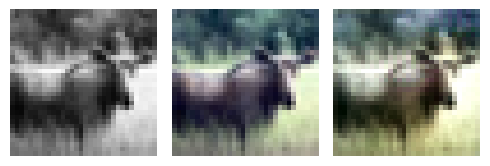

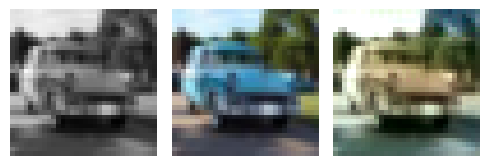

EPOCH: 17.950  val_loss: 0.005  (2003.47s - 9157.91s remaining)

EPOCH: 18.000  val_loss: 0.004  (2003.73s - 9128.12s remaining)

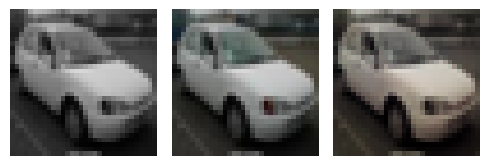

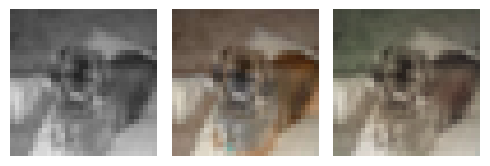

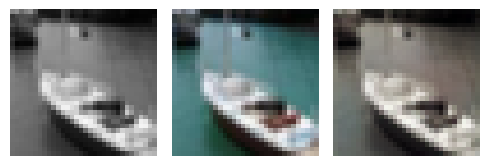

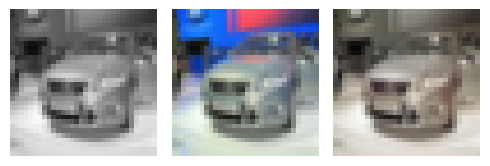

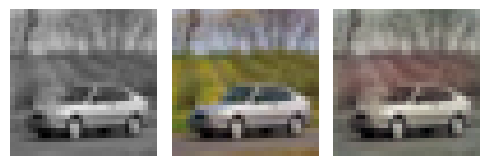

EPOCH: 18.250  trn_loss: 0.004  (2030.15s - 9093.94s remaining)

EPOCH: 18.255  trn_loss: 0.005  (2030.67s - 9093.19s remaining)

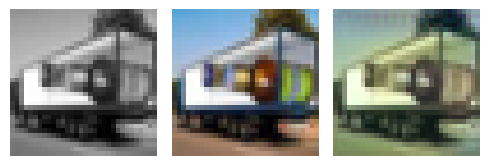

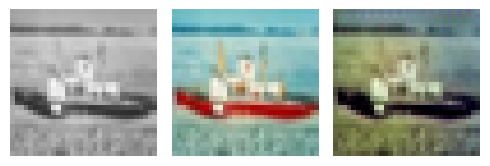

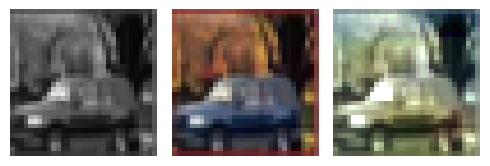

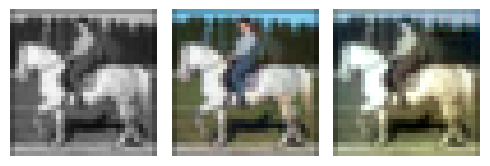

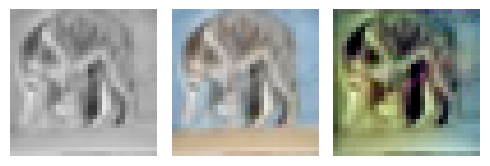

EPOCH: 18.505  trn_loss: 0.005  (2057.05s - 9059.07s remaining)

EPOCH: 18.510  trn_loss: 0.005  (2057.61s - 9058.48s remaining)

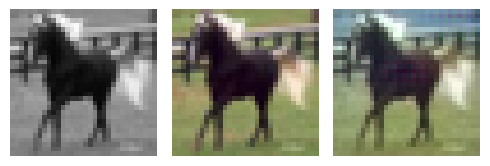

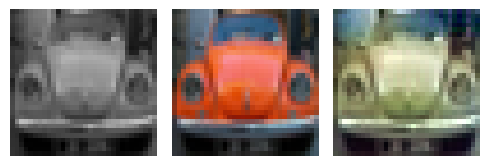

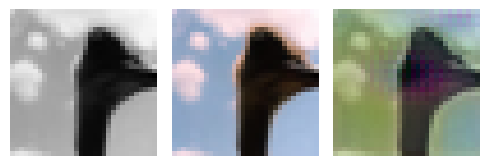

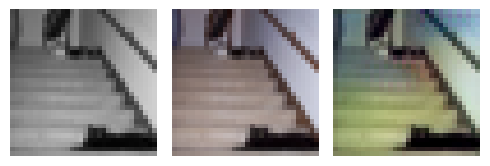

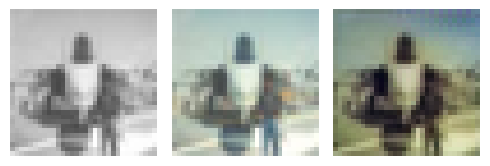

EPOCH: 18.760  trn_loss: 0.005  (2084.20s - 9025.50s remaining)

EPOCH: 18.765  trn_loss: 0.005  (2084.75s - 9024.85s remaining)

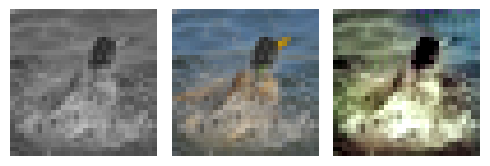

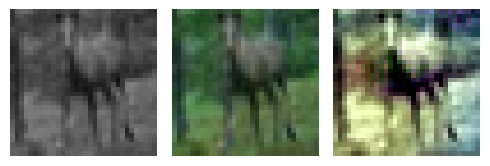

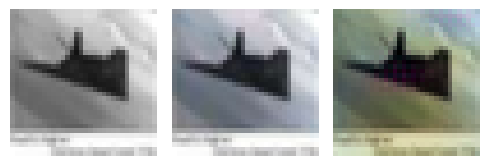

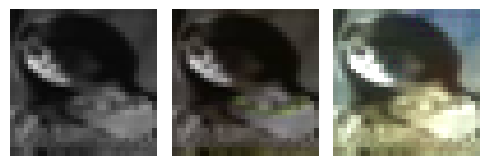

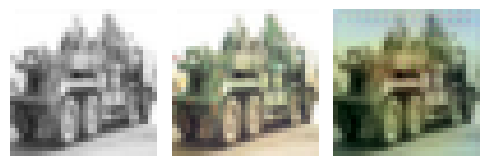

EPOCH: 18.950  val_loss: 0.005  (2116.71s - 9053.25s remaining)

EPOCH: 19.000  val_loss: 0.004  (2116.90s - 9024.67s remaining)

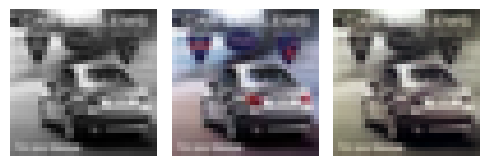

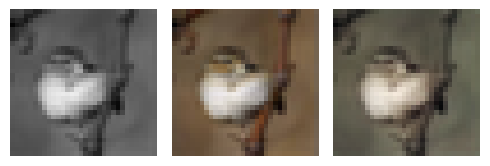

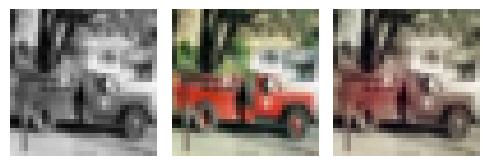

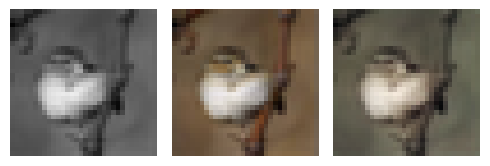

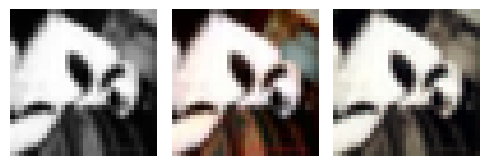

EPOCH: 19.245  trn_loss: 0.005  (2142.81s - 8991.63s remaining)

EPOCH: 19.255  trn_loss: 0.004  (2143.82s - 8989.95s remaining)

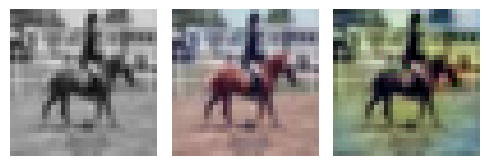

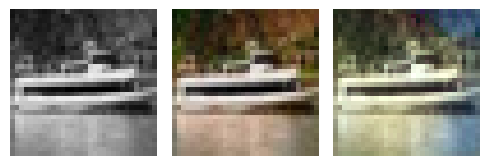

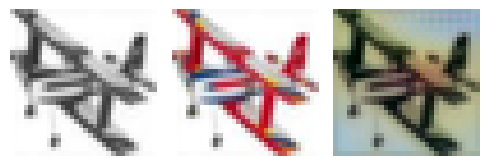

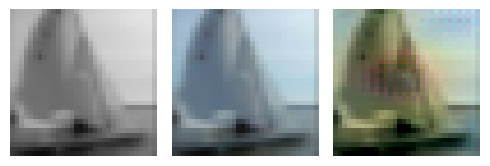

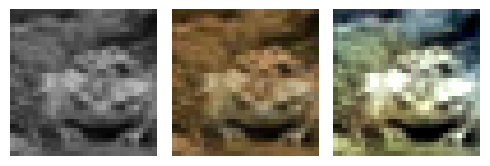

EPOCH: 19.505  trn_loss: 0.005  (2170.30s - 8956.51s remaining)

EPOCH: 19.510  trn_loss: 0.004  (2170.81s - 8955.72s remaining)

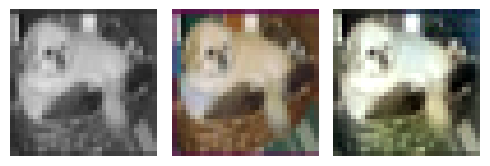

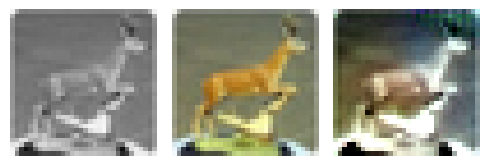

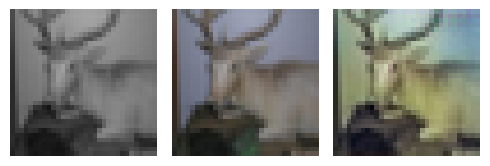

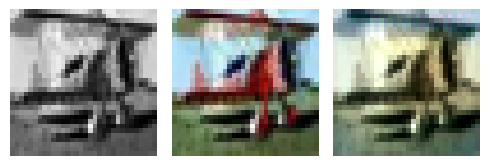

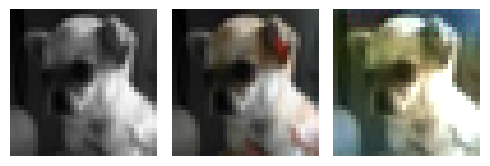

EPOCH: 19.760  trn_loss: 0.004  (2197.50s - 8923.33s remaining)

EPOCH: 19.765  trn_loss: 0.005  (2197.98s - 8922.42s remaining)

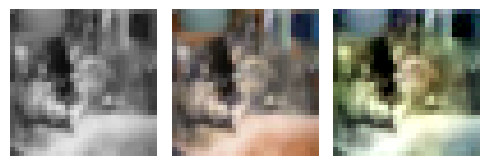

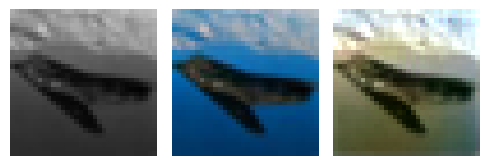

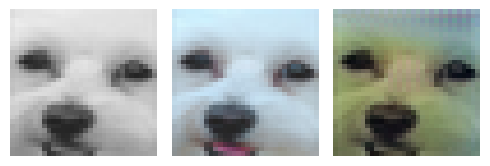

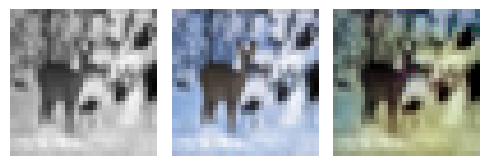

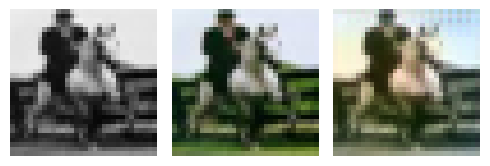

EPOCH: 20.000  trn_loss: 0.005  val_loss: 0.005  (2230.36s - 8921.46s remaining)


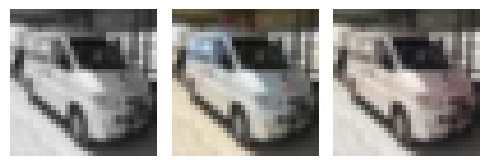

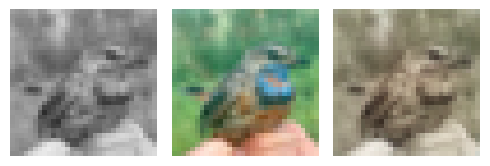

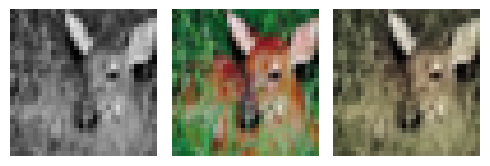

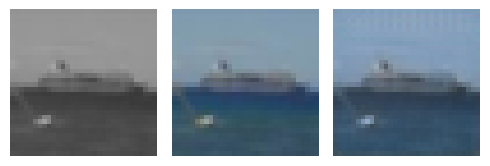

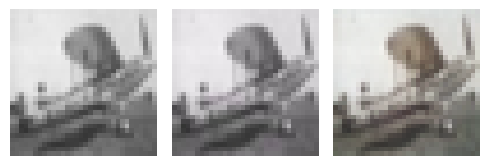

EPOCH: 20.250  trn_loss: 0.005  (2256.91s - 8888.32s remaining)

EPOCH: 20.255  trn_loss: 0.004  (2257.43s - 8887.56s remaining)

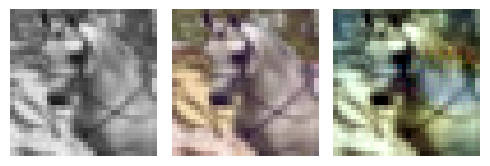

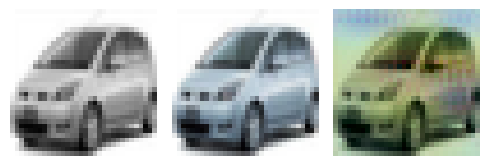

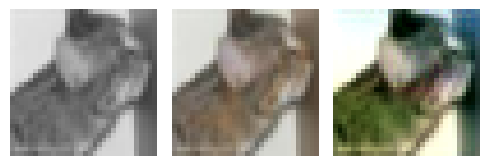

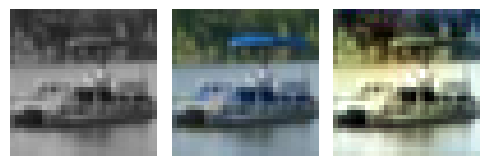

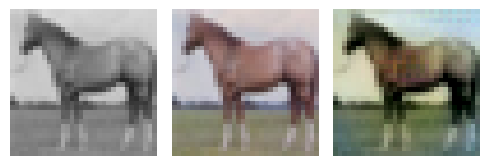

EPOCH: 20.505  trn_loss: 0.004  (2283.99s - 8854.66s remaining)

EPOCH: 20.510  trn_loss: 0.004  (2284.50s - 8853.87s remaining)

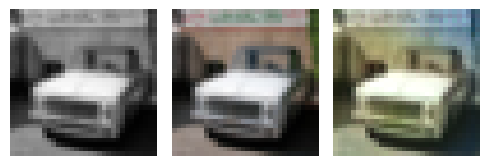

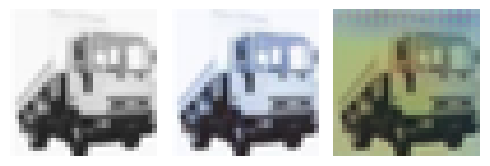

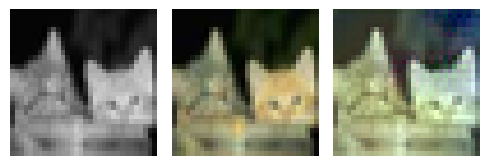

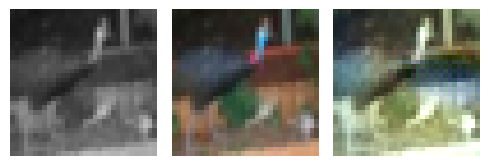

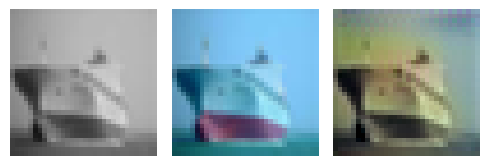

EPOCH: 20.760  trn_loss: 0.004  (2311.31s - 8822.07s remaining)

EPOCH: 20.765  trn_loss: 0.004  (2311.83s - 8821.31s remaining)

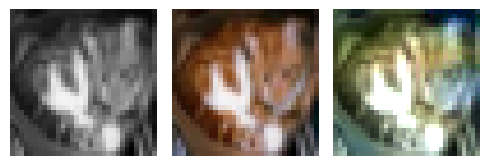

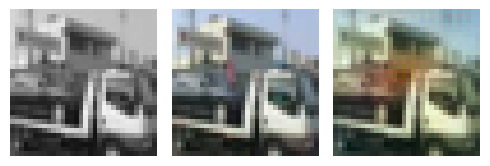

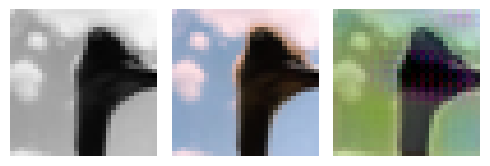

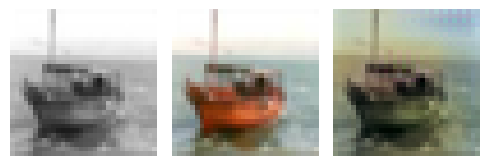

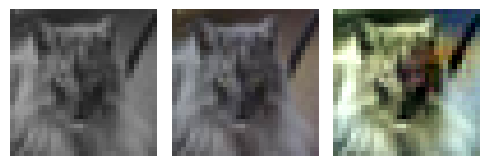

EPOCH: 21.000  val_loss: 0.003  (2343.53s - 8816.12s remaining)

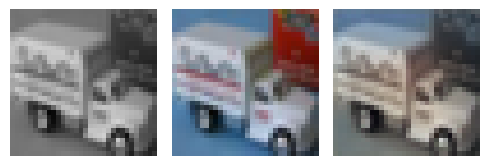

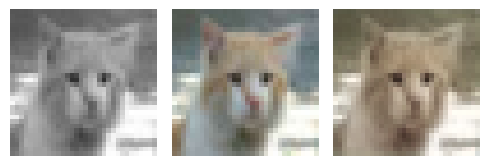

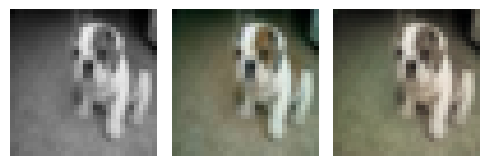

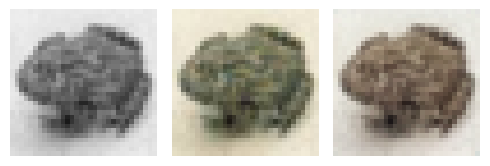

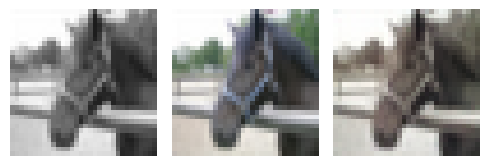

EPOCH: 21.250  trn_loss: 0.004  (2370.37s - 8784.33s remaining)

EPOCH: 21.255  trn_loss: 0.004  (2370.91s - 8783.63s remaining)

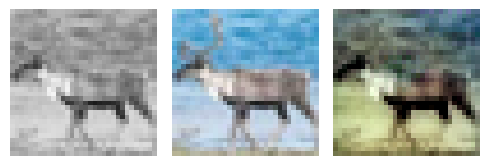

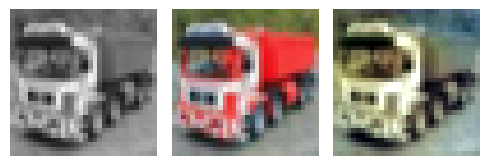

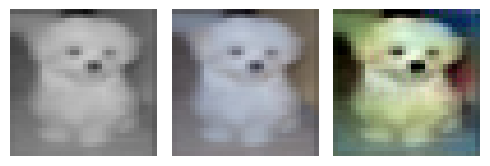

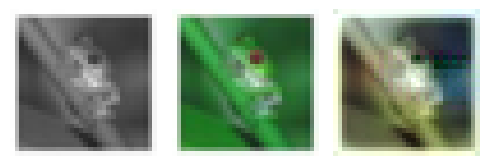

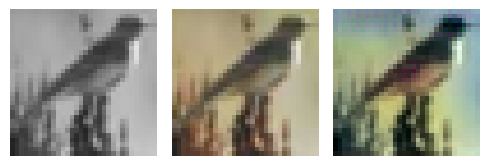

EPOCH: 21.505  trn_loss: 0.005  (2397.99s - 8752.79s remaining)

EPOCH: 21.510  trn_loss: 0.004  (2398.52s - 8752.11s remaining)

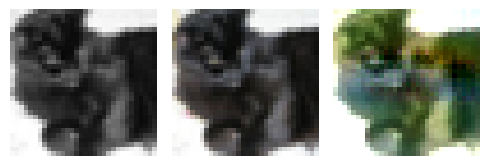

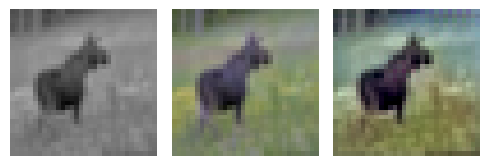

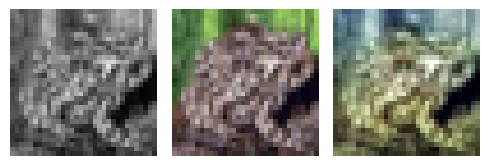

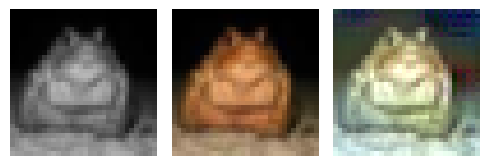

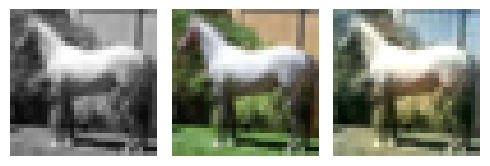

EPOCH: 21.760  trn_loss: 0.004  (2425.57s - 8721.25s remaining)

EPOCH: 21.765  trn_loss: 0.005  (2426.14s - 8720.68s remaining)

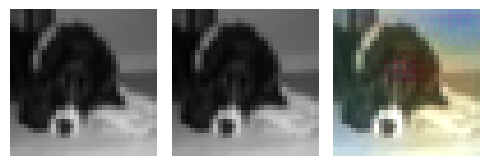

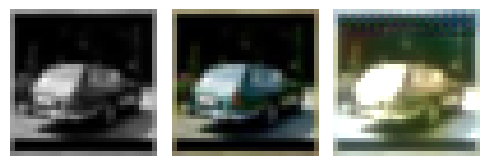

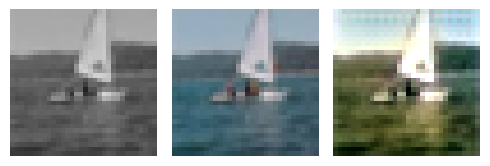

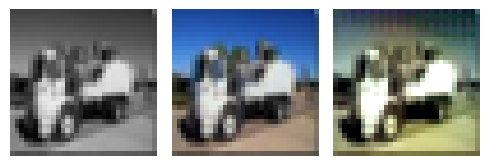

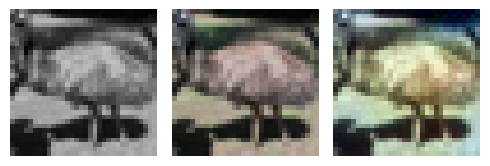

EPOCH: 21.950  val_loss: 0.005  (2458.63s - 8742.41s remaining)

EPOCH: 22.000  val_loss: 0.003  (2458.83s - 8717.67s remaining)

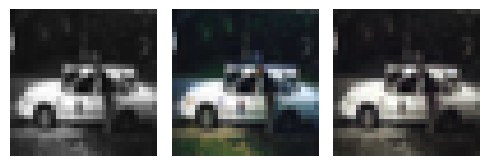

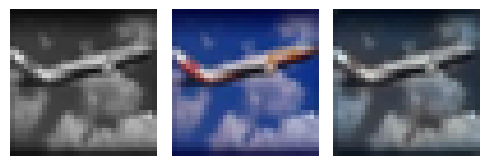

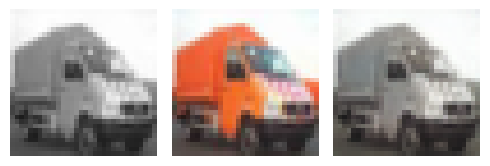

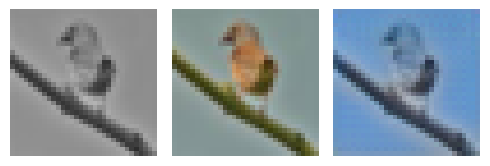

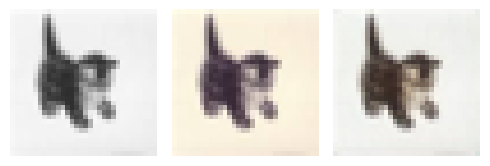

EPOCH: 22.245  trn_loss: 0.004  (2485.06s - 8686.31s remaining)

EPOCH: 22.255  trn_loss: 0.004  (2486.09s - 8684.78s remaining)

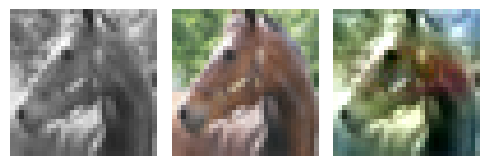

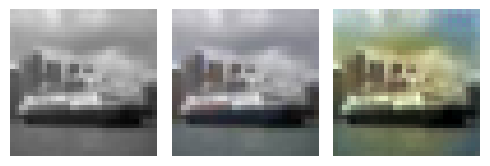

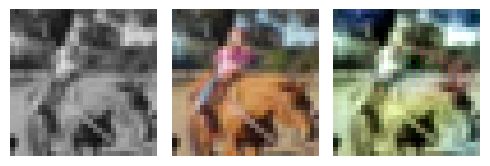

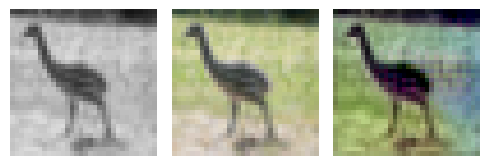

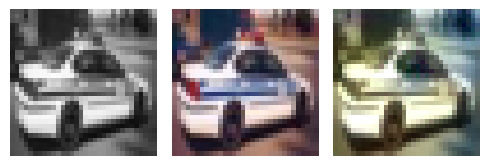

EPOCH: 22.505  trn_loss: 0.005  (2512.91s - 8653.06s remaining)

EPOCH: 22.510  trn_loss: 0.004  (2513.43s - 8652.32s remaining)

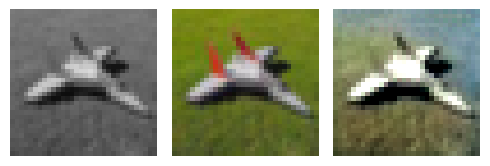

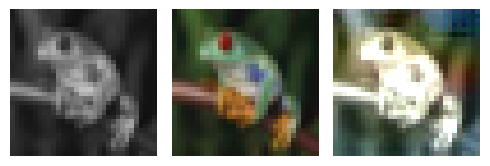

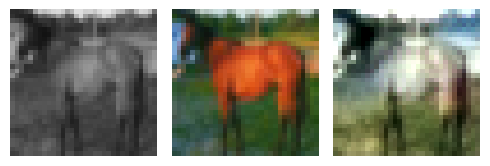

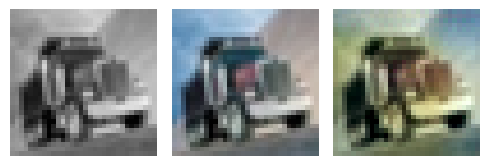

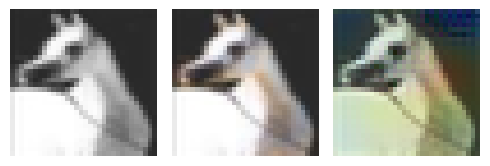

EPOCH: 22.760  trn_loss: 0.005  (2540.01s - 8619.87s remaining)

EPOCH: 22.765  trn_loss: 0.004  (2540.52s - 8619.11s remaining)

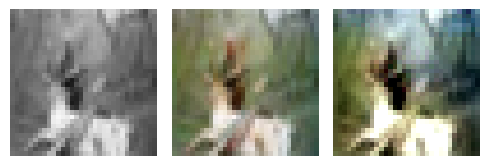

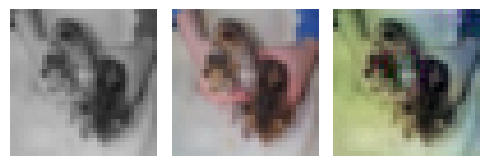

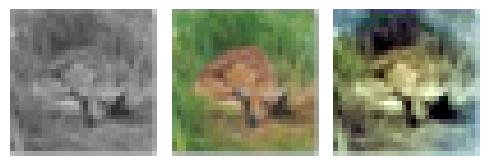

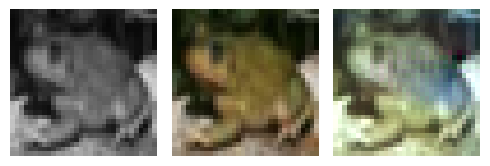

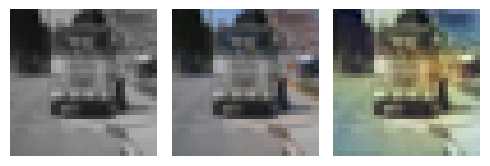

EPOCH: 23.000  val_loss: 0.003  (2572.77s - 8613.19s remaining)

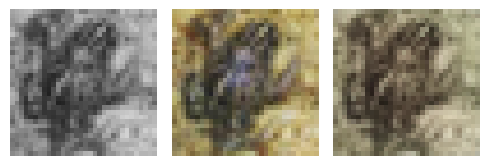

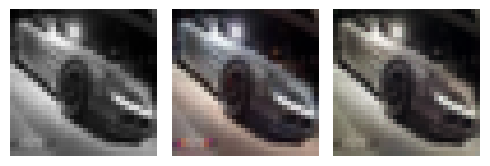

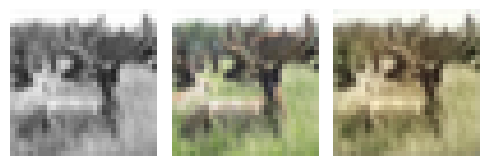

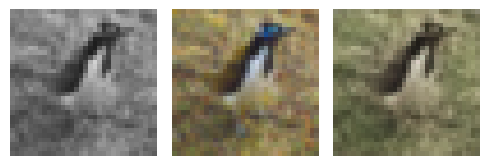

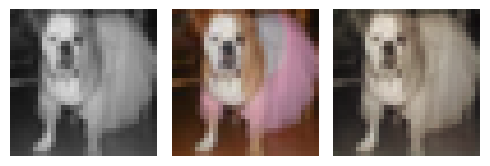

EPOCH: 23.250  trn_loss: 0.005  (2599.65s - 8581.62s remaining)

EPOCH: 23.255  trn_loss: 0.004  (2600.16s - 8580.87s remaining)

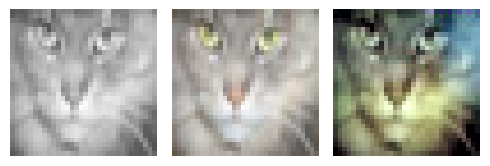

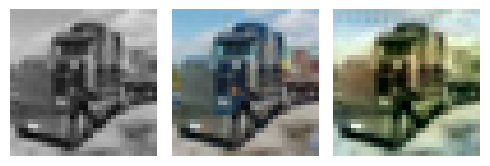

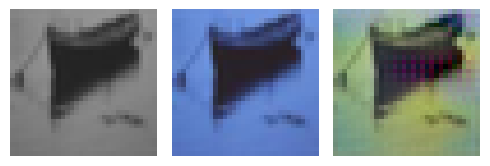

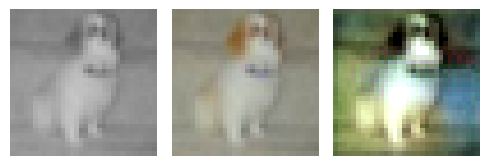

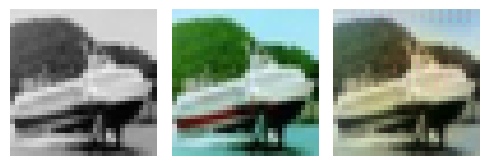

EPOCH: 23.505  trn_loss: 0.004  (2626.92s - 8549.04s remaining)

EPOCH: 23.510  trn_loss: 0.005  (2627.44s - 8548.30s remaining)

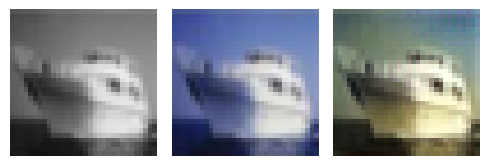

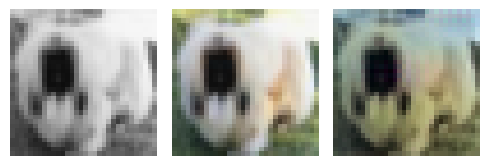

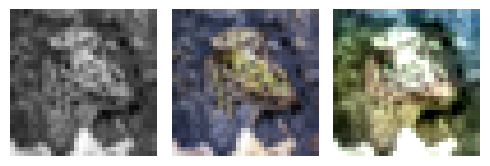

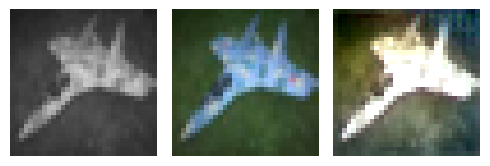

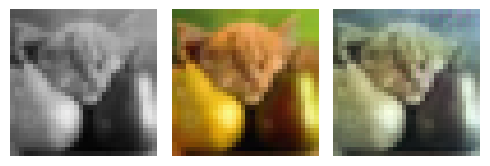

EPOCH: 23.760  trn_loss: 0.004  (2654.12s - 8516.31s remaining)

EPOCH: 23.765  trn_loss: 0.004  (2654.64s - 8515.60s remaining)

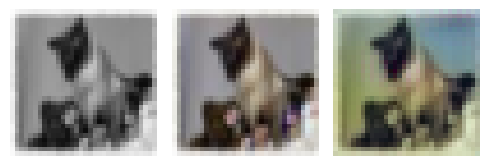

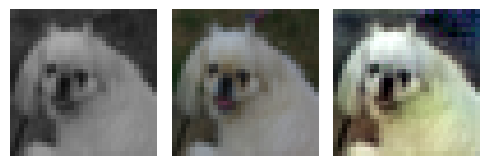

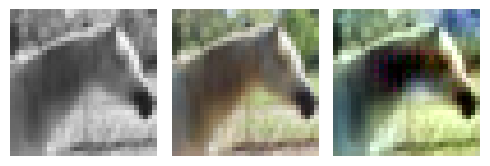

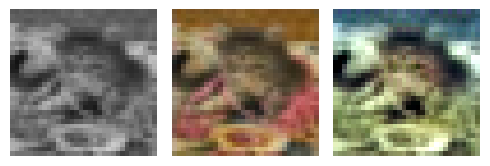

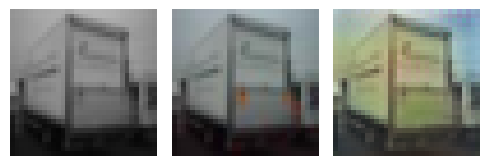

EPOCH: 24.000  val_loss: 0.003  (2686.49s - 8507.23s remaining)

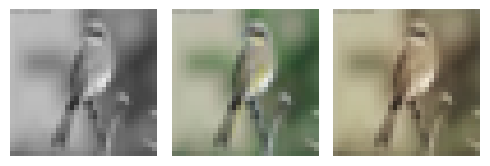

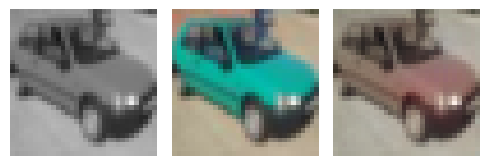

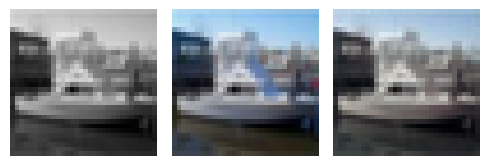

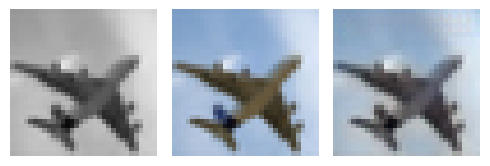

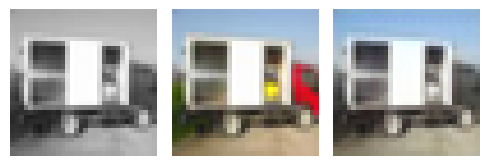

EPOCH: 24.250  trn_loss: 0.004  (2712.90s - 8474.31s remaining)

EPOCH: 24.255  trn_loss: 0.004  (2713.42s - 8473.59s remaining)

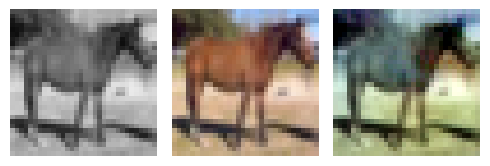

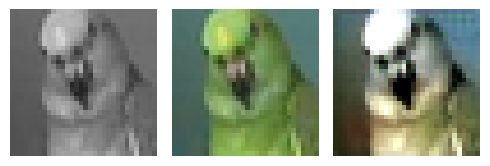

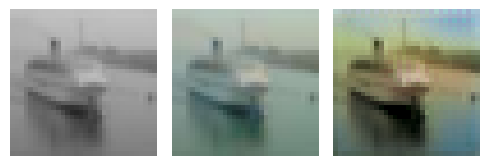

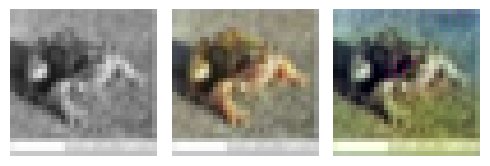

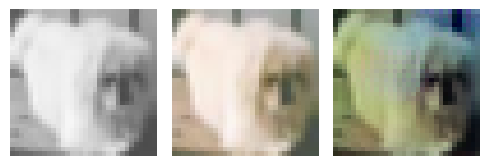

EPOCH: 24.505  trn_loss: 0.004  (2740.44s - 8442.71s remaining)

EPOCH: 24.510  trn_loss: 0.004  (2740.96s - 8441.98s remaining)

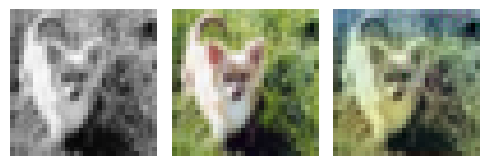

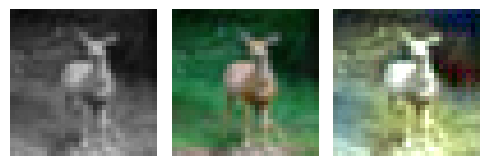

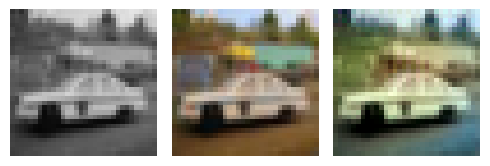

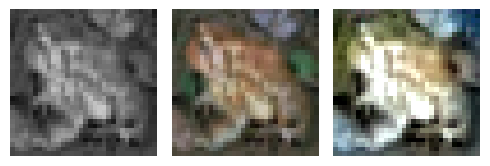

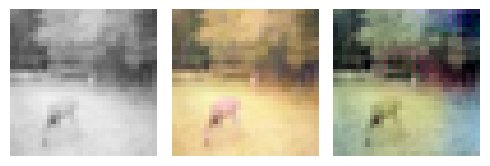

EPOCH: 24.760  trn_loss: 0.004  (2767.75s - 8410.47s remaining)

EPOCH: 24.765  trn_loss: 0.004  (2768.28s - 8409.79s remaining)

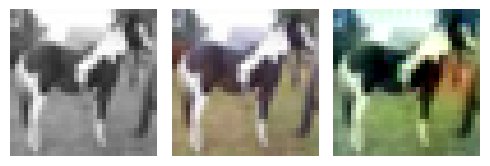

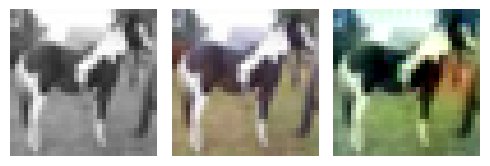

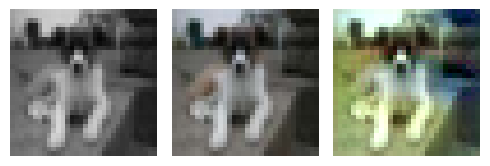

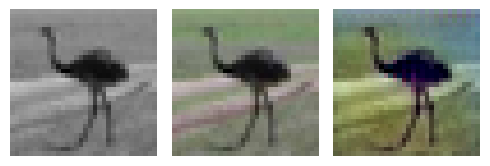

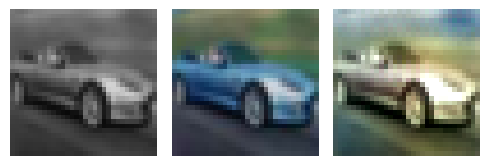

EPOCH: 25.000  trn_loss: 0.004  val_loss: 0.005  (2801.44s - 8404.33s remaining)


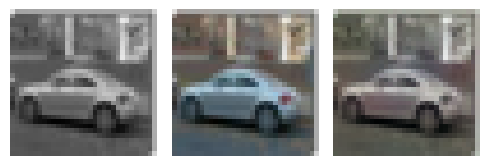

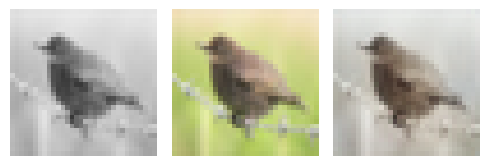

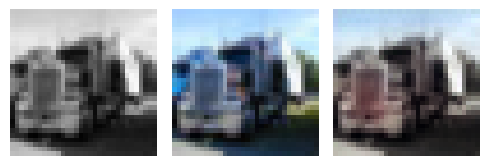

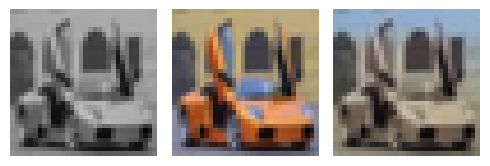

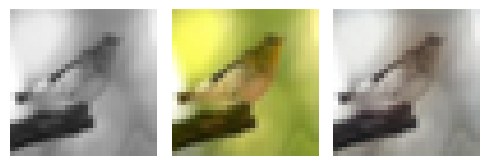

EPOCH: 25.250  trn_loss: 0.005  (2828.16s - 8372.47s remaining)

EPOCH: 25.255  trn_loss: 0.004  (2828.68s - 8371.75s remaining)

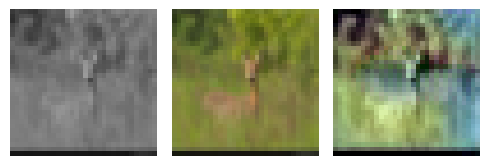

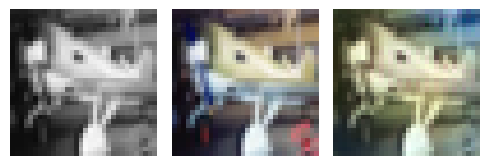

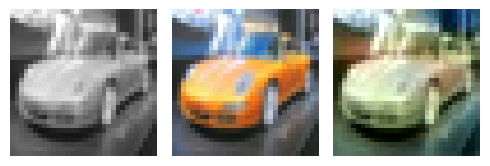

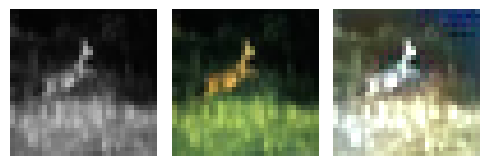

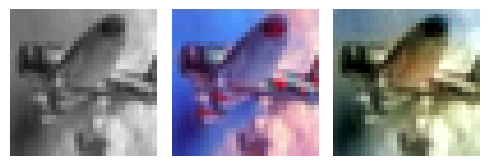

EPOCH: 25.505  trn_loss: 0.004  (2855.53s - 8340.40s remaining)

EPOCH: 25.510  trn_loss: 0.005  (2856.05s - 8339.67s remaining)

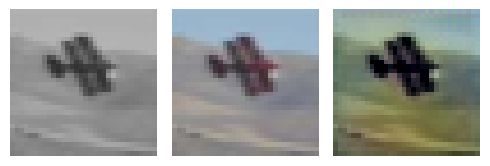

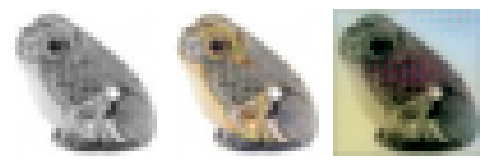

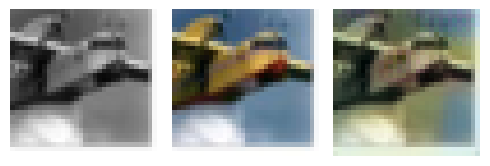

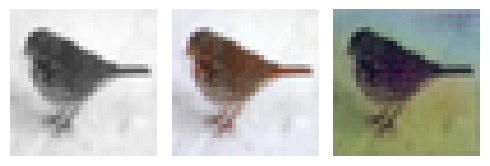

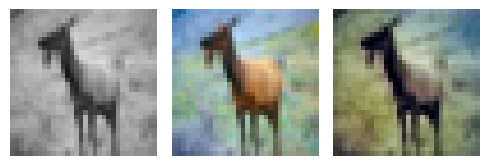

EPOCH: 25.760  trn_loss: 0.004  (2883.24s - 8309.38s remaining)

EPOCH: 25.765  trn_loss: 0.004  (2883.76s - 8308.65s remaining)

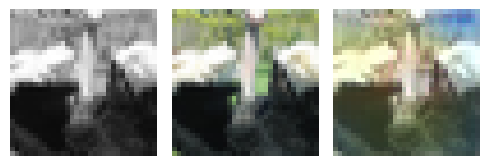

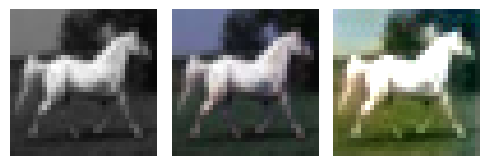

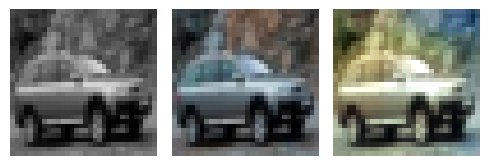

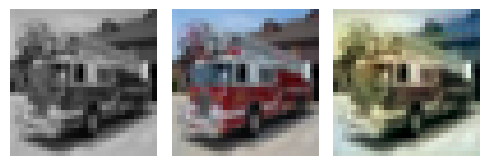

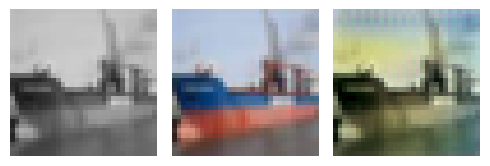

EPOCH: 25.950  val_loss: 0.005  (2915.73s - 8320.21s remaining)

EPOCH: 26.000  val_loss: 0.003  (2915.96s - 8299.27s remaining)

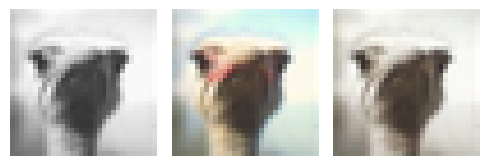

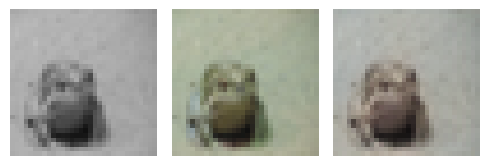

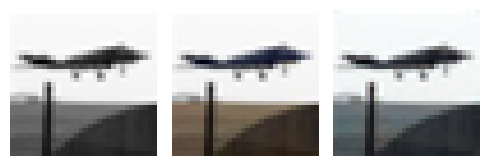

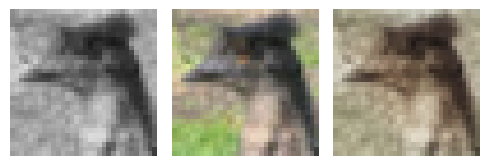

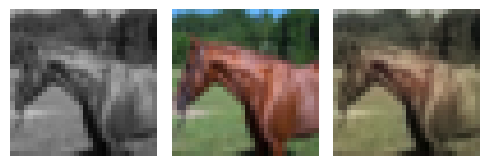

EPOCH: 26.250  trn_loss: 0.004  (2942.93s - 8268.23s remaining)

EPOCH: 26.255  trn_loss: 0.004  (2943.45s - 8267.52s remaining)

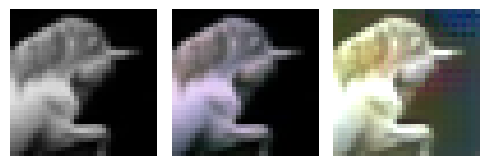

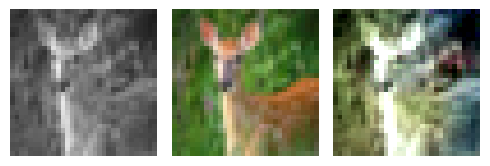

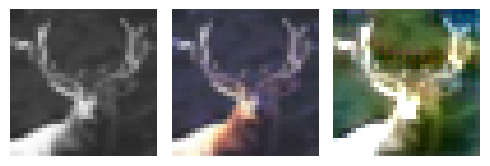

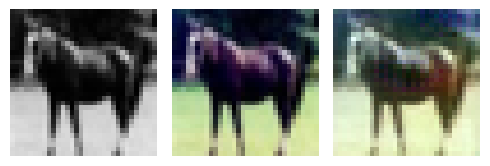

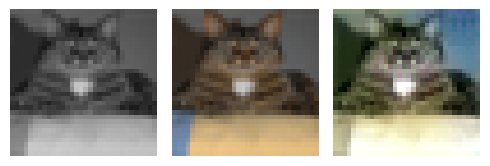

EPOCH: 26.510  trn_loss: 0.005  (2970.98s - 8235.96s remaining)

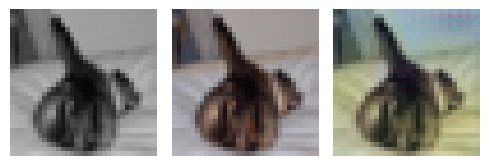

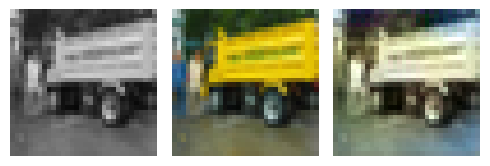

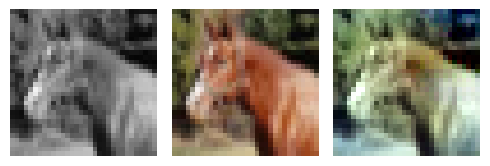

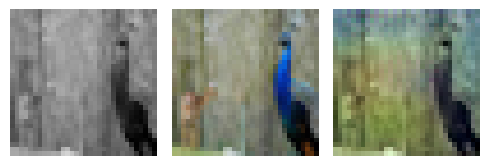

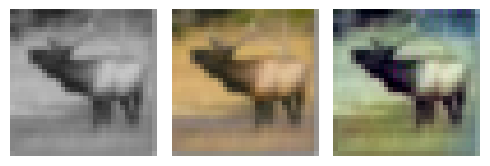

EPOCH: 26.760  trn_loss: 0.004  (2998.03s - 8205.30s remaining)

EPOCH: 26.765  trn_loss: 0.005  (2998.60s - 8204.70s remaining)

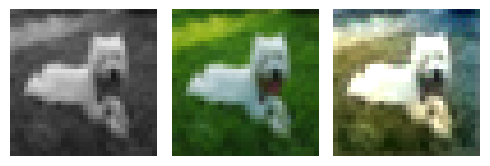

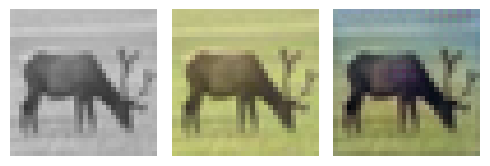

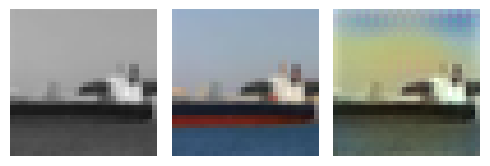

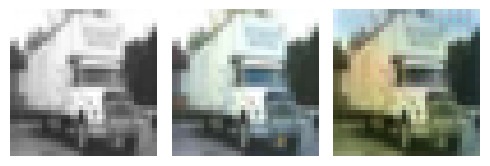

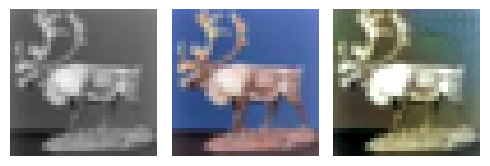

EPOCH: 27.000  val_loss: 0.003  (3031.58s - 8196.51s remaining)

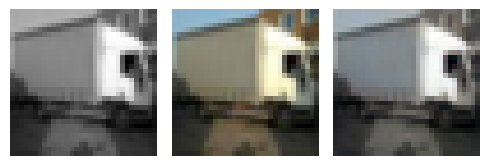

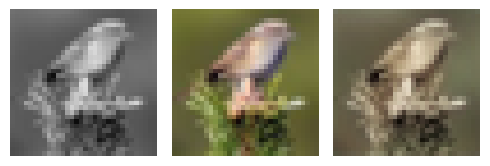

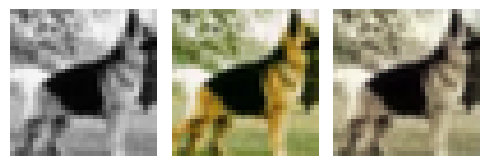

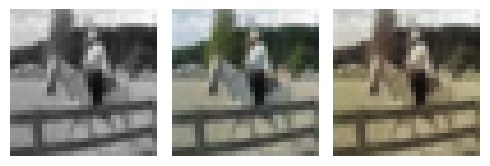

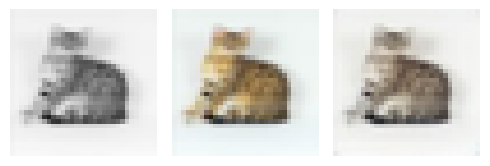

EPOCH: 27.250  trn_loss: 0.004  (3058.40s - 8165.08s remaining)

EPOCH: 27.255  trn_loss: 0.005  (3058.92s - 8164.36s remaining)

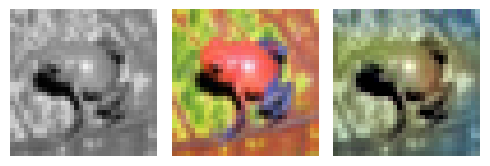

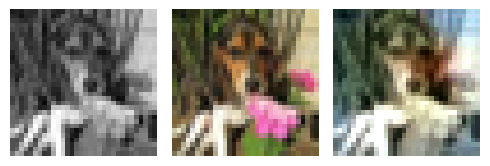

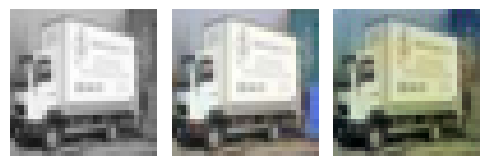

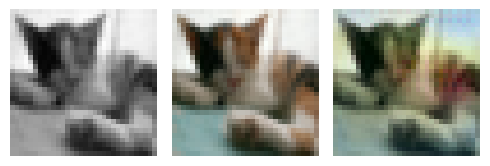

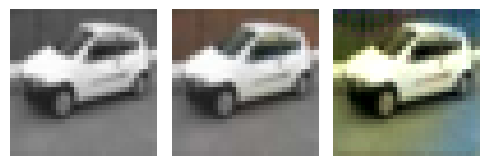

EPOCH: 27.510  trn_loss: 0.004  (3086.48s - 8132.92s remaining)

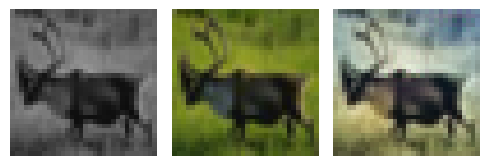

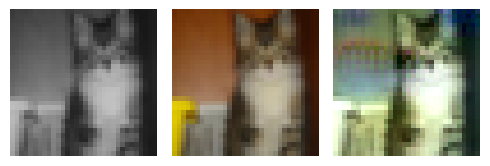

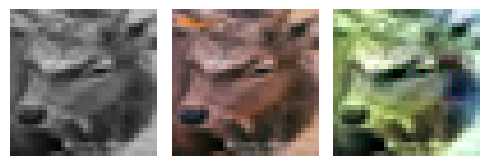

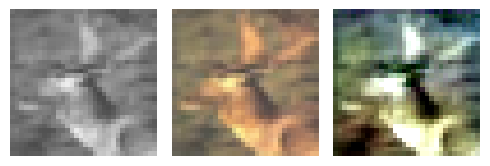

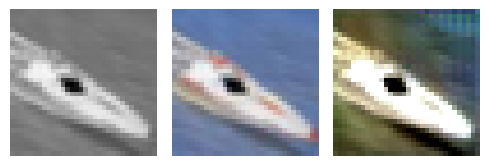

EPOCH: 27.755  trn_loss: 0.004  (3112.68s - 8102.13s remaining)

EPOCH: 27.765  trn_loss: 0.005  (3113.73s - 8100.73s remaining)

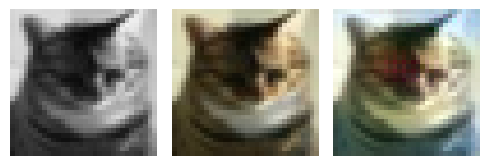

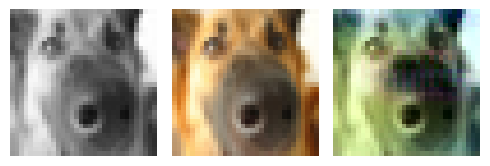

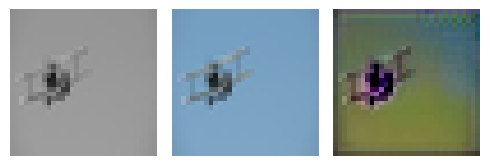

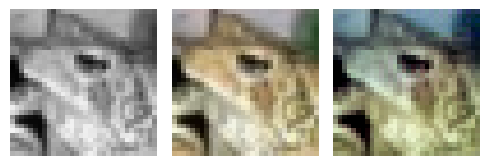

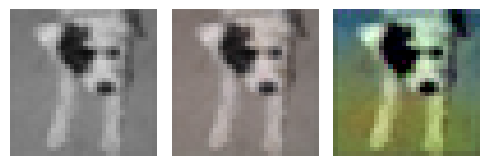

EPOCH: 28.000  val_loss: 0.003  (3146.49s - 8090.96s remaining)

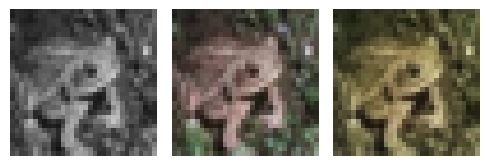

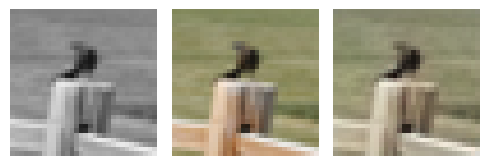

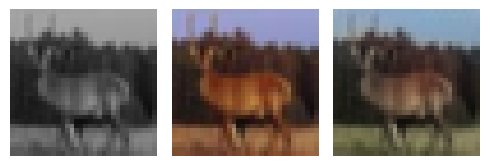

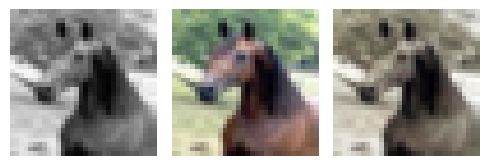

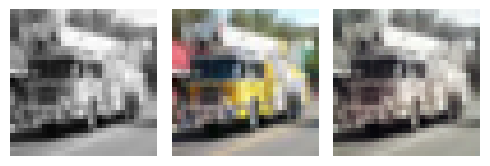

EPOCH: 28.250  trn_loss: 0.004  (3173.46s - 8060.03s remaining)

EPOCH: 28.255  trn_loss: 0.004  (3174.00s - 8059.36s remaining)

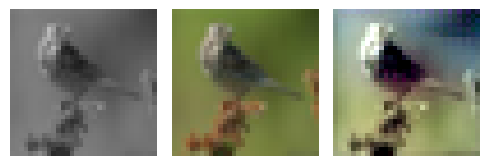

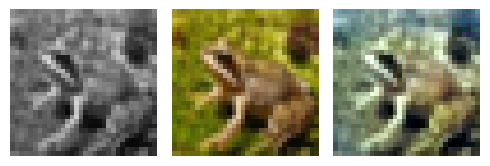

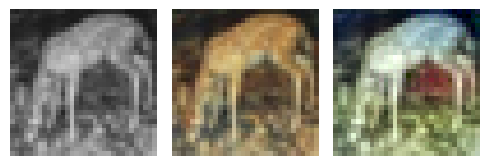

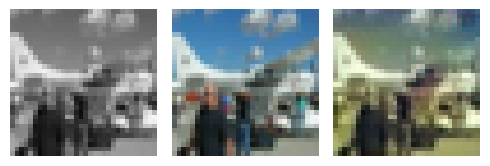

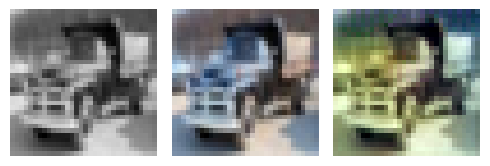

EPOCH: 28.505  trn_loss: 0.005  (3201.21s - 8029.09s remaining)

EPOCH: 28.510  trn_loss: 0.005  (3201.74s - 8028.41s remaining)

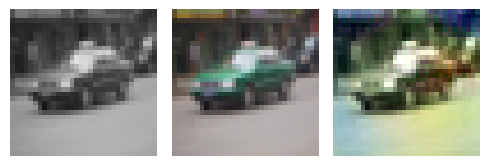

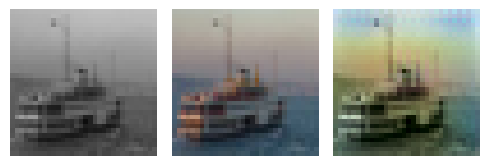

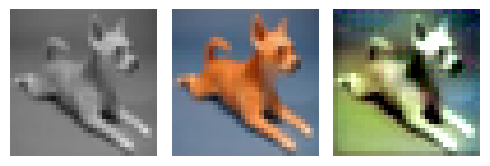

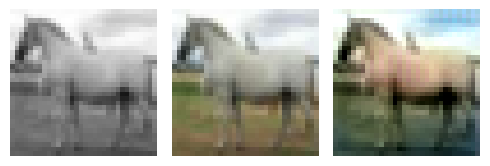

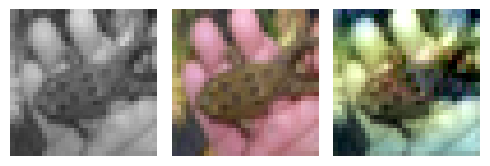

EPOCH: 28.760  trn_loss: 0.004  (3228.51s - 7997.11s remaining)

EPOCH: 28.765  trn_loss: 0.004  (3229.03s - 7996.41s remaining)

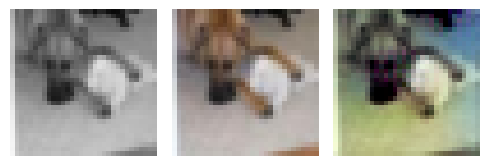

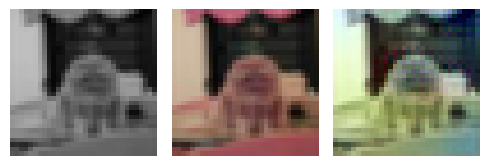

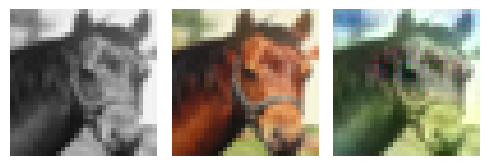

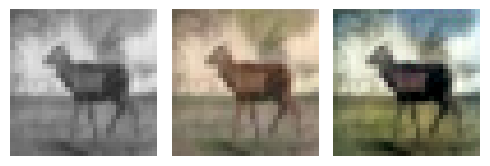

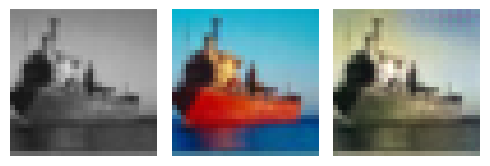

EPOCH: 29.000  val_loss: 0.003  (3260.70s - 7983.10s remaining)

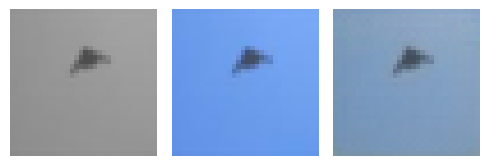

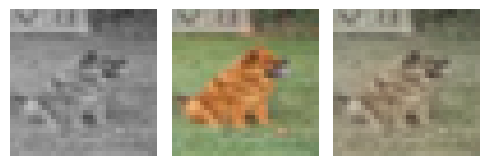

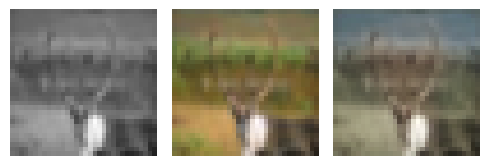

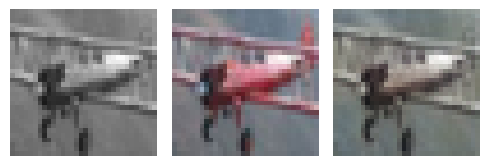

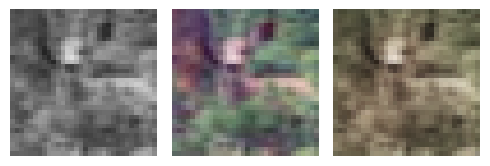

EPOCH: 29.250  trn_loss: 0.004  (3287.66s - 7952.20s remaining)

EPOCH: 29.255  trn_loss: 0.004  (3288.17s - 7951.49s remaining)

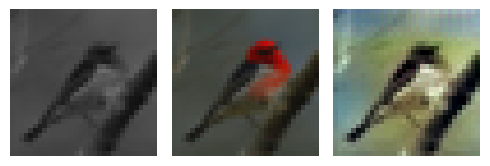

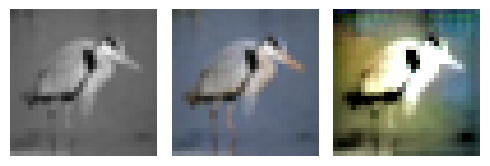

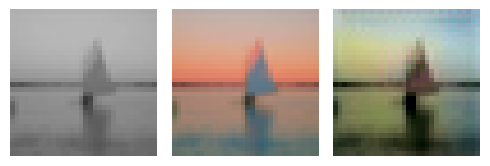

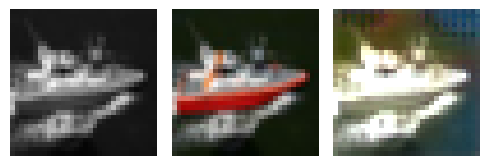

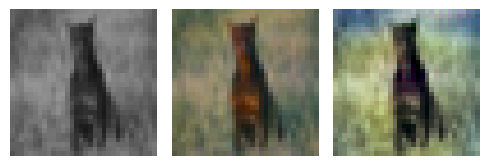

EPOCH: 29.505  trn_loss: 0.004  (3315.22s - 7920.88s remaining)

EPOCH: 29.510  trn_loss: 0.004  (3315.74s - 7920.18s remaining)

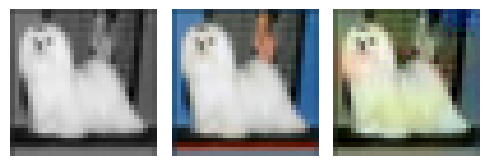

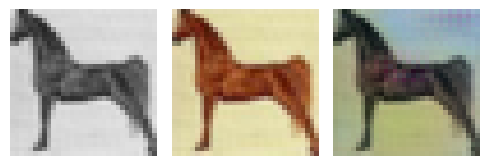

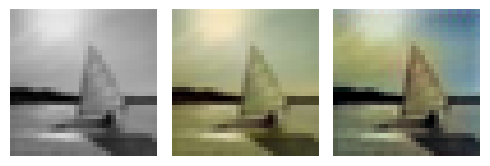

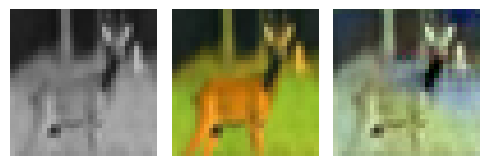

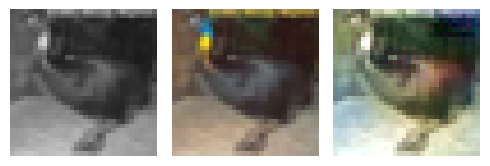

EPOCH: 29.760  trn_loss: 0.004  (3342.61s - 7889.21s remaining)

EPOCH: 29.765  trn_loss: 0.005  (3343.14s - 7888.53s remaining)

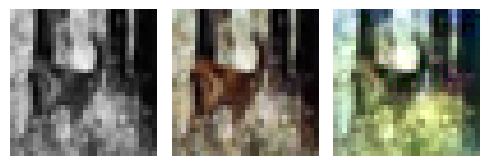

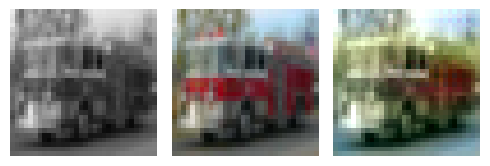

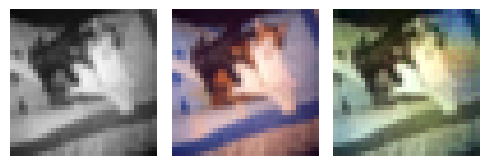

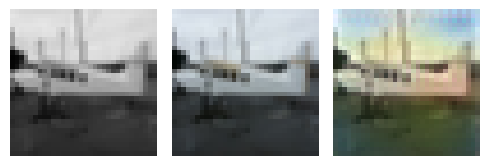

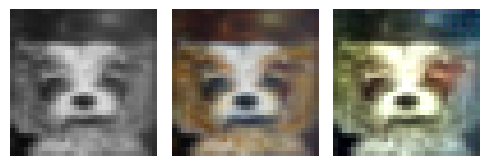

EPOCH: 30.000  trn_loss: 0.004  val_loss: 0.005  (3375.89s - 7877.08s remaining)


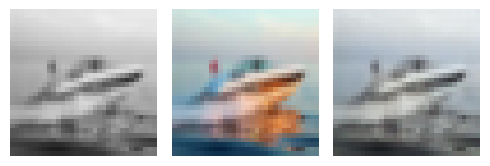

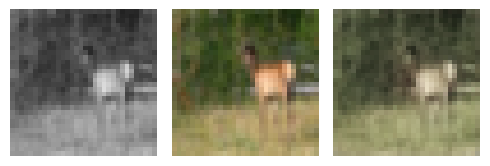

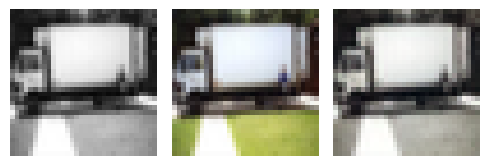

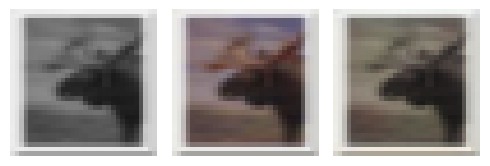

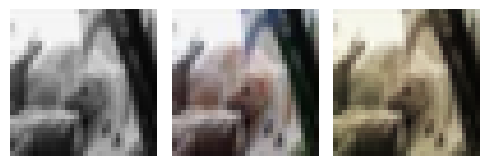

EPOCH: 30.250  trn_loss: 0.004  (3403.18s - 7847.00s remaining)

EPOCH: 30.255  trn_loss: 0.004  (3403.70s - 7846.30s remaining)

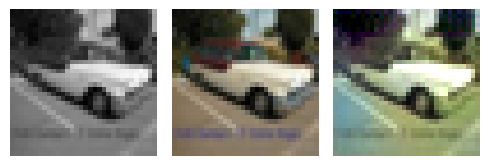

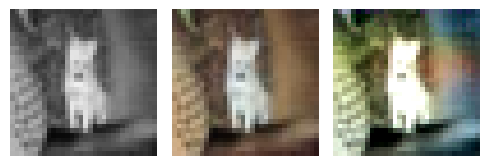

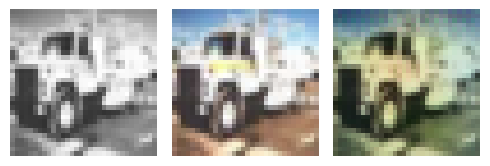

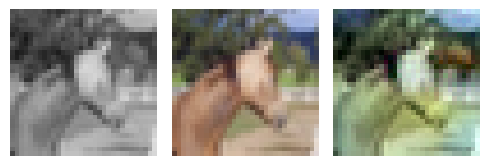

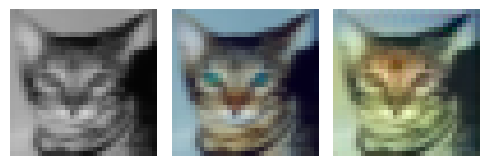

EPOCH: 30.505  trn_loss: 0.004  (3430.61s - 7815.41s remaining)

EPOCH: 30.510  trn_loss: 0.004  (3431.14s - 7814.73s remaining)

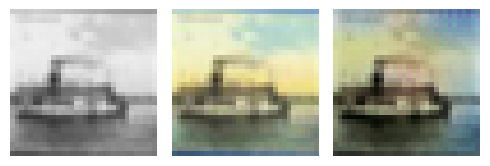

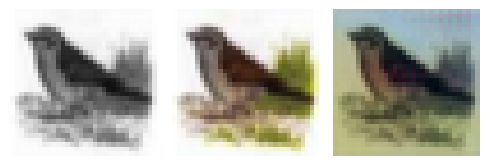

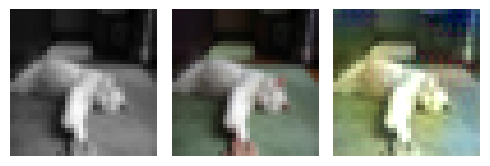

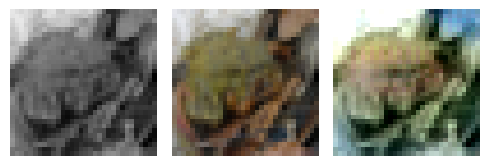

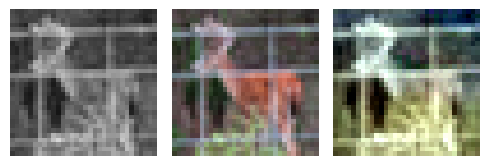

EPOCH: 30.760  trn_loss: 0.004  (3458.14s - 7784.11s remaining)

EPOCH: 30.765  trn_loss: 0.004  (3458.67s - 7783.44s remaining)

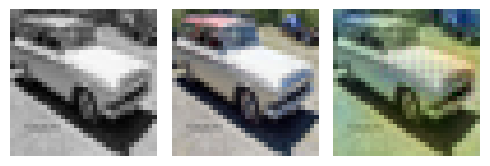

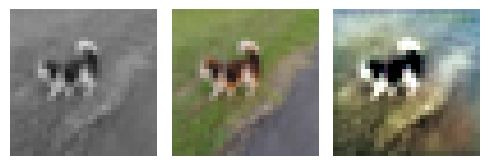

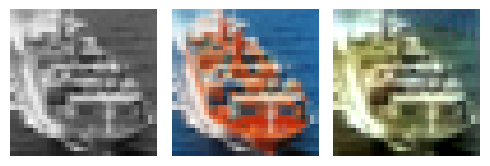

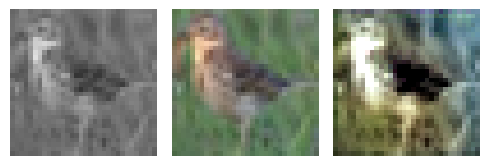

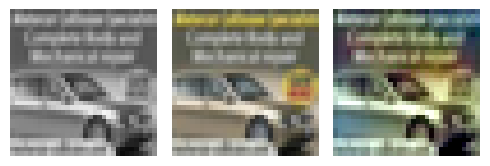

EPOCH: 31.000  val_loss: 0.003  (3490.77s - 7769.77s remaining)

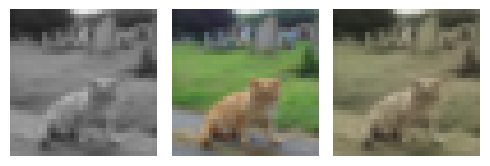

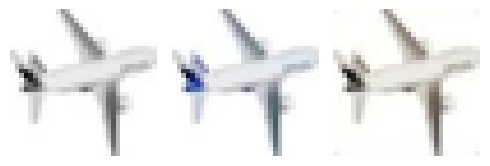

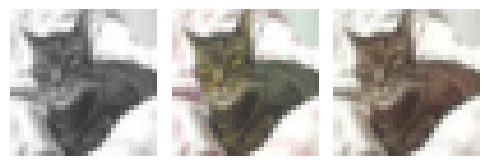

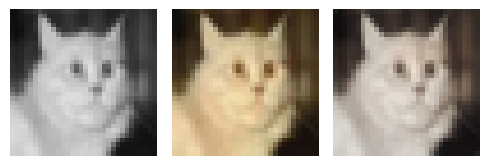

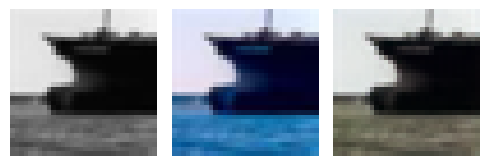

EPOCH: 31.250  trn_loss: 0.004  (3517.67s - 7738.87s remaining)

EPOCH: 31.255  trn_loss: 0.004  (3518.19s - 7738.19s remaining)

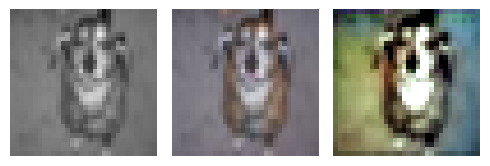

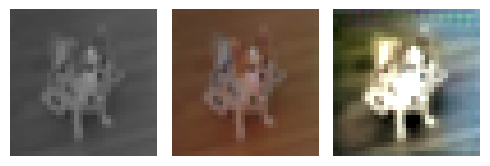

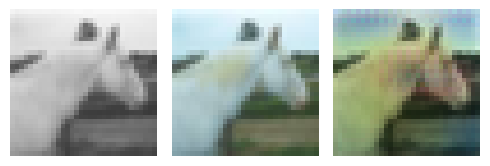

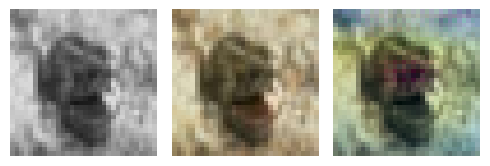

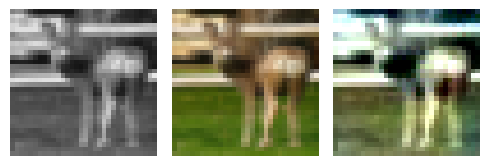

EPOCH: 31.505  trn_loss: 0.004  (3545.20s - 7707.58s remaining)

EPOCH: 31.510  trn_loss: 0.004  (3545.73s - 7706.91s remaining)

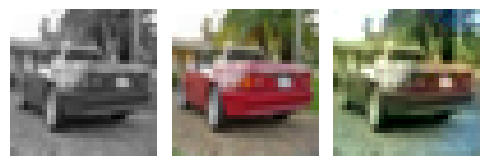

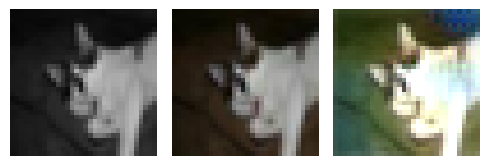

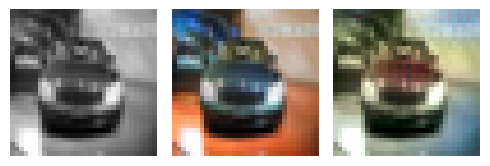

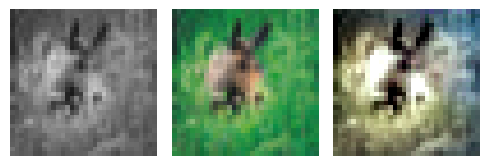

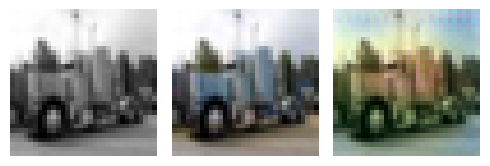

EPOCH: 31.760  trn_loss: 0.004  (3572.42s - 7675.68s remaining)

EPOCH: 31.765  trn_loss: 0.005  (3572.94s - 7675.00s remaining)

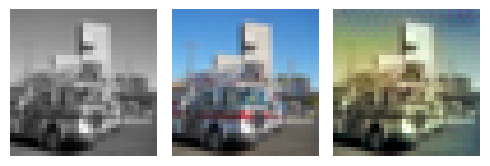

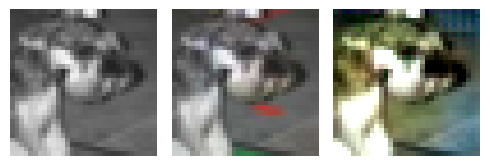

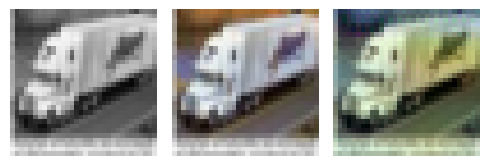

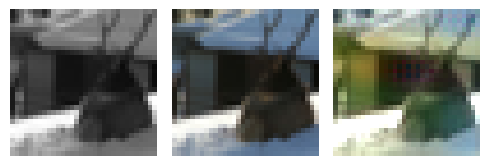

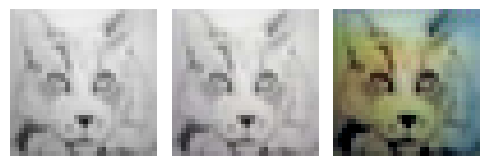

EPOCH: 31.950  val_loss: 0.005  (3606.07s - 7680.54s remaining)

EPOCH: 32.000  val_loss: 0.003  (3606.31s - 7663.42s remaining)

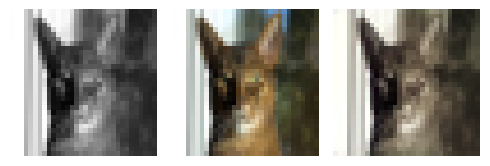

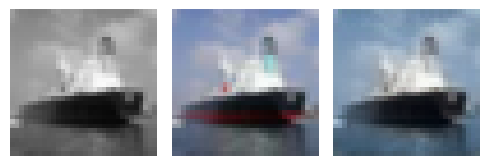

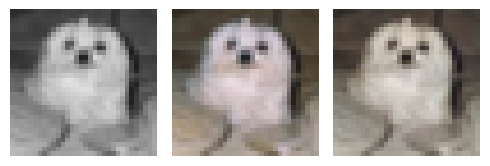

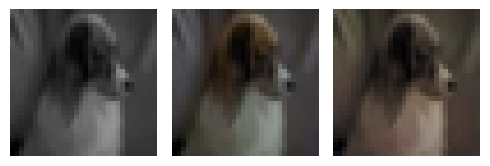

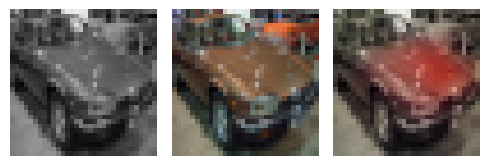

EPOCH: 32.250  trn_loss: 0.004  (3633.26s - 7632.67s remaining)

EPOCH: 32.255  trn_loss: 0.004  (3633.78s - 7631.97s remaining)

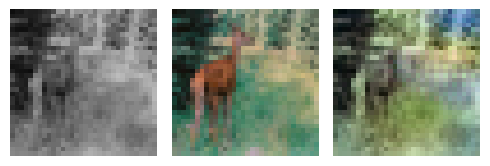

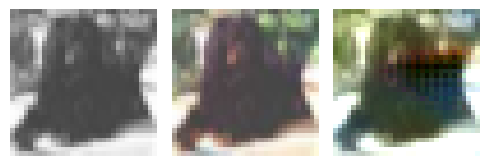

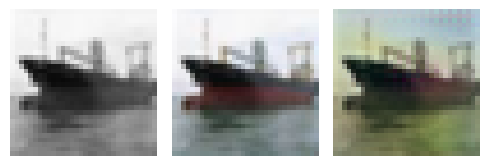

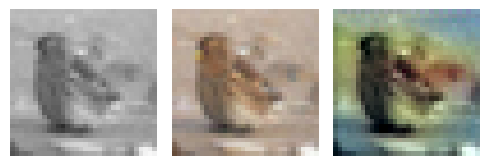

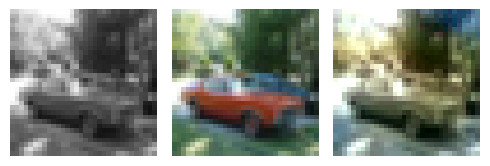

EPOCH: 32.505  trn_loss: 0.005  (3660.52s - 7600.85s remaining)

EPOCH: 32.510  trn_loss: 0.004  (3661.05s - 7600.19s remaining)

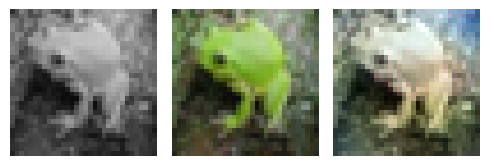

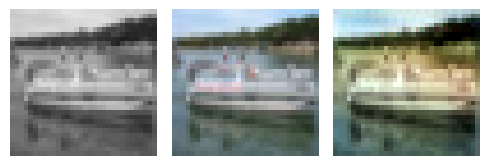

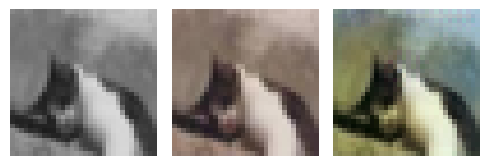

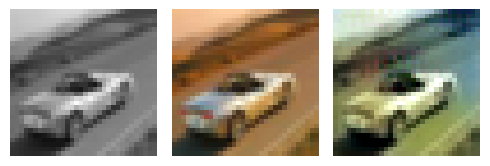

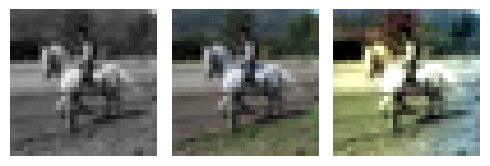

EPOCH: 32.760  trn_loss: 0.004  (3688.13s - 7569.83s remaining)

EPOCH: 32.765  trn_loss: 0.004  (3688.66s - 7569.17s remaining)

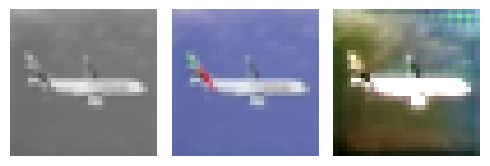

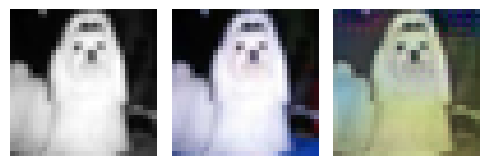

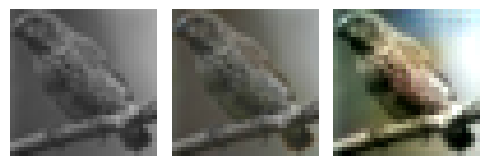

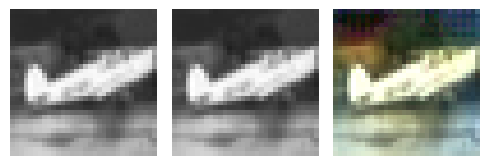

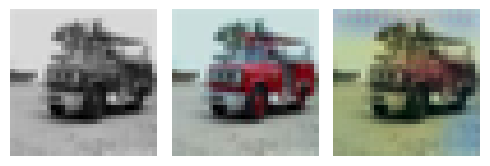

EPOCH: 32.950  val_loss: 0.005  (3720.17s - 7570.17s remaining)

EPOCH: 33.000  val_loss: 0.003  (3720.37s - 7553.48s remaining)

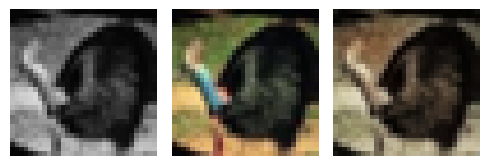

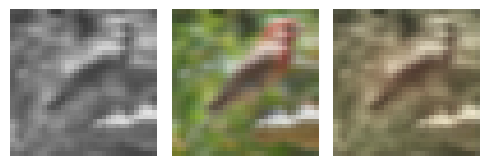

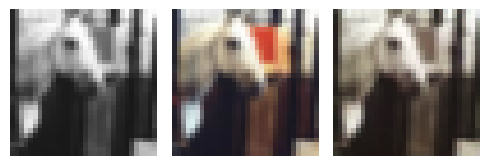

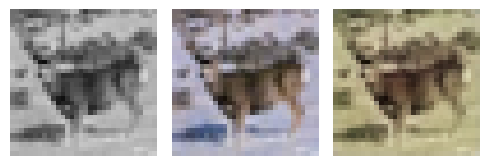

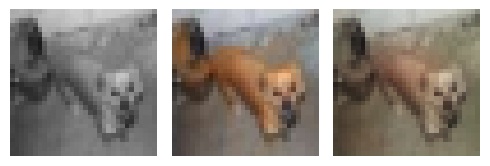

EPOCH: 33.250  trn_loss: 0.004  (3747.25s - 7522.67s remaining)

EPOCH: 33.255  trn_loss: 0.004  (3747.76s - 7521.98s remaining)

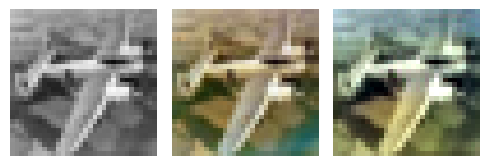

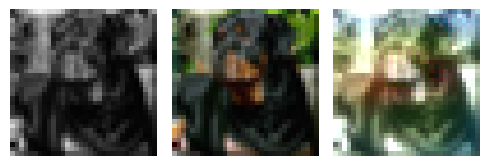

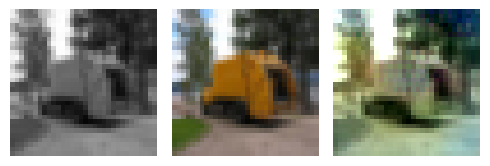

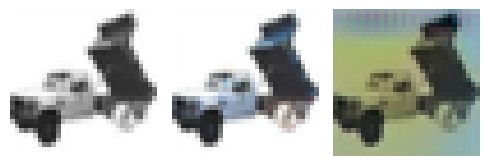

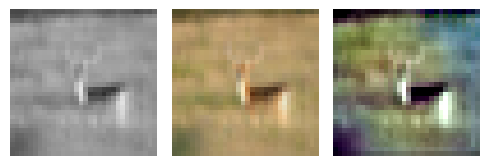

EPOCH: 33.505  trn_loss: 0.004  (3774.50s - 7490.94s remaining)

EPOCH: 33.510  trn_loss: 0.005  (3775.02s - 7490.26s remaining)

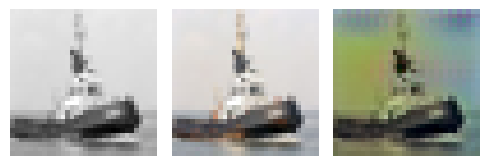

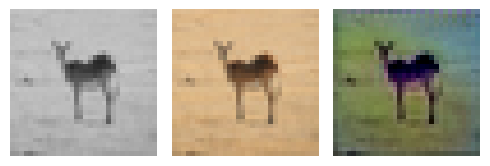

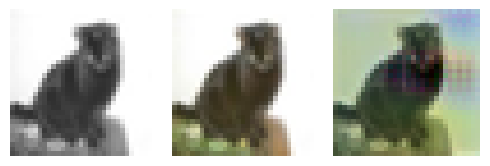

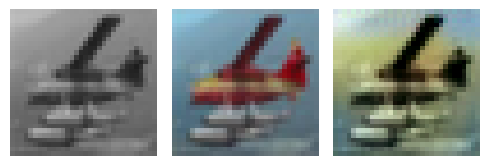

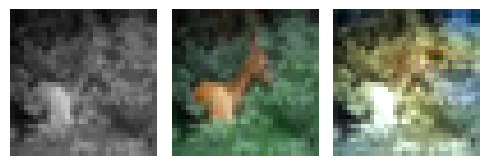

EPOCH: 33.760  trn_loss: 0.004  (3802.32s - 7460.40s remaining)

EPOCH: 33.765  trn_loss: 0.004  (3802.80s - 7459.66s remaining)

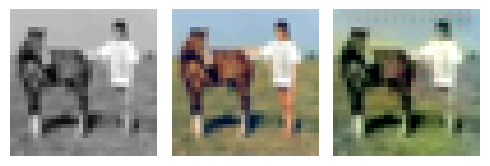

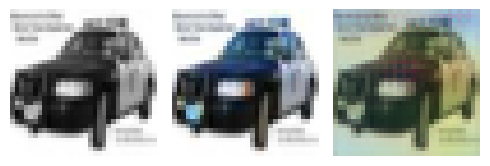

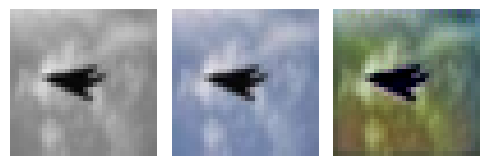

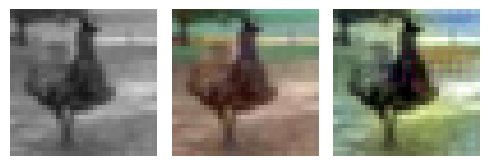

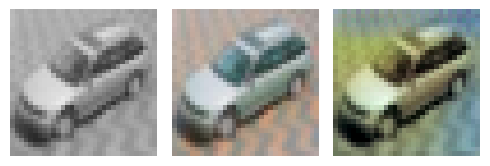

EPOCH: 34.000  val_loss: 0.003  (3835.77s - 7445.91s remaining)

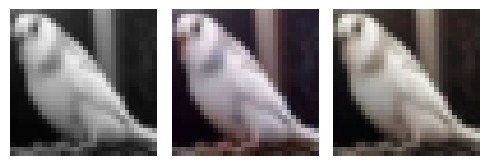

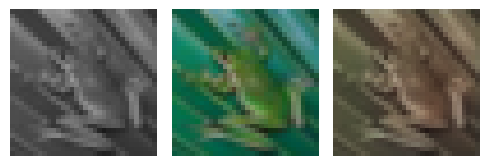

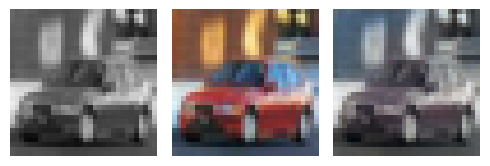

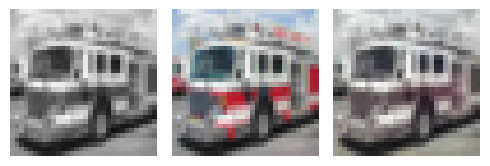

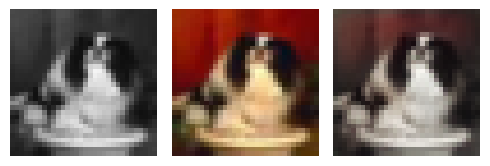

EPOCH: 34.250  trn_loss: 0.004  (3862.51s - 7414.88s remaining)

EPOCH: 34.255  trn_loss: 0.004  (3863.03s - 7414.20s remaining)

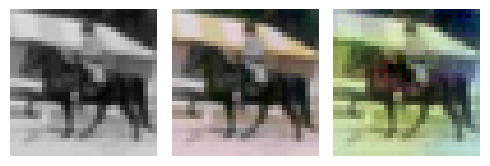

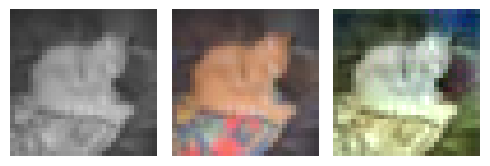

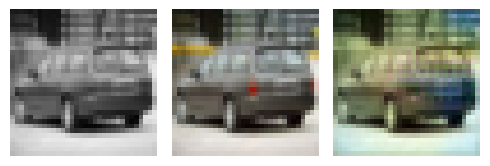

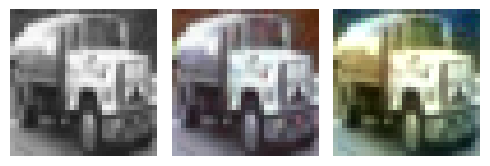

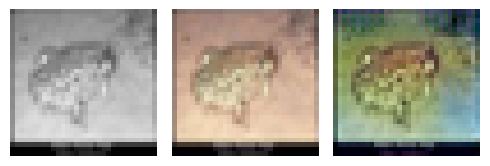

EPOCH: 34.500  trn_loss: 0.005  (3889.48s - 7384.38s remaining)

EPOCH: 34.510  trn_loss: 0.004  (3890.53s - 7383.04s remaining)

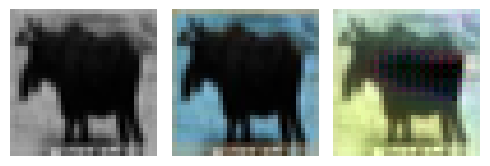

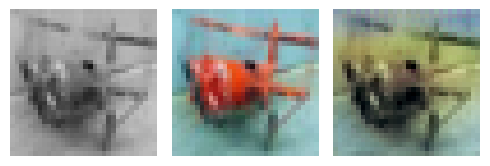

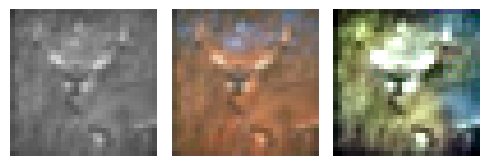

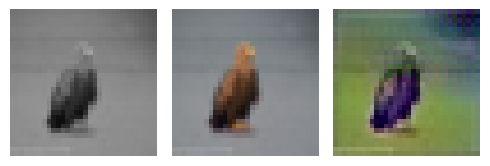

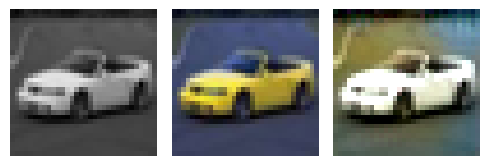

EPOCH: 34.760  trn_loss: 0.004  (3917.32s - 7352.24s remaining)

EPOCH: 34.765  trn_loss: 0.004  (3917.84s - 7351.56s remaining)

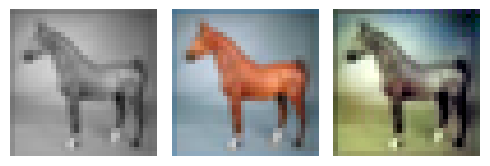

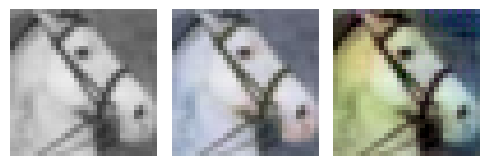

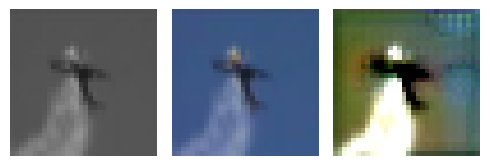

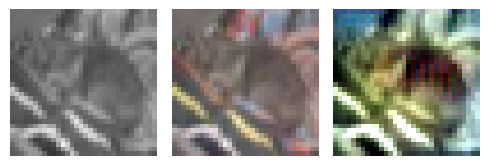

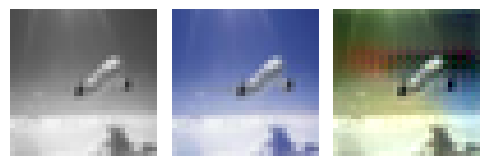

EPOCH: 35.000  trn_loss: 0.004  val_loss: 0.005  (3949.73s - 7335.21s remaining)


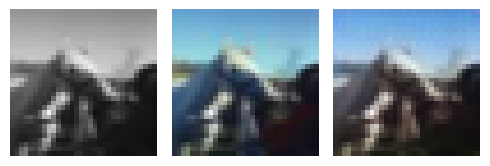

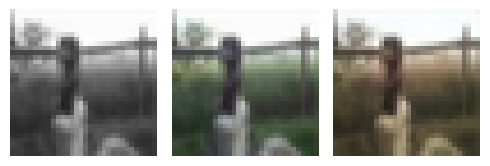

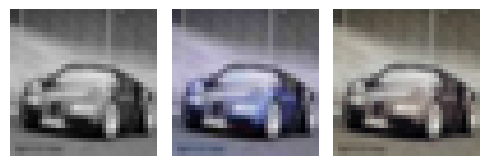

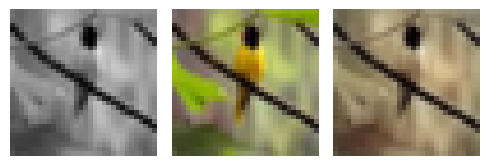

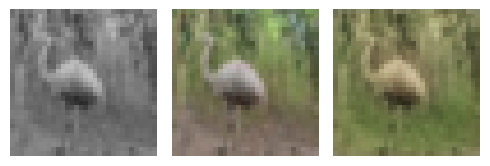

EPOCH: 35.250  trn_loss: 0.004  (3976.29s - 7303.96s remaining)

EPOCH: 35.255  trn_loss: 0.004  (3976.80s - 7303.27s remaining)

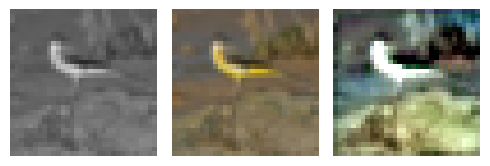

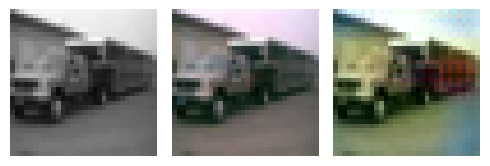

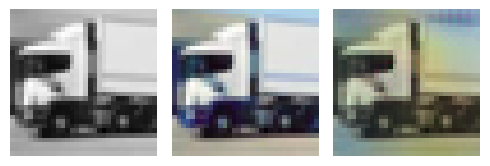

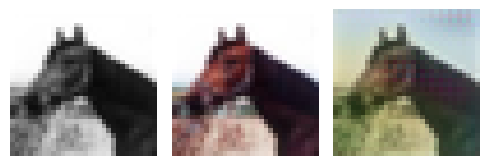

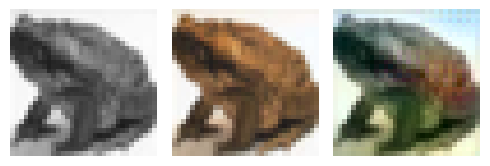

EPOCH: 35.510  trn_loss: 0.004  (4004.33s - 7272.23s remaining)

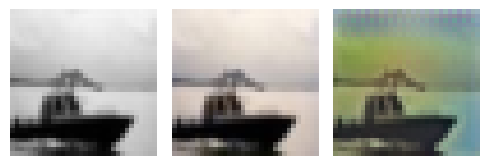

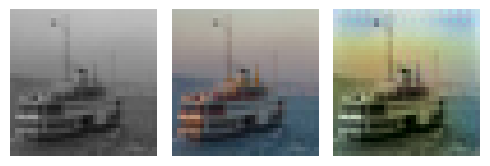

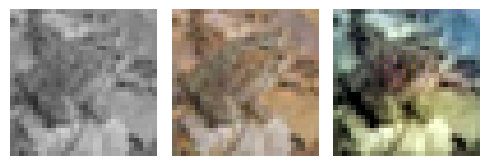

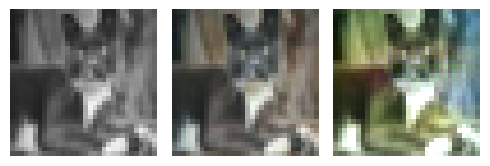

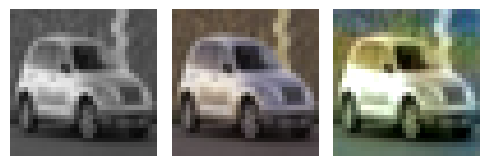

EPOCH: 35.760  trn_loss: 0.004  (4031.22s - 7241.71s remaining)

EPOCH: 35.765  trn_loss: 0.004  (4031.74s - 7241.03s remaining)

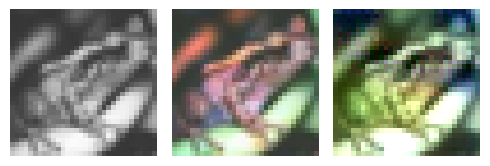

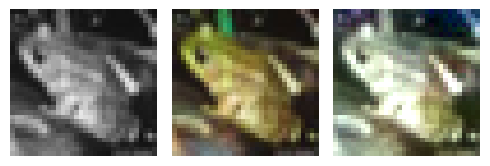

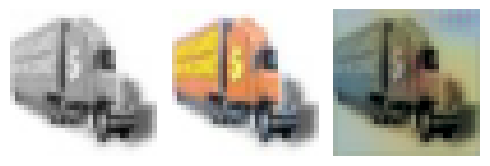

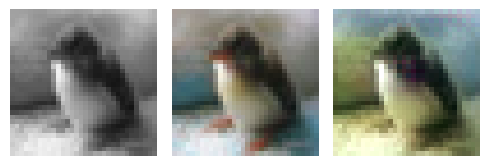

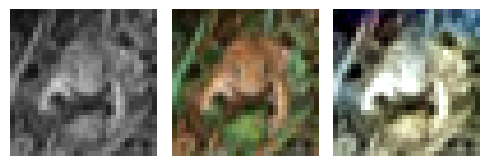

EPOCH: 36.000  val_loss: 0.003  (4065.43s - 7227.43s remaining)

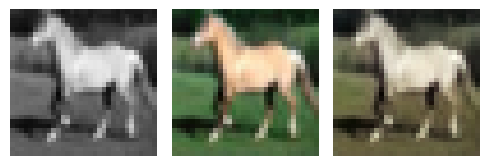

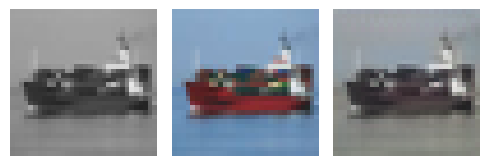

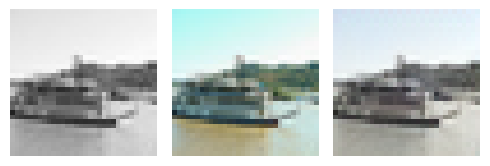

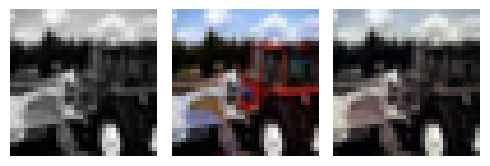

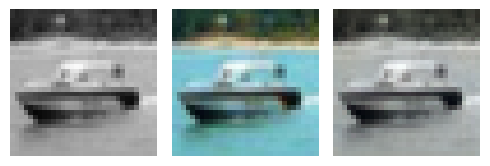

EPOCH: 36.250  trn_loss: 0.004  (4092.94s - 7197.94s remaining)

EPOCH: 36.255  trn_loss: 0.005  (4093.47s - 7197.26s remaining)

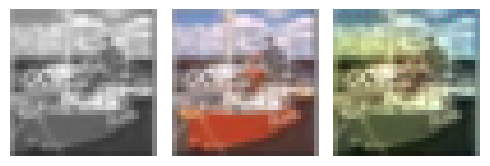

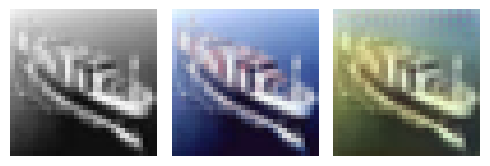

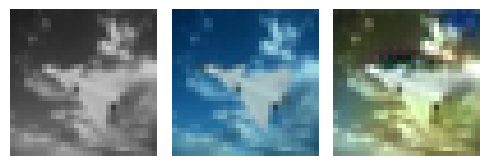

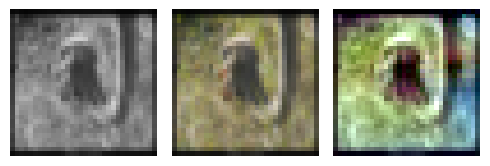

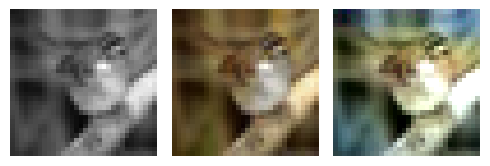

EPOCH: 36.505  trn_loss: 0.005  (4120.39s - 7166.77s remaining)

EPOCH: 36.510  trn_loss: 0.004  (4120.88s - 7166.05s remaining)

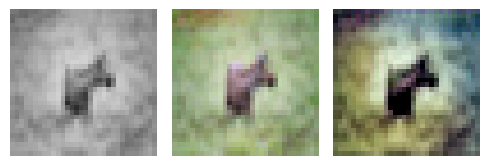

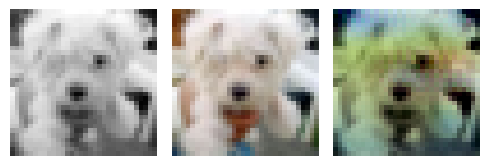

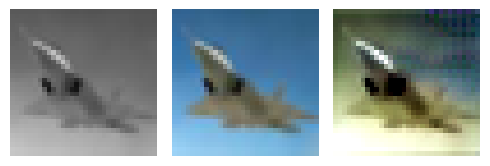

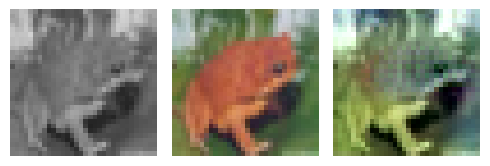

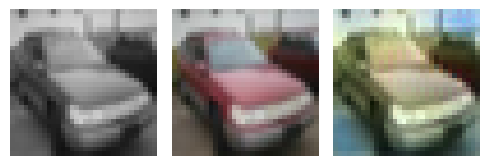

EPOCH: 36.760  trn_loss: 0.004  (4147.86s - 7135.70s remaining)

EPOCH: 36.765  trn_loss: 0.004  (4148.39s - 7135.05s remaining)

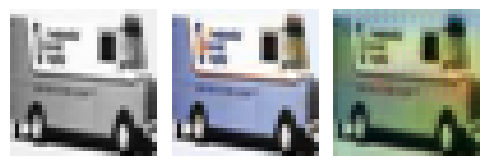

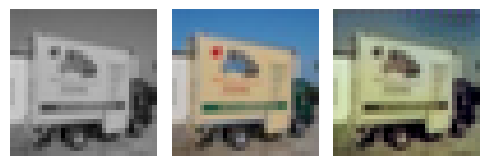

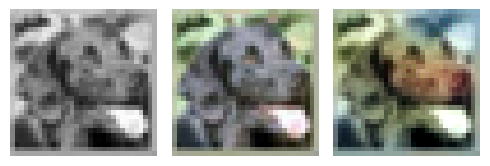

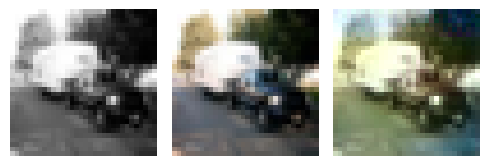

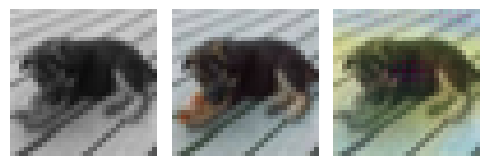

EPOCH: 37.000  val_loss: 0.003  (4180.09s - 7117.45s remaining)

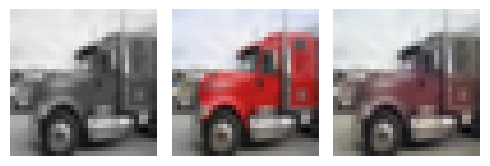

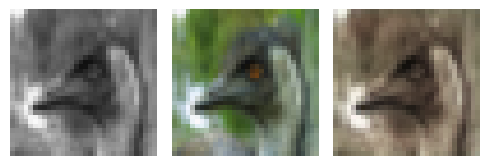

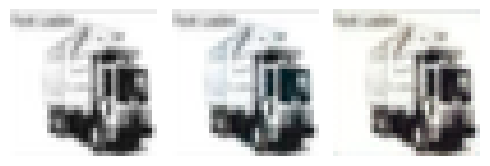

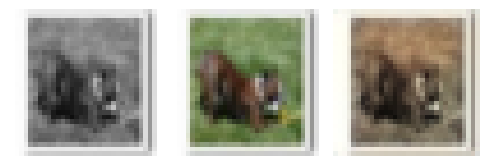

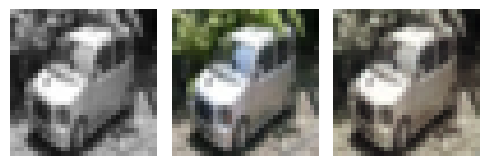

EPOCH: 37.250  trn_loss: 0.004  (4207.26s - 7087.39s remaining)

EPOCH: 37.255  trn_loss: 0.005  (4207.78s - 7086.72s remaining)

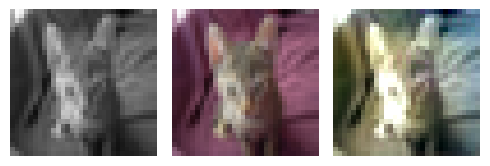

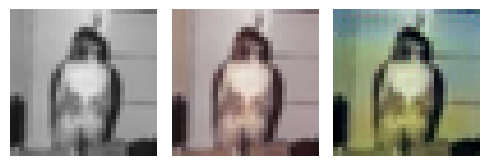

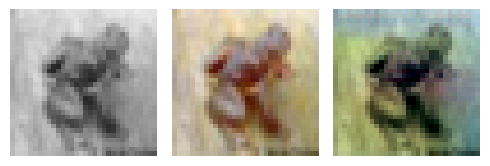

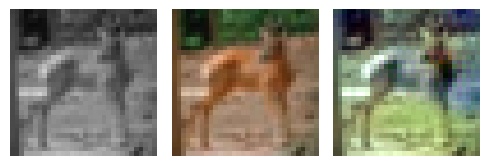

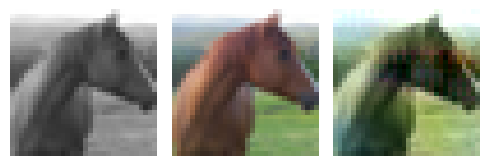

EPOCH: 37.510  trn_loss: 0.004  (4235.26s - 7055.70s remaining)

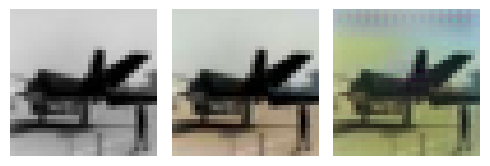

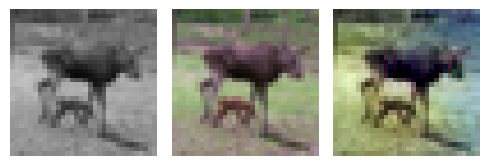

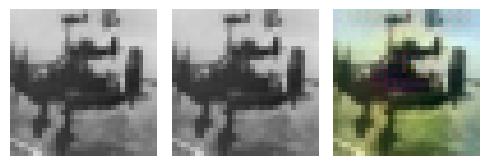

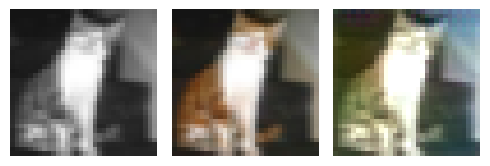

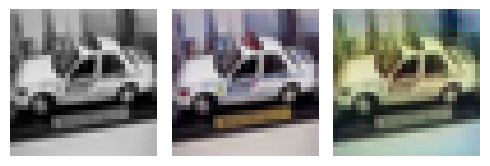

EPOCH: 37.760  trn_loss: 0.004  (4262.09s - 7025.16s remaining)

EPOCH: 37.765  trn_loss: 0.004  (4262.61s - 7024.50s remaining)

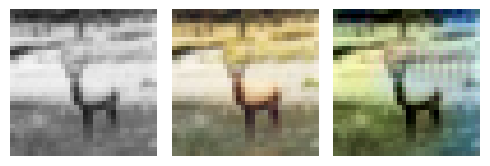

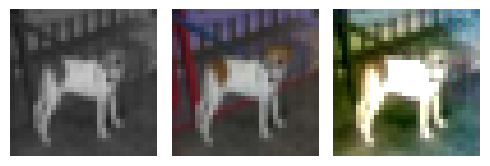

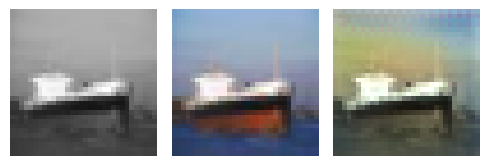

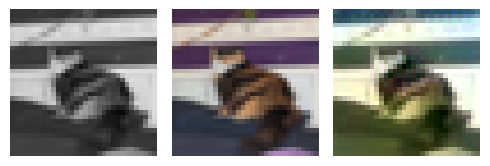

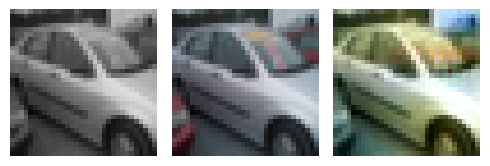

EPOCH: 37.950  val_loss: 0.005  (4295.47s - 7023.29s remaining)

EPOCH: 38.000  val_loss: 0.003  (4295.72s - 7008.81s remaining)

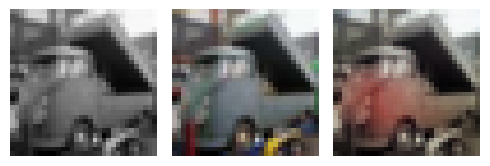

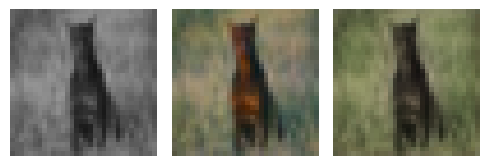

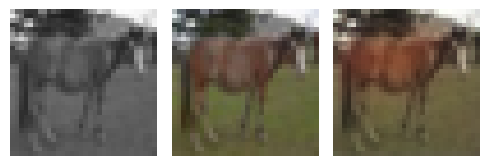

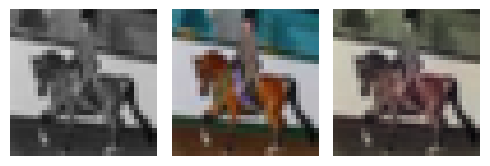

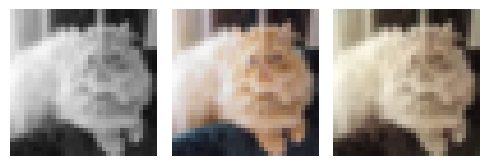

EPOCH: 38.250  trn_loss: 0.004  (4322.69s - 6978.46s remaining)

EPOCH: 38.255  trn_loss: 0.004  (4323.24s - 6977.83s remaining)

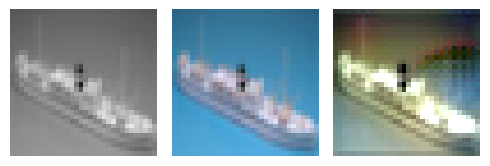

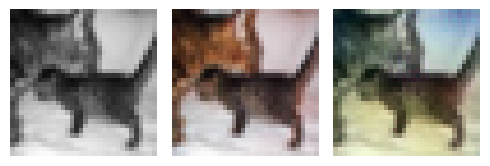

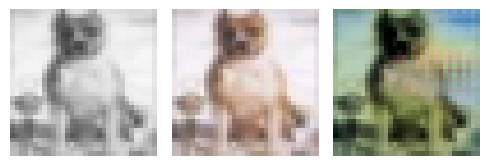

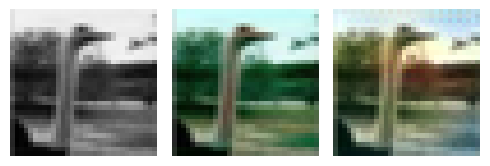

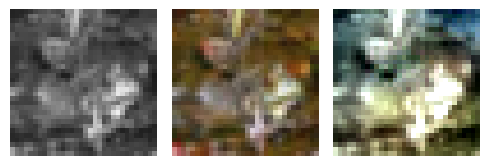

EPOCH: 38.510  trn_loss: 0.005  (4350.38s - 6946.32s remaining)

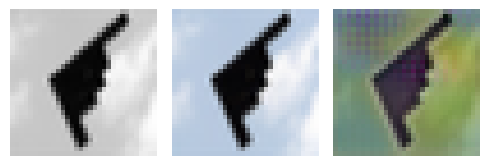

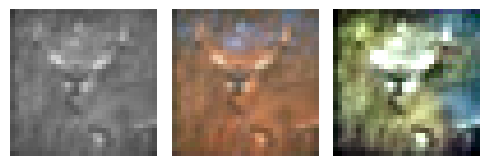

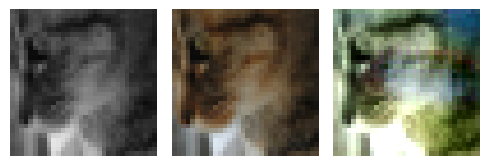

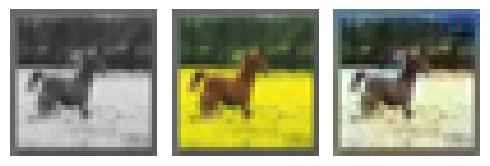

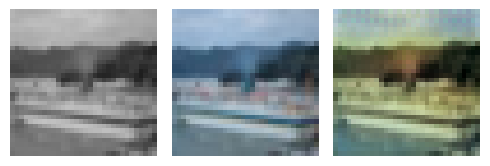

EPOCH: 38.765  trn_loss: 0.004  (4378.02s - 6915.63s remaining)

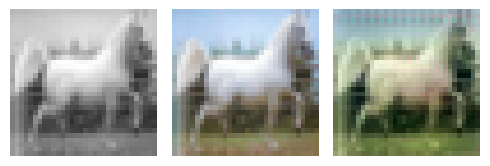

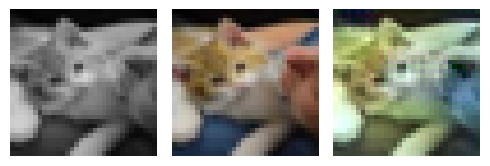

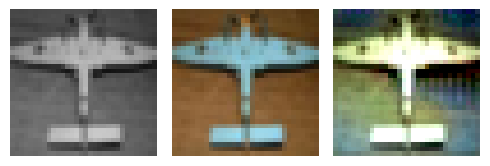

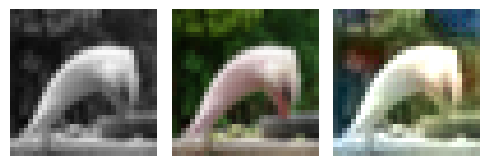

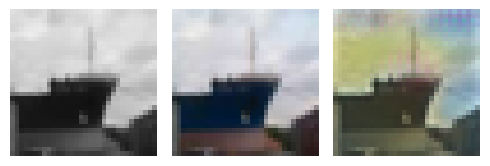

EPOCH: 39.000  val_loss: 0.003  (4410.38s - 6898.28s remaining)

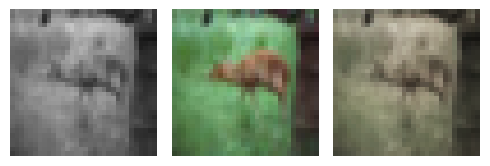

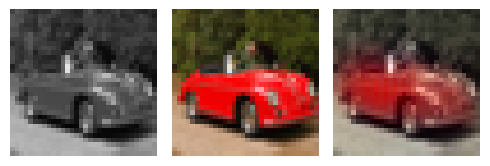

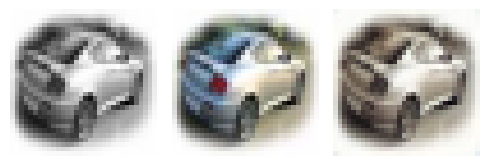

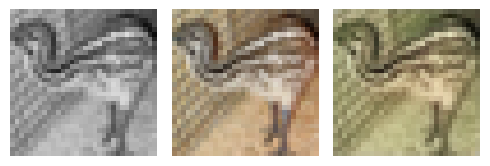

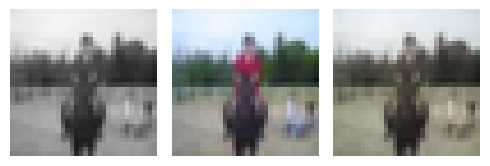

EPOCH: 39.250  trn_loss: 0.004  (4436.95s - 6867.38s remaining)

EPOCH: 39.255  trn_loss: 0.004  (4437.46s - 6866.70s remaining)

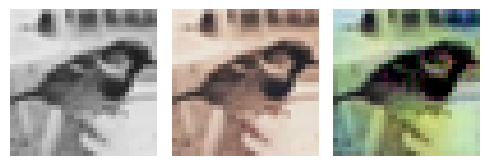

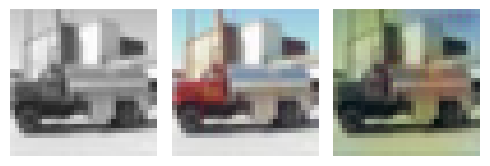

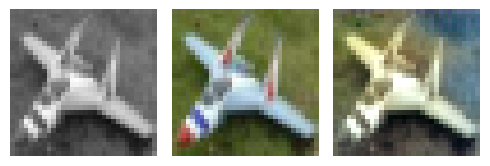

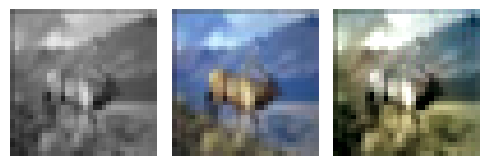

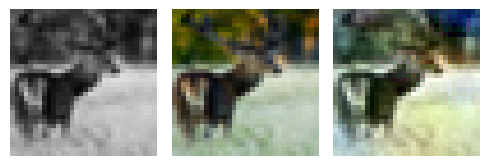

EPOCH: 39.505  trn_loss: 0.004  (4464.17s - 6836.06s remaining)

EPOCH: 39.510  trn_loss: 0.004  (4464.69s - 6835.40s remaining)

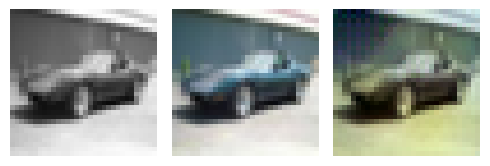

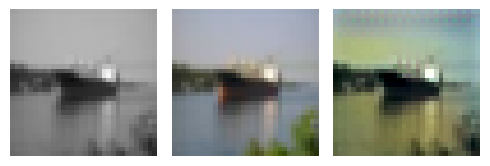

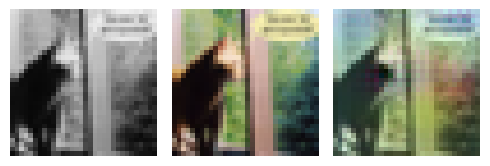

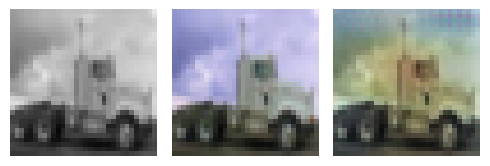

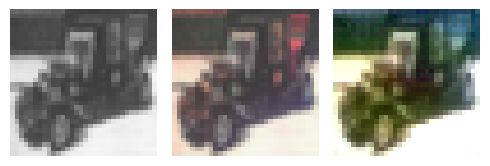

EPOCH: 39.760  trn_loss: 0.004  (4491.70s - 6805.27s remaining)

EPOCH: 39.765  trn_loss: 0.004  (4492.22s - 6804.61s remaining)

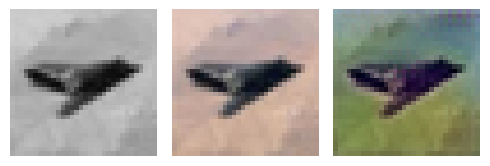

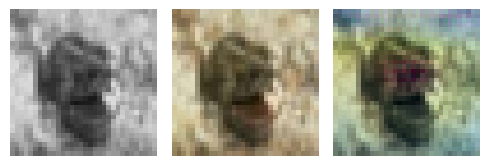

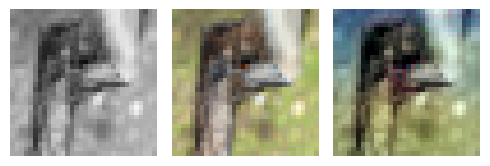

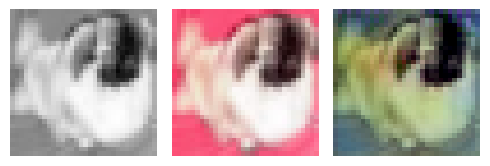

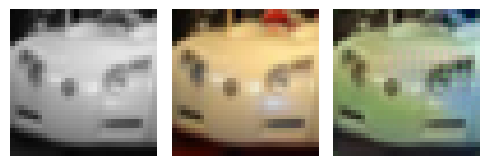

EPOCH: 40.000  trn_loss: 0.004  val_loss: 0.005  (4524.80s - 6787.20s remaining)


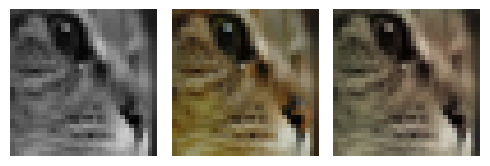

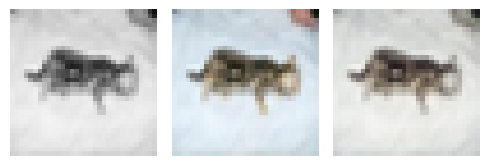

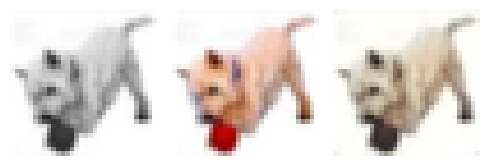

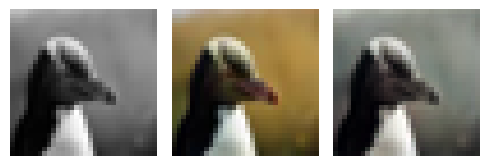

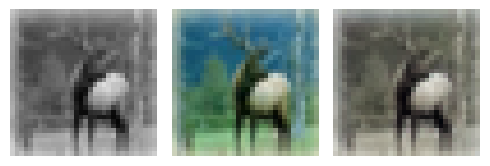

EPOCH: 40.250  trn_loss: 0.004  (4551.75s - 6756.94s remaining)

EPOCH: 40.255  trn_loss: 0.004  (4552.31s - 6756.35s remaining)

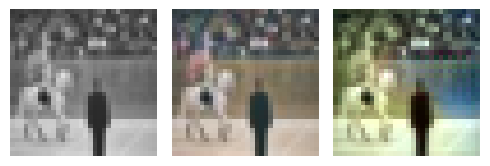

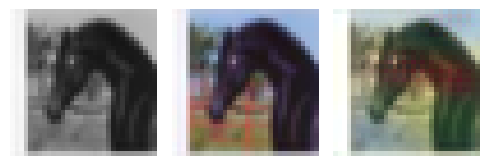

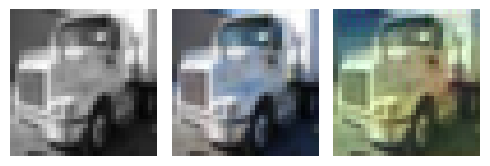

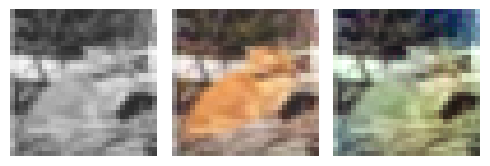

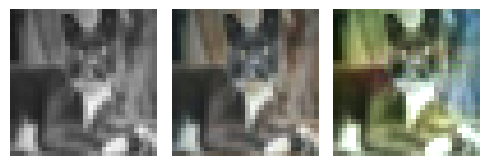

EPOCH: 40.505  trn_loss: 0.004  (4579.08s - 6725.87s remaining)

EPOCH: 40.510  trn_loss: 0.004  (4579.61s - 6725.22s remaining)

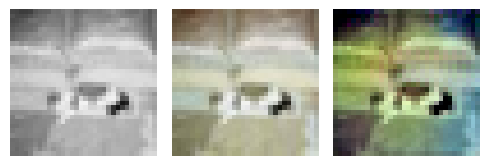

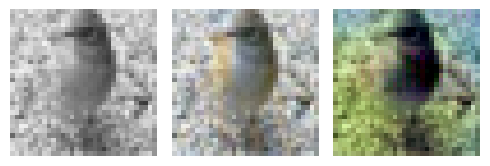

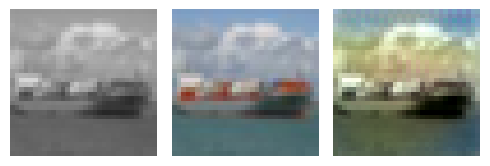

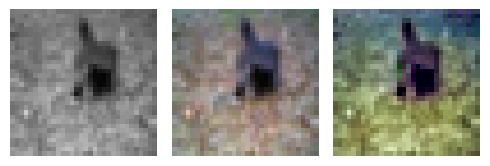

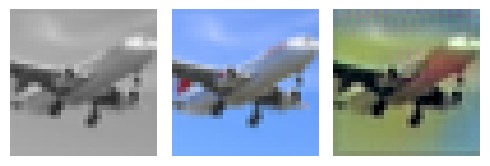

EPOCH: 40.760  trn_loss: 0.004  (4606.59s - 6695.10s remaining)

EPOCH: 40.765  trn_loss: 0.005  (4607.14s - 6694.48s remaining)

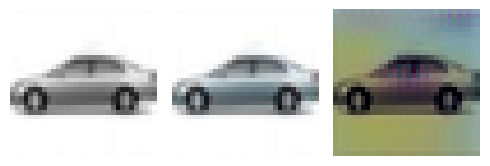

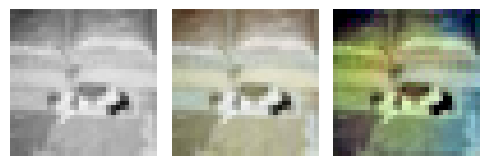

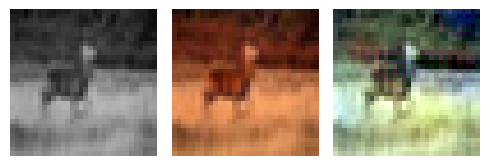

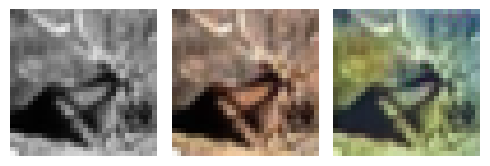

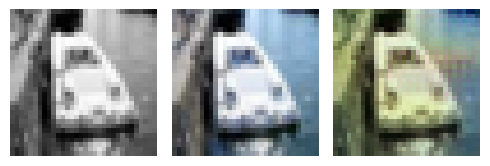

EPOCH: 40.950  val_loss: 0.005  (4639.69s - 6690.44s remaining)

EPOCH: 41.000  val_loss: 0.003  (4639.89s - 6676.91s remaining)

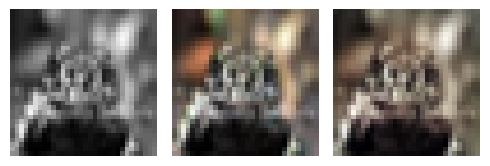

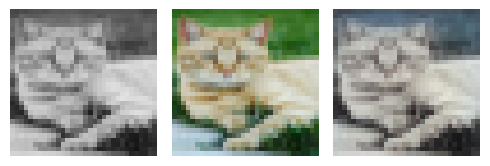

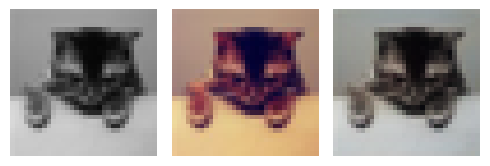

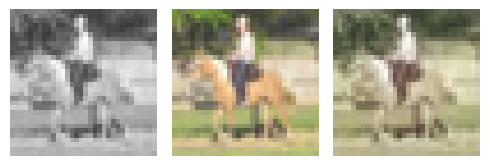

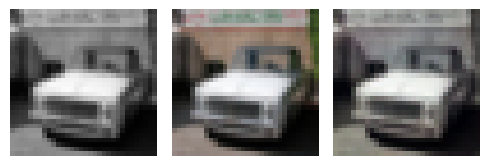

EPOCH: 41.250  trn_loss: 0.005  (4666.66s - 6646.45s remaining)

EPOCH: 41.255  trn_loss: 0.005  (4667.17s - 6645.78s remaining)

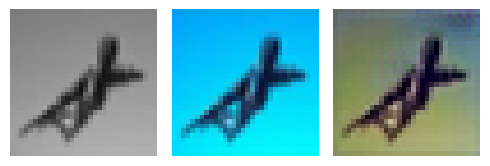

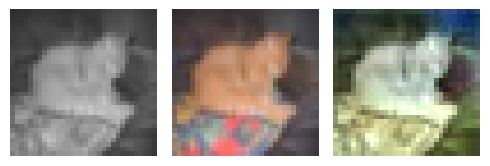

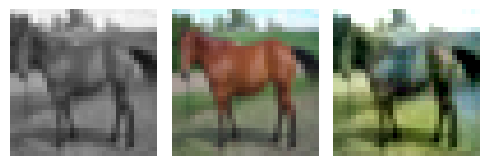

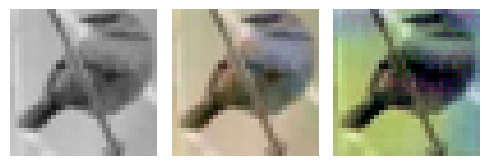

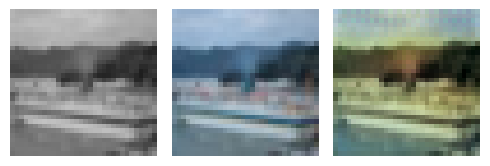

EPOCH: 41.505  trn_loss: 0.005  (4694.07s - 6615.55s remaining)

EPOCH: 41.510  trn_loss: 0.005  (4694.58s - 6614.88s remaining)

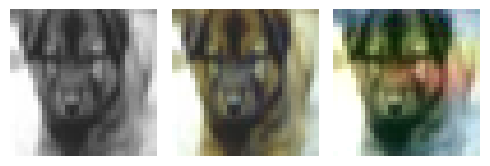

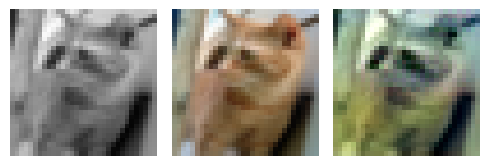

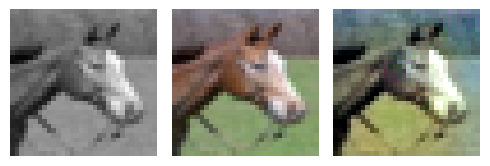

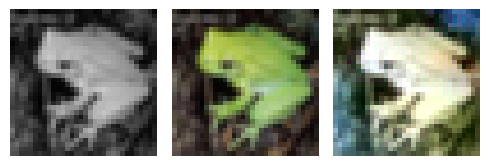

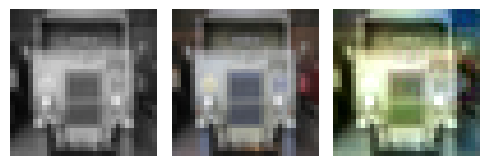

EPOCH: 41.760  trn_loss: 0.004  (4721.16s - 6584.24s remaining)

EPOCH: 41.765  trn_loss: 0.004  (4721.67s - 6583.58s remaining)

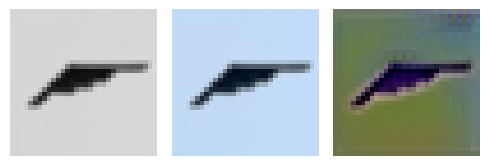

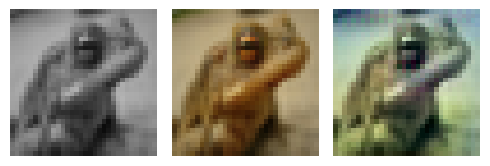

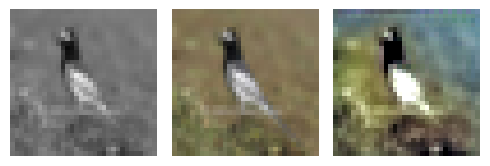

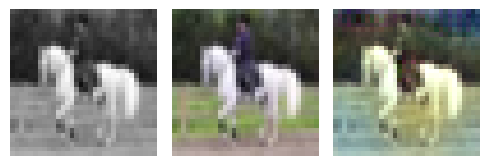

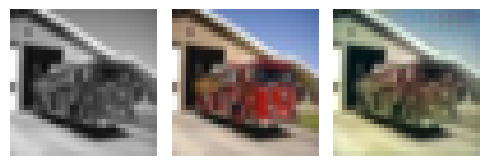

EPOCH: 41.950  val_loss: 0.005  (4753.50s - 6577.84s remaining)

EPOCH: 42.000  val_loss: 0.003  (4753.73s - 6564.67s remaining)

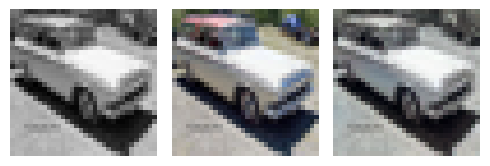

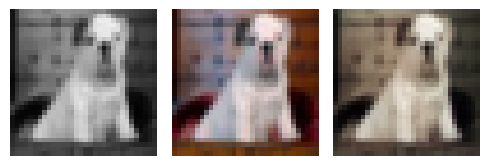

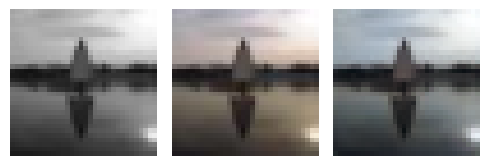

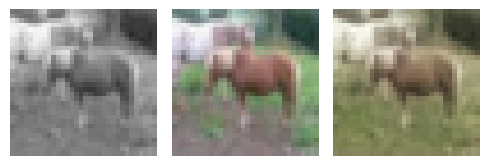

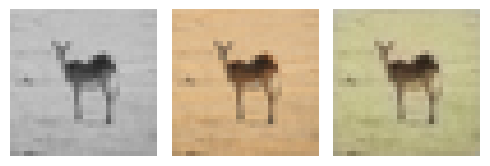

EPOCH: 42.245  trn_loss: 0.004  (4779.83s - 6534.75s remaining)

EPOCH: 42.255  trn_loss: 0.004  (4780.87s - 6533.43s remaining)

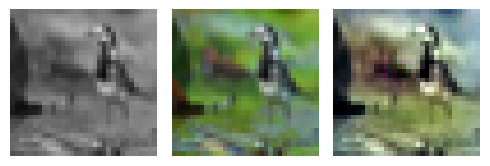

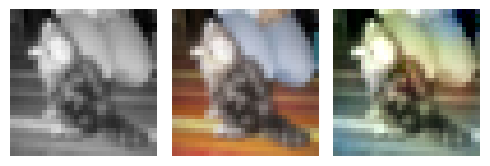

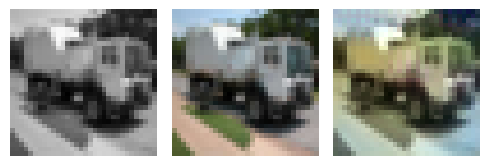

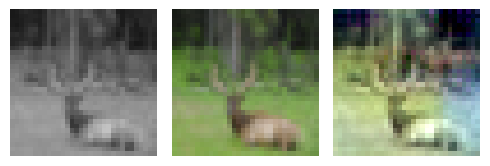

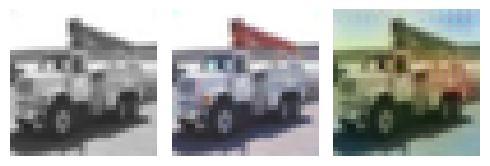

EPOCH: 42.505  trn_loss: 0.005  (4807.99s - 6503.57s remaining)

EPOCH: 42.510  trn_loss: 0.005  (4808.51s - 6502.92s remaining)

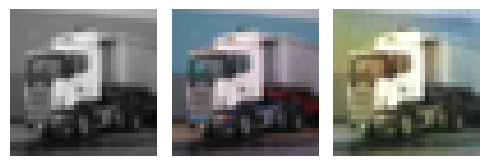

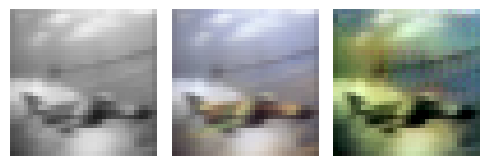

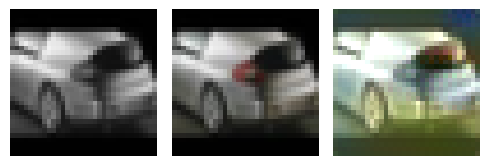

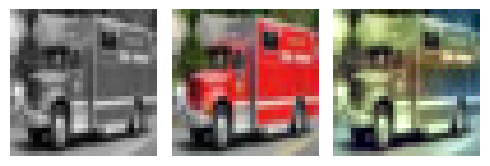

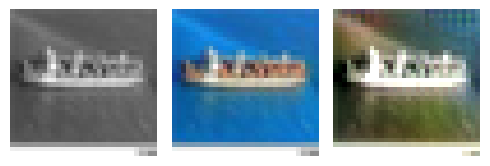

EPOCH: 42.760  trn_loss: 0.004  (4835.48s - 6472.88s remaining)

EPOCH: 42.765  trn_loss: 0.004  (4836.00s - 6472.23s remaining)

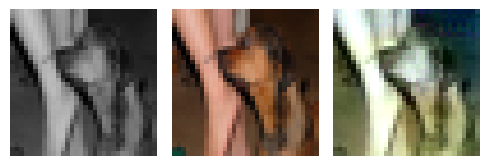

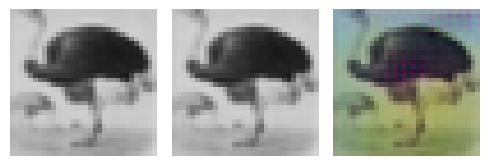

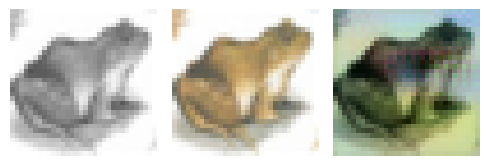

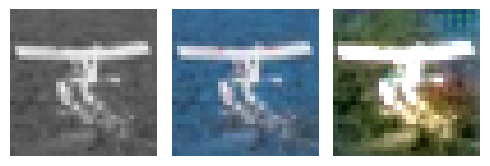

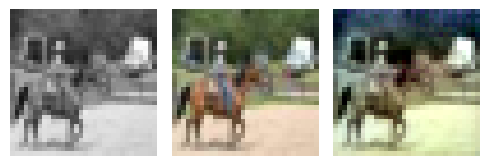

EPOCH: 43.000  val_loss: 0.003  (4868.59s - 6453.71s remaining)

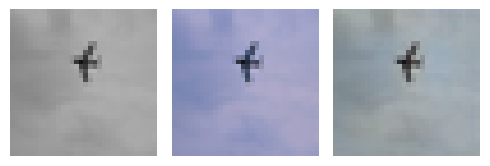

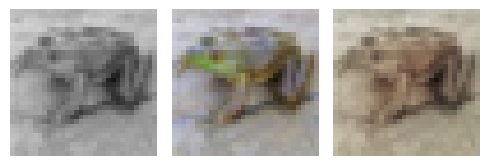

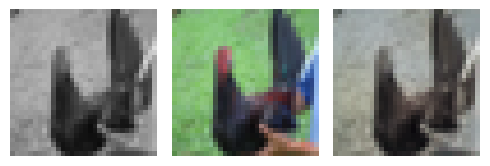

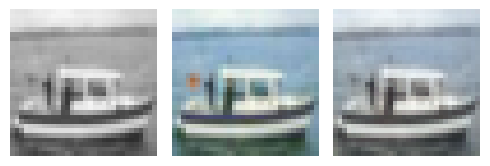

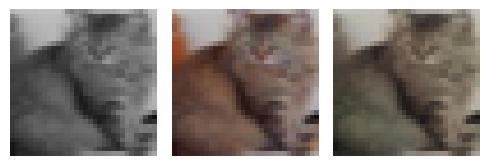

EPOCH: 43.250  trn_loss: 0.005  (4895.87s - 6424.06s remaining)

EPOCH: 43.255  trn_loss: 0.004  (4896.42s - 6423.44s remaining)

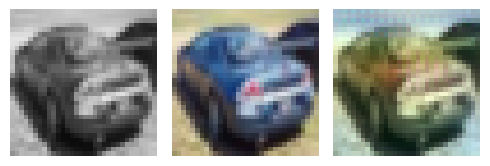

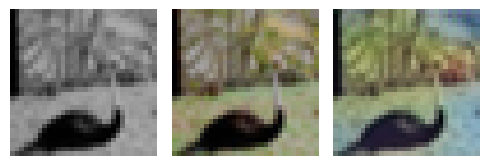

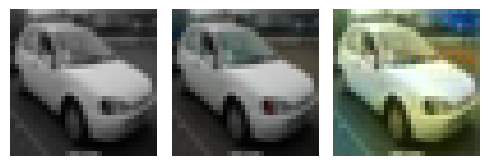

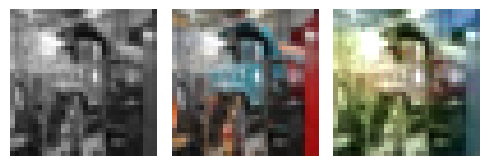

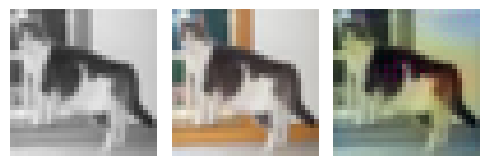

EPOCH: 43.505  trn_loss: 0.004  (4923.26s - 6393.25s remaining)

EPOCH: 43.510  trn_loss: 0.003  (4923.80s - 6392.63s remaining)

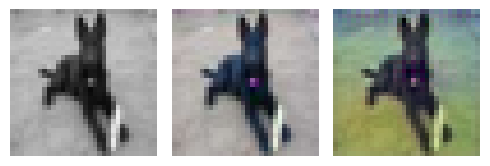

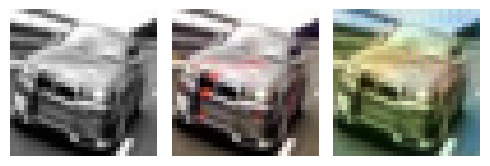

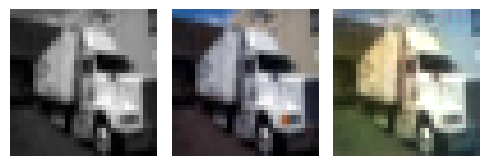

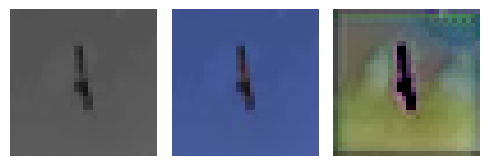

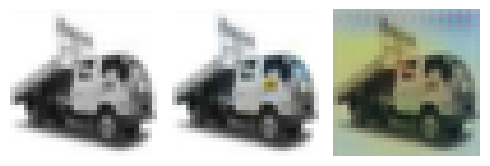

EPOCH: 43.765  trn_loss: 0.005  (4951.20s - 6361.87s remaining)

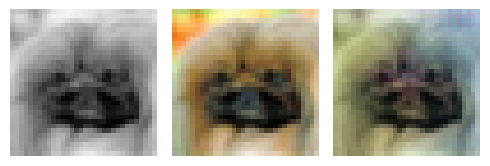

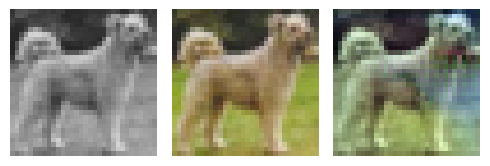

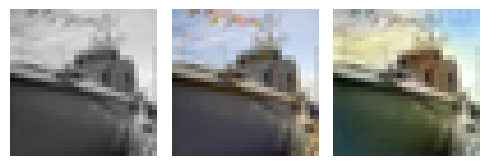

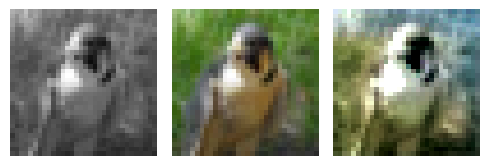

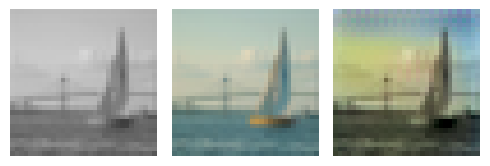

EPOCH: 43.950  val_loss: 0.005  (4983.78s - 6355.88s remaining)

EPOCH: 44.000  val_loss: 0.003  (4983.99s - 6343.26s remaining)

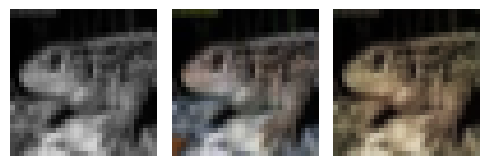

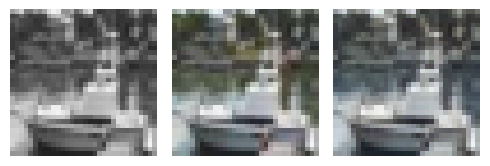

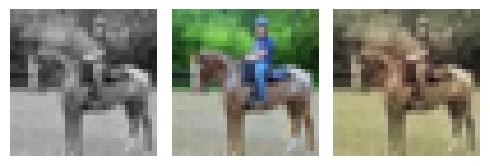

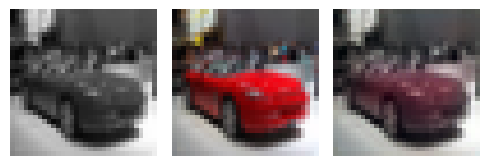

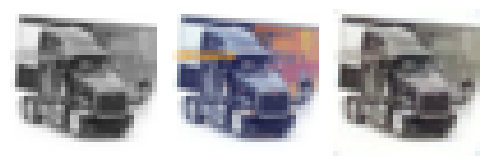

EPOCH: 44.255  trn_loss: 0.005  (5011.43s - 6312.53s remaining)

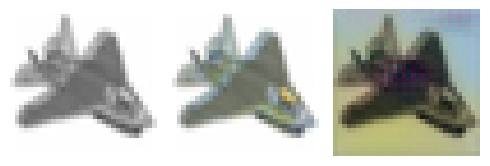

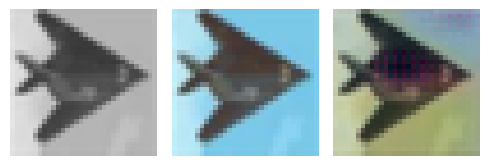

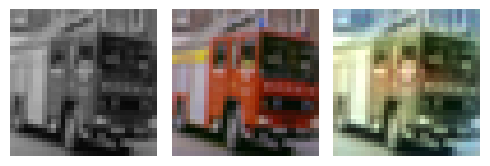

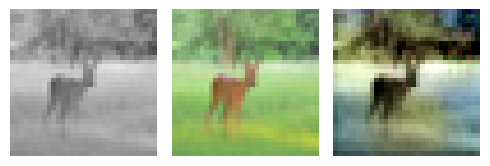

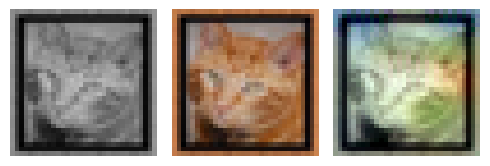

EPOCH: 44.505  trn_loss: 0.004  (5038.39s - 6282.54s remaining)

EPOCH: 44.510  trn_loss: 0.004  (5038.93s - 6281.91s remaining)

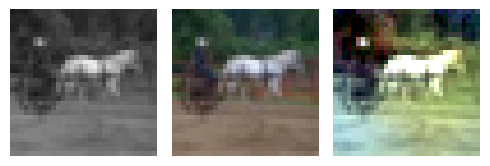

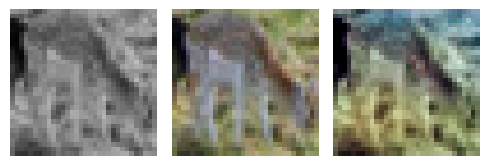

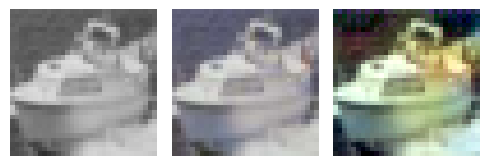

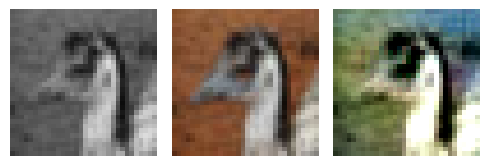

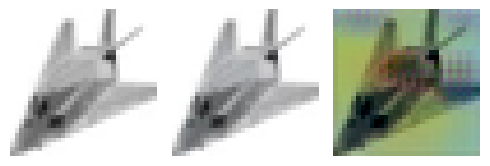

EPOCH: 44.765  trn_loss: 0.004  (5066.20s - 6251.05s remaining)

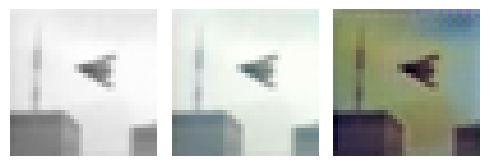

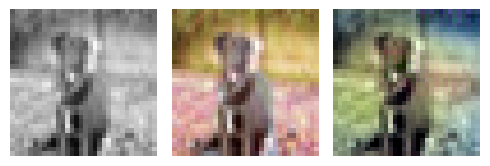

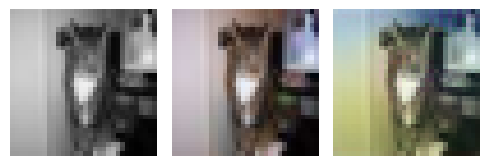

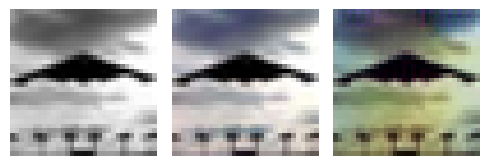

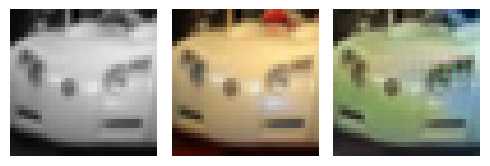

EPOCH: 45.000  trn_loss: 0.004  val_loss: 0.005  (5098.92s - 6232.01s remaining)


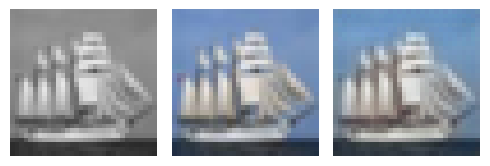

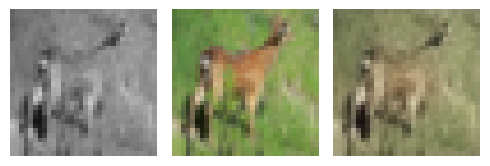

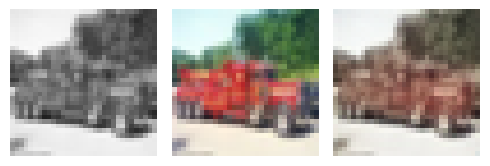

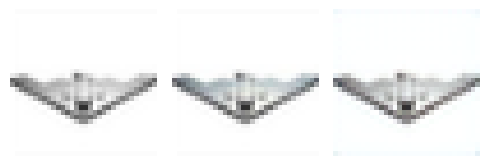

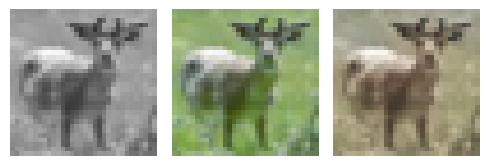

EPOCH: 45.250  trn_loss: 0.004  (5125.83s - 6201.97s remaining)

EPOCH: 45.255  trn_loss: 0.005  (5126.35s - 6201.33s remaining)

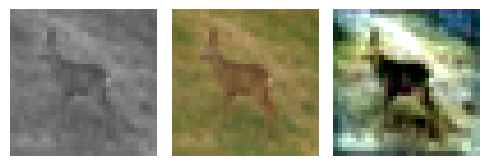

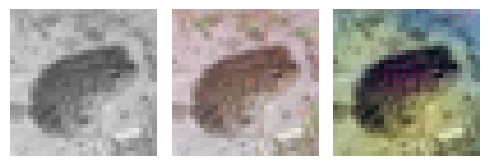

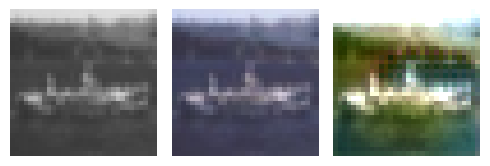

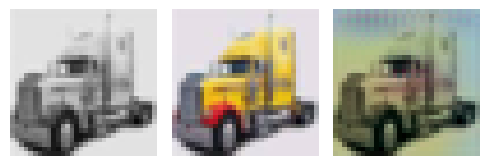

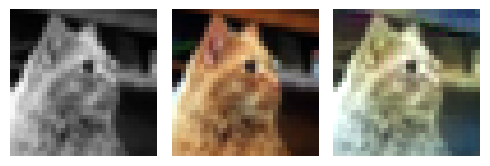

EPOCH: 45.505  trn_loss: 0.005  (5153.45s - 6171.54s remaining)

EPOCH: 45.510  trn_loss: 0.004  (5154.00s - 6170.93s remaining)

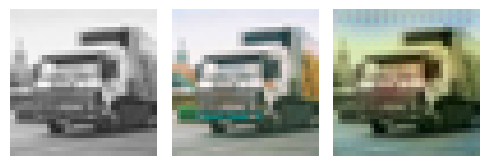

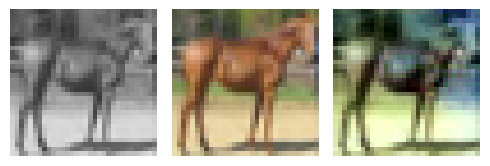

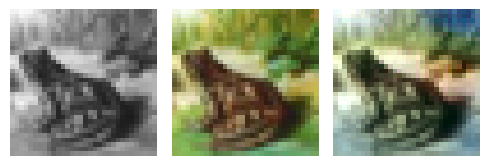

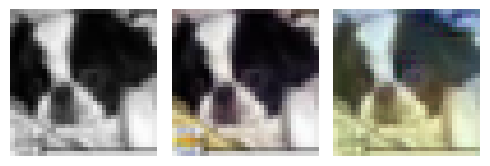

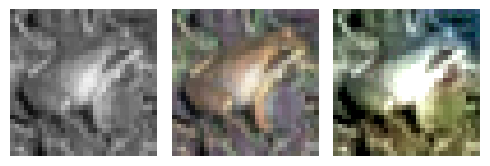

EPOCH: 45.760  trn_loss: 0.005  (5181.10s - 6141.19s remaining)

EPOCH: 45.765  trn_loss: 0.004  (5181.62s - 6140.54s remaining)

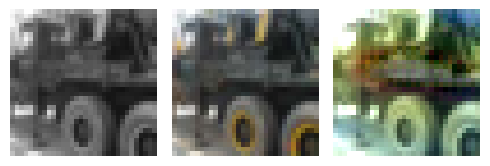

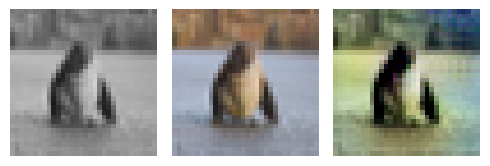

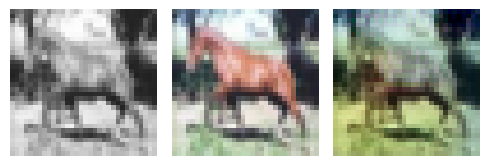

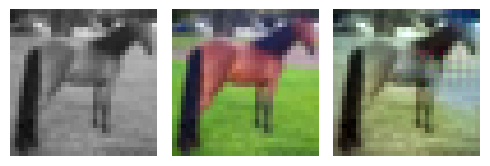

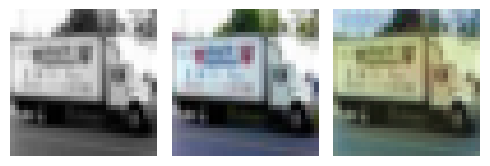

EPOCH: 46.000  val_loss: 0.003  (5214.32s - 6121.16s remaining)

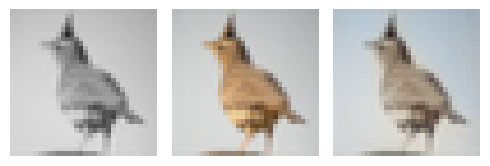

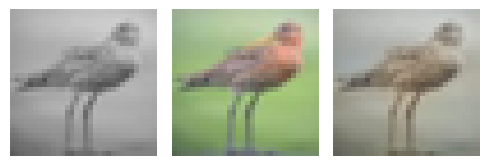

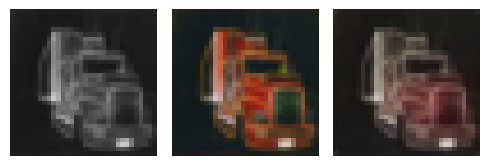

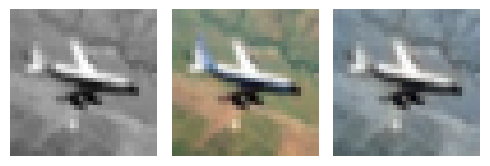

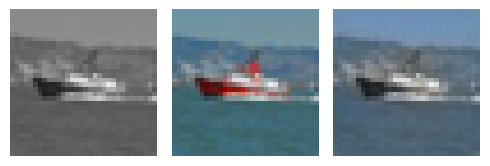

EPOCH: 46.250  trn_loss: 0.004  (5241.15s - 6091.07s remaining)

EPOCH: 46.255  trn_loss: 0.004  (5241.70s - 6090.46s remaining)

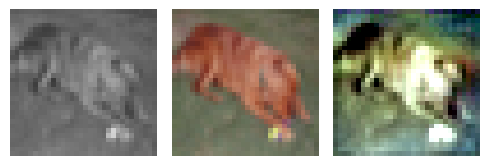

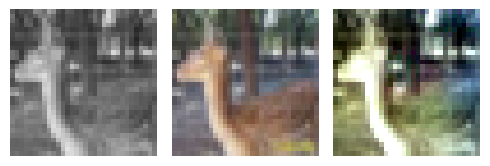

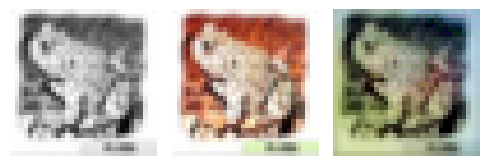

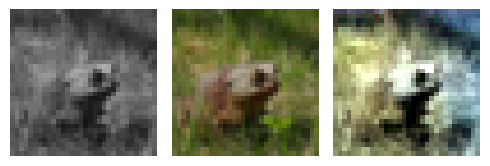

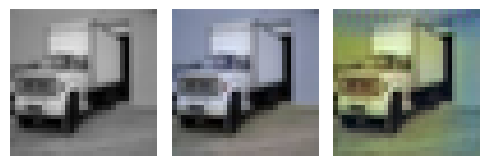

EPOCH: 46.505  trn_loss: 0.004  (5268.50s - 6060.37s remaining)

EPOCH: 46.510  trn_loss: 0.005  (5269.08s - 6059.79s remaining)

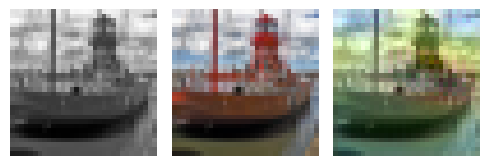

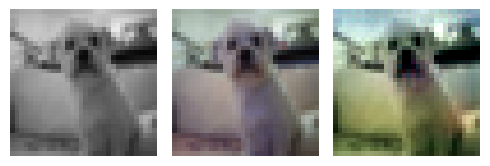

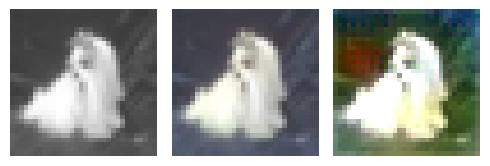

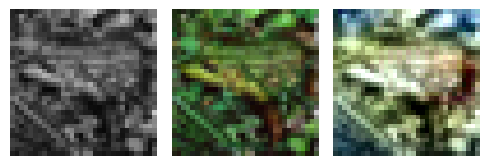

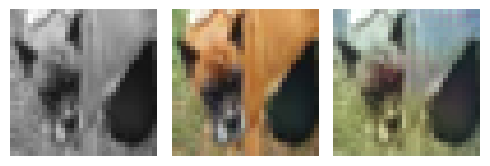

EPOCH: 46.760  trn_loss: 0.004  (5296.35s - 6030.27s remaining)

EPOCH: 46.765  trn_loss: 0.005  (5296.89s - 6029.65s remaining)

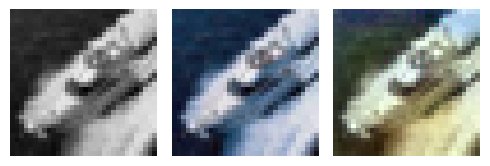

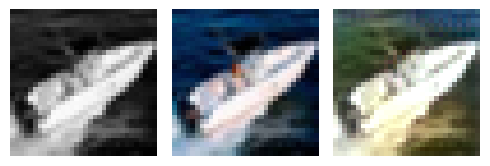

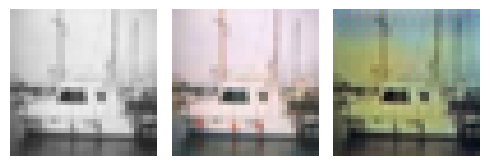

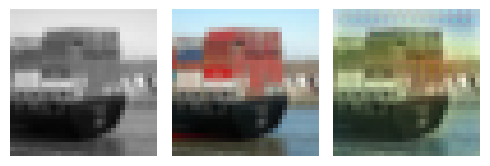

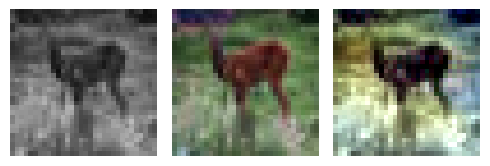

EPOCH: 47.000  val_loss: 0.003  (5330.20s - 6010.66s remaining)

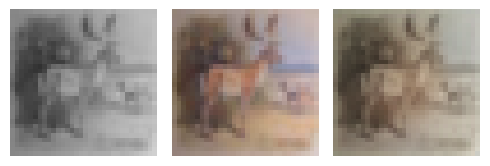

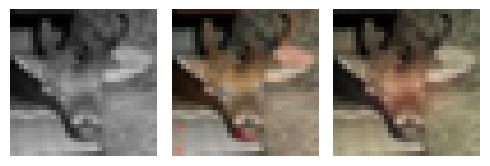

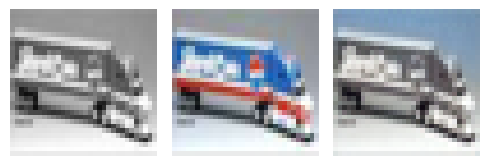

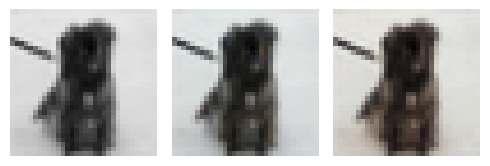

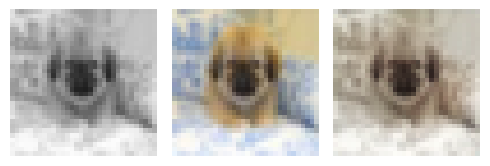

EPOCH: 47.250  trn_loss: 0.004  (5356.92s - 5980.47s remaining)

EPOCH: 47.255  trn_loss: 0.004  (5357.48s - 5979.88s remaining)

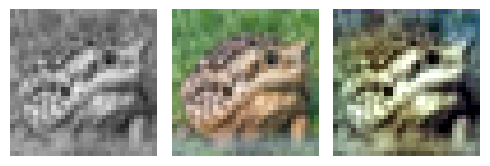

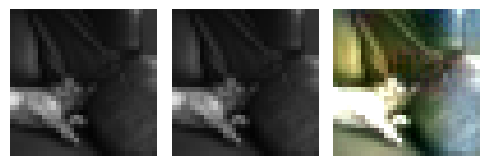

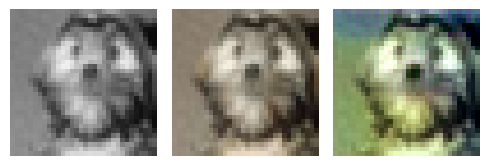

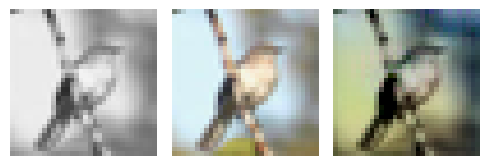

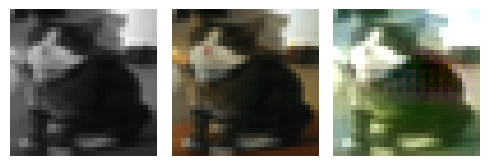

EPOCH: 47.505  trn_loss: 0.004  (5384.90s - 5950.52s remaining)

EPOCH: 47.510  trn_loss: 0.005  (5385.48s - 5949.94s remaining)

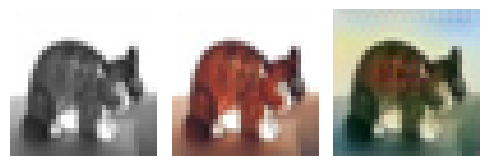

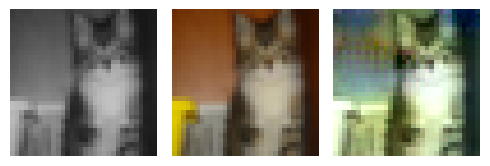

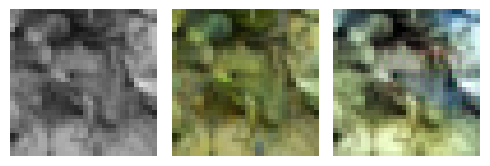

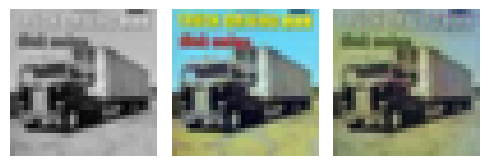

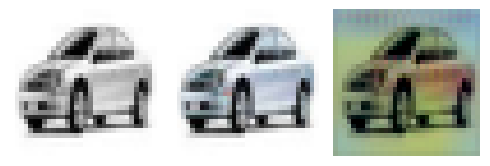

EPOCH: 47.760  trn_loss: 0.005  (5412.19s - 5919.81s remaining)

EPOCH: 47.765  trn_loss: 0.005  (5412.78s - 5919.25s remaining)

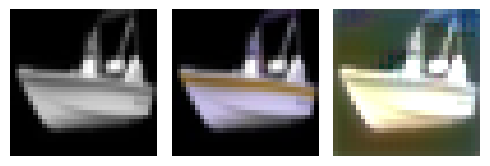

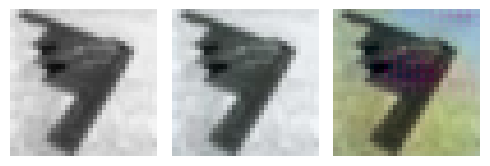

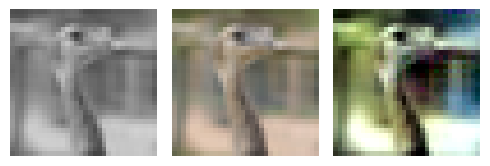

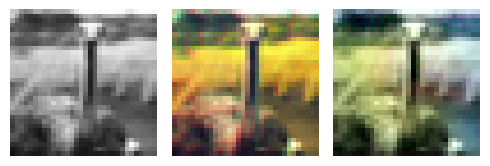

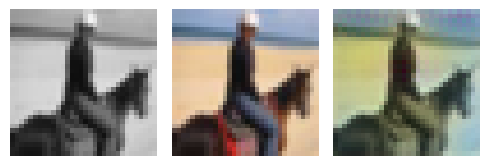

EPOCH: 47.950  val_loss: 0.005  (5445.37s - 5910.98s remaining)

EPOCH: 48.000  val_loss: 0.003  (5445.59s - 5899.39s remaining)

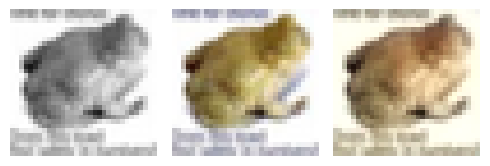

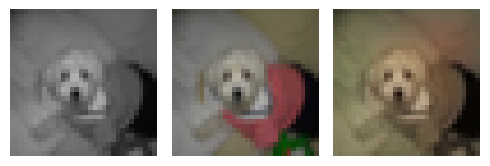

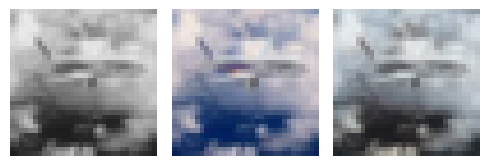

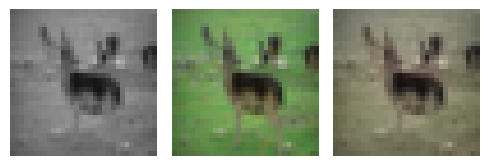

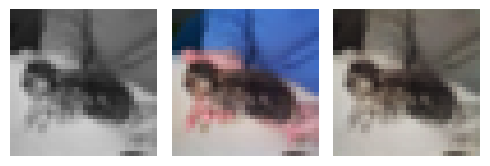

EPOCH: 48.250  trn_loss: 0.004  (5472.37s - 5869.32s remaining)

EPOCH: 48.255  trn_loss: 0.004  (5472.89s - 5868.68s remaining)

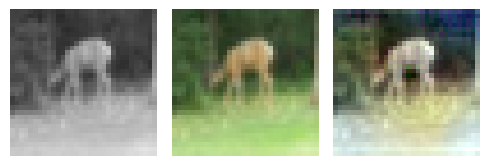

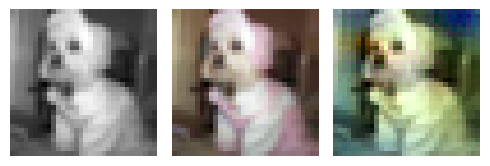

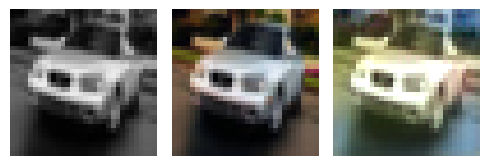

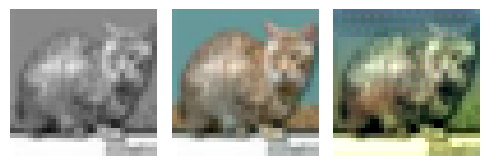

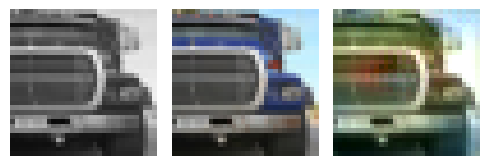

EPOCH: 48.510  trn_loss: 0.005  (5500.26s - 5838.10s remaining)

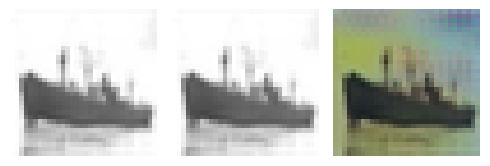

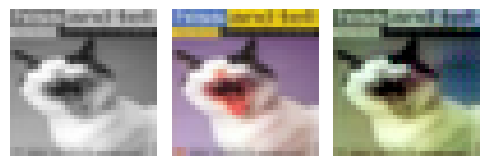

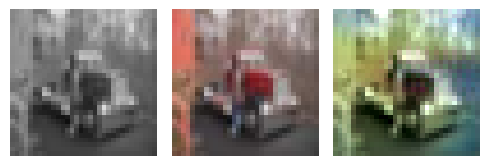

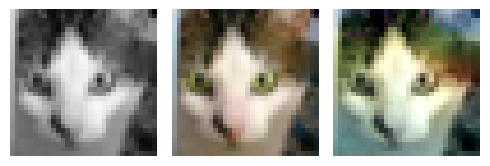

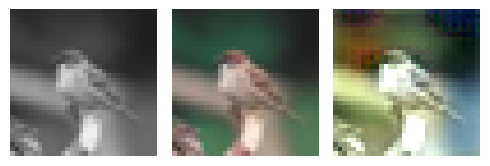

EPOCH: 48.760  trn_loss: 0.004  (5527.16s - 5808.23s remaining)

EPOCH: 48.765  trn_loss: 0.004  (5527.68s - 5807.59s remaining)

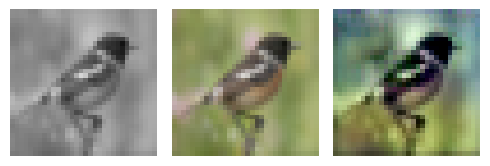

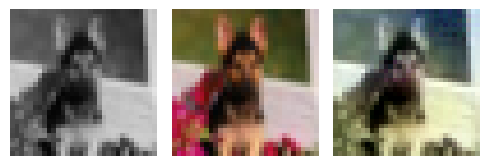

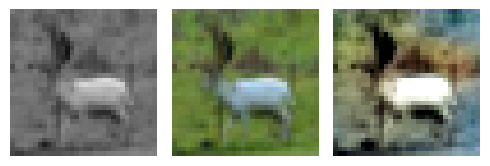

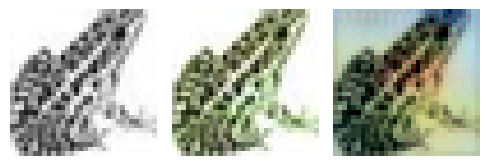

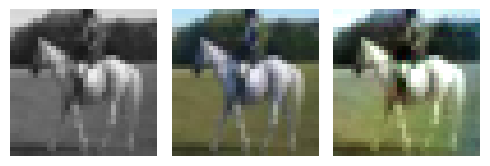

EPOCH: 49.000  val_loss: 0.003  (5560.06s - 5787.01s remaining)

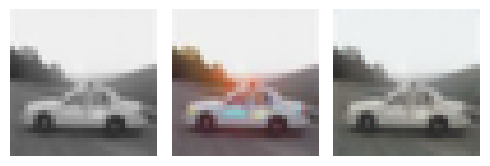

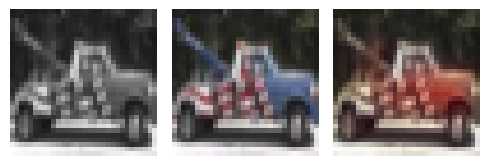

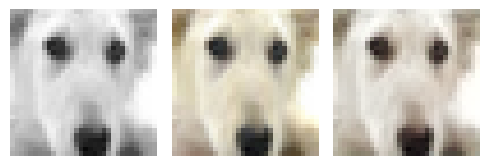

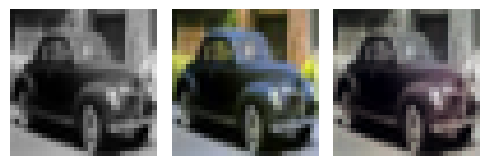

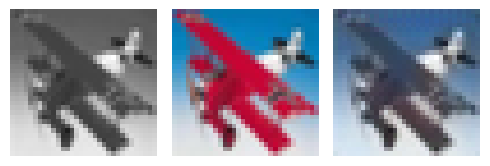

EPOCH: 49.250  trn_loss: 0.004  (5587.03s - 5757.20s remaining)

EPOCH: 49.255  trn_loss: 0.004  (5587.56s - 5756.56s remaining)

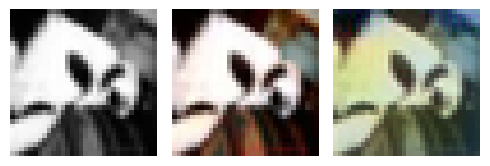

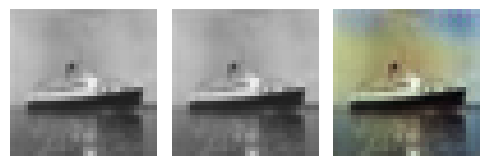

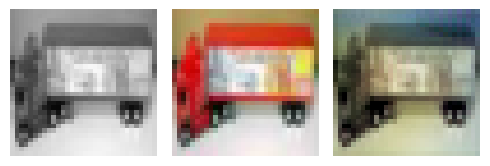

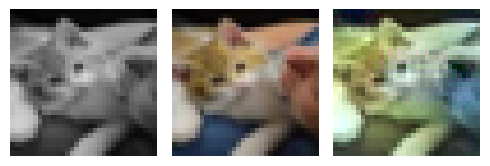

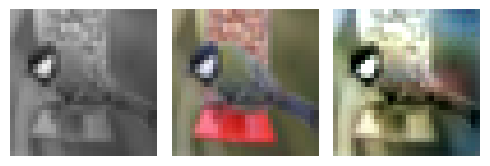

EPOCH: 49.505  trn_loss: 0.004  (5614.38s - 5726.63s remaining)

EPOCH: 49.510  trn_loss: 0.004  (5614.90s - 5726.00s remaining)

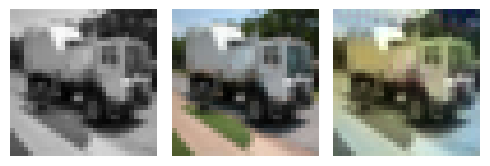

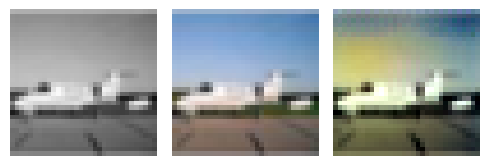

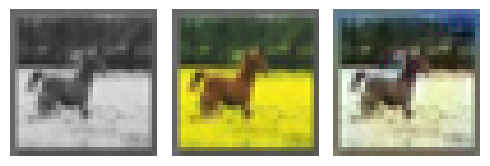

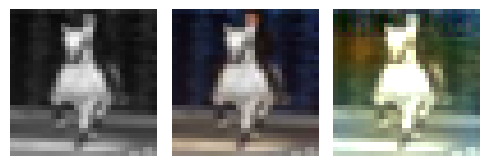

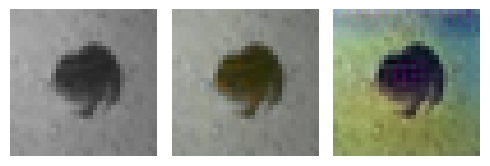

EPOCH: 49.760  trn_loss: 0.004  (5641.77s - 5696.14s remaining)

EPOCH: 49.765  trn_loss: 0.004  (5642.28s - 5695.50s remaining)

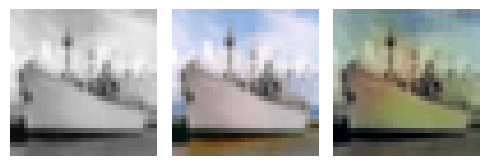

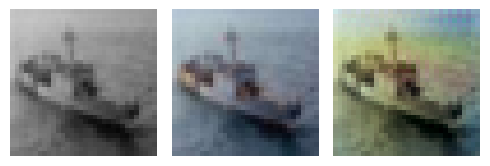

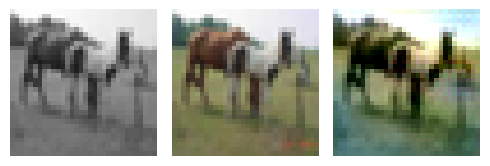

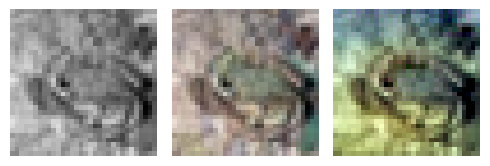

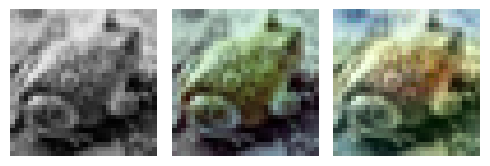

EPOCH: 50.000  trn_loss: 0.004  val_loss: 0.005  (5675.01s - 5675.01s remaining)


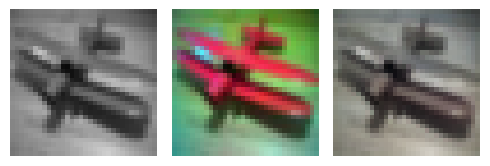

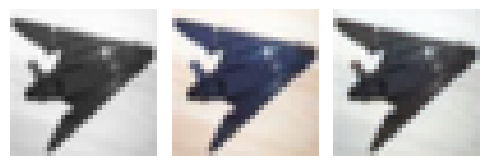

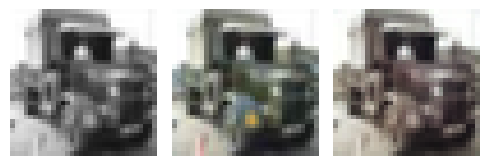

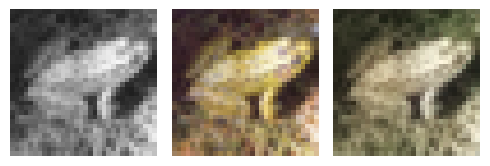

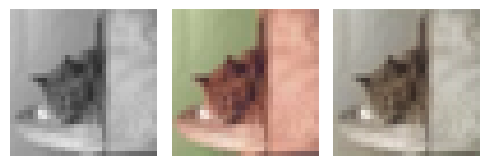

EPOCH: 50.250  trn_loss: 0.004  (5702.11s - 5645.38s remaining)

EPOCH: 50.255  trn_loss: 0.005  (5702.68s - 5644.78s remaining)

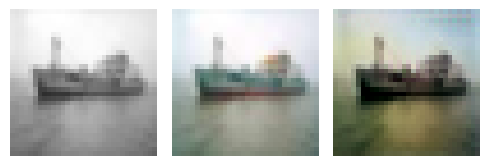

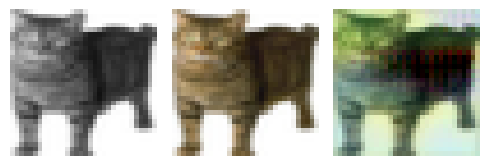

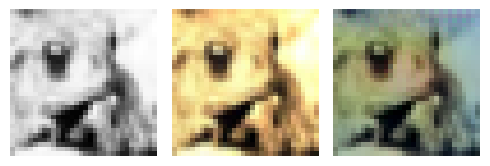

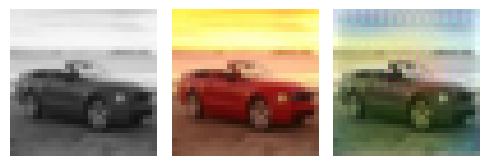

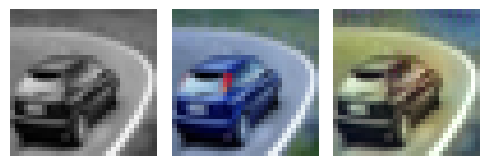

EPOCH: 50.505  trn_loss: 0.004  (5729.68s - 5615.07s remaining)

EPOCH: 50.510  trn_loss: 0.004  (5730.19s - 5614.43s remaining)

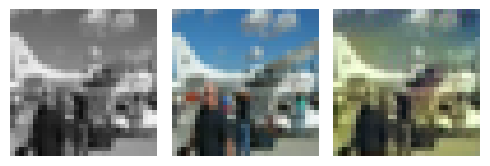

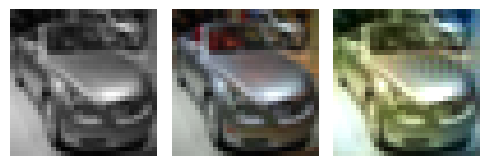

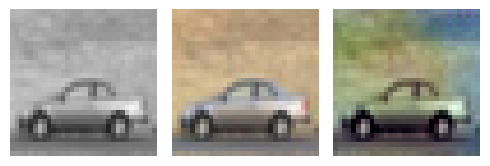

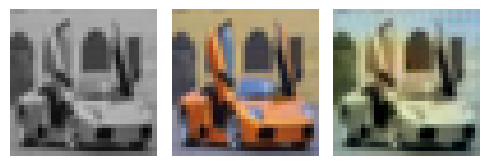

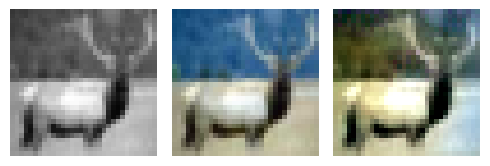

EPOCH: 50.760  trn_loss: 0.004  (5757.01s - 5584.58s remaining)

EPOCH: 50.765  trn_loss: 0.005  (5757.54s - 5583.94s remaining)

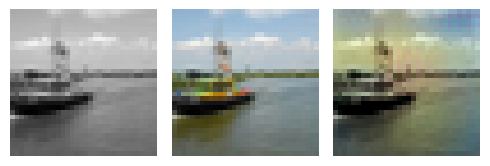

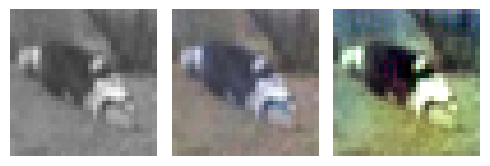

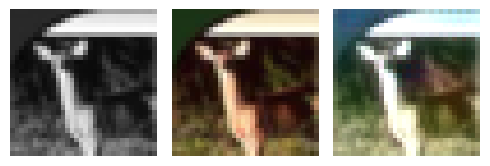

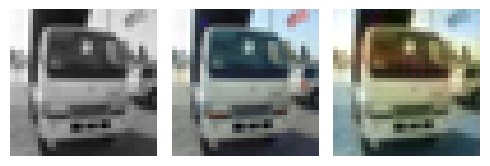

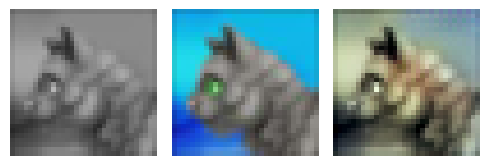

EPOCH: 51.000  val_loss: 0.003  (5789.92s - 5562.86s remaining)

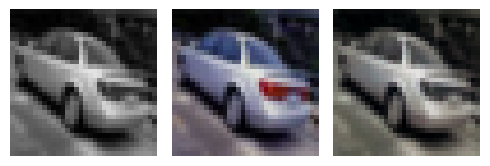

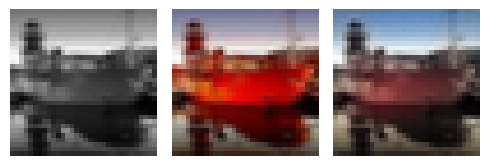

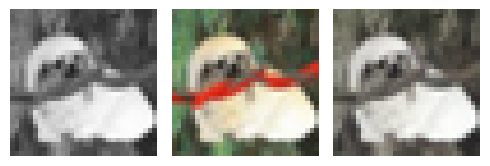

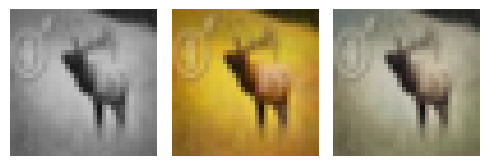

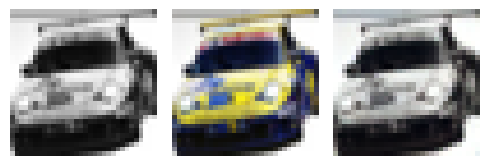

EPOCH: 51.255  trn_loss: 0.004  (5817.55s - 5532.64s remaining)

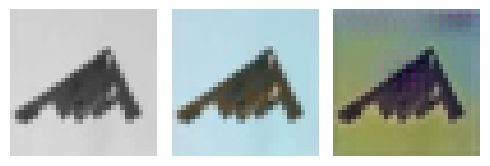

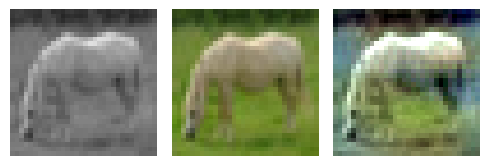

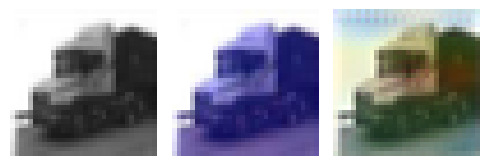

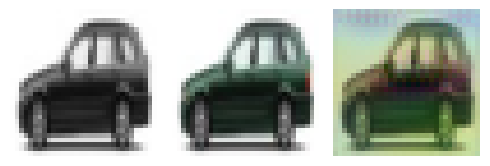

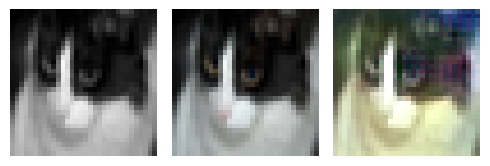

EPOCH: 51.505  trn_loss: 0.004  (5844.76s - 5503.16s remaining)

EPOCH: 51.510  trn_loss: 0.004  (5845.28s - 5502.53s remaining)

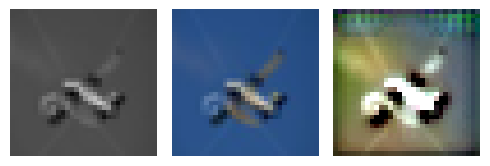

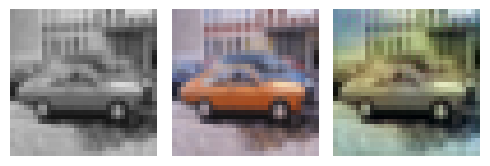

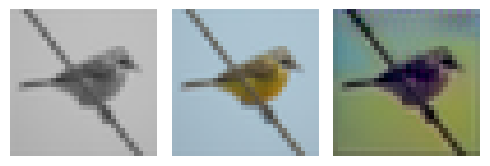

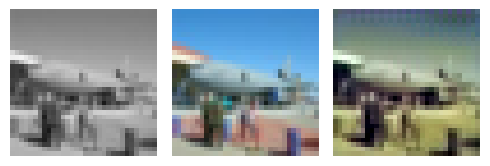

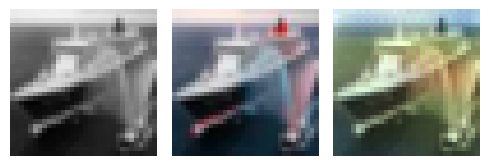

EPOCH: 51.760  trn_loss: 0.004  (5872.25s - 5472.85s remaining)

EPOCH: 51.765  trn_loss: 0.004  (5872.76s - 5472.22s remaining)

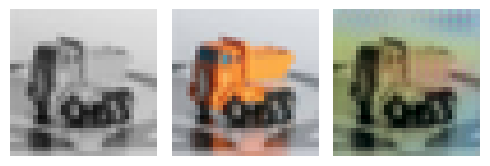

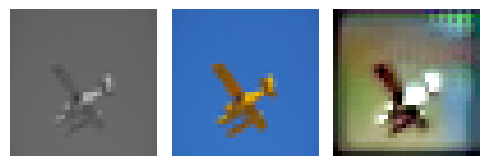

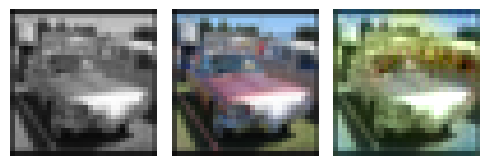

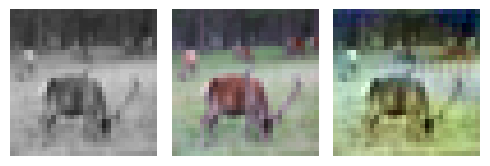

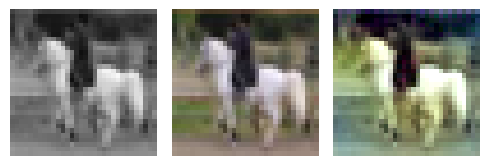

EPOCH: 52.000  val_loss: 0.003  (5906.37s - 5452.04s remaining)

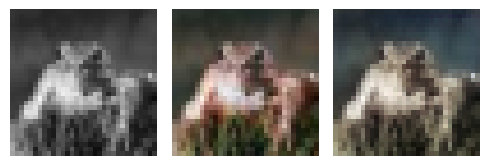

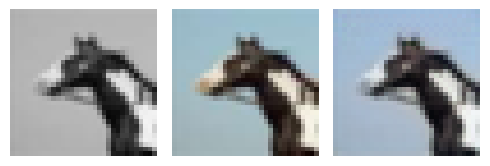

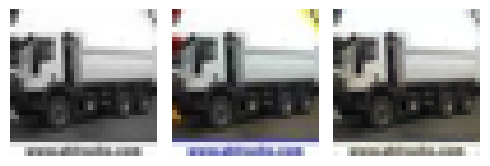

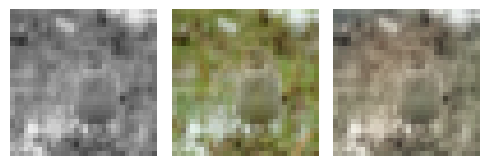

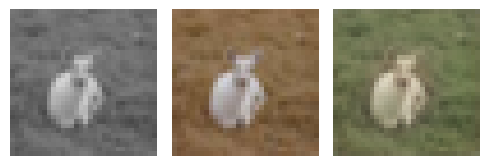

EPOCH: 52.250  trn_loss: 0.005  (5933.18s - 5422.19s remaining)

EPOCH: 52.255  trn_loss: 0.004  (5933.71s - 5421.56s remaining)

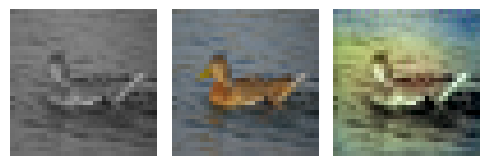

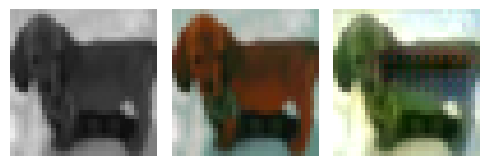

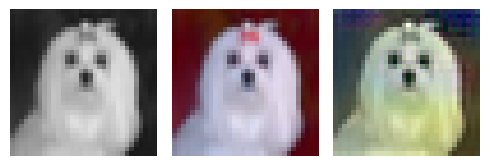

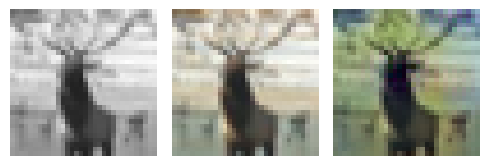

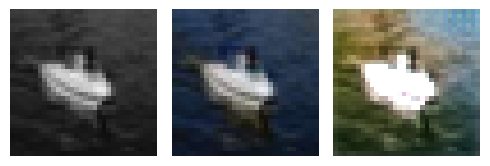

EPOCH: 52.505  trn_loss: 0.004  (5960.56s - 5391.79s remaining)

EPOCH: 52.510  trn_loss: 0.005  (5961.08s - 5391.15s remaining)

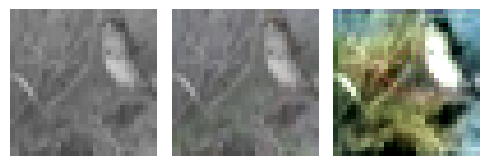

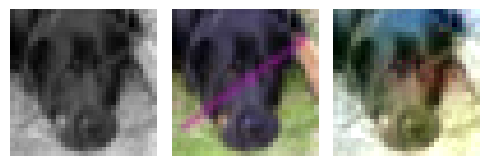

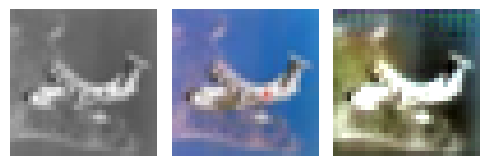

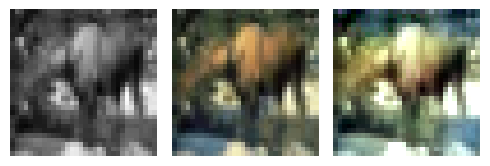

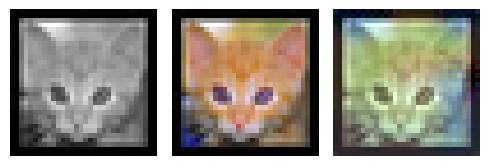

EPOCH: 52.760  trn_loss: 0.004  (5988.39s - 5361.81s remaining)

EPOCH: 52.765  trn_loss: 0.004  (5988.91s - 5361.18s remaining)

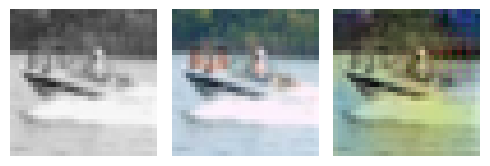

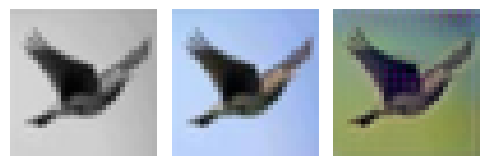

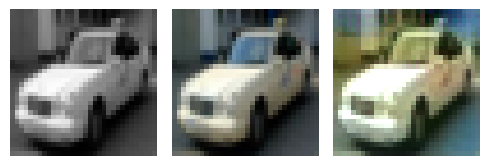

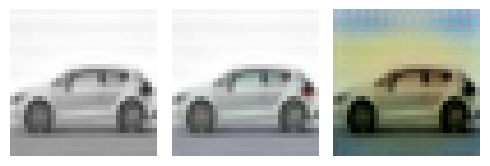

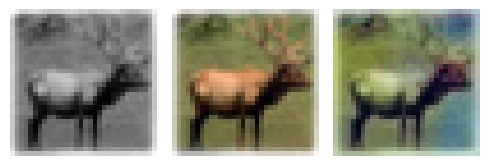

EPOCH: 53.000  val_loss: 0.003  (6021.29s - 5339.64s remaining)

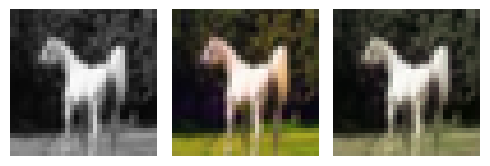

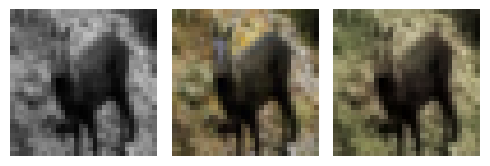

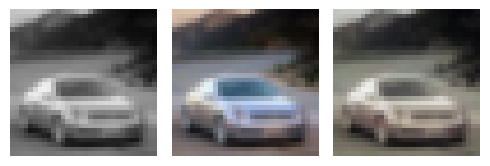

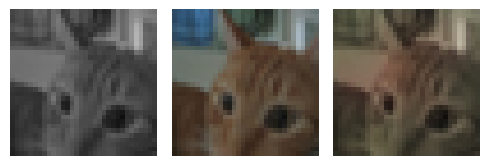

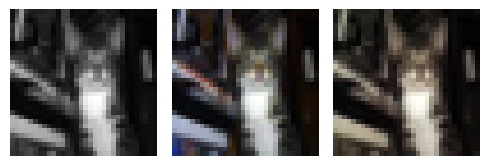

EPOCH: 53.250  trn_loss: 0.004  (6048.32s - 5310.03s remaining)

EPOCH: 53.255  trn_loss: 0.004  (6048.85s - 5309.40s remaining)

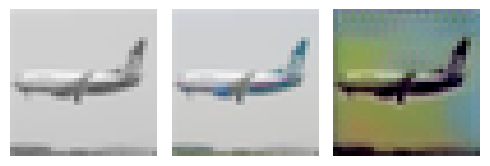

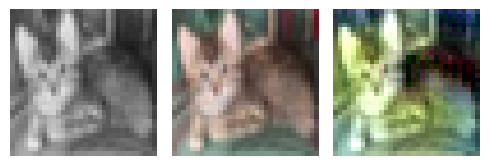

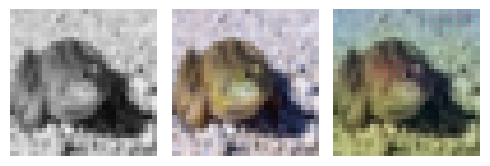

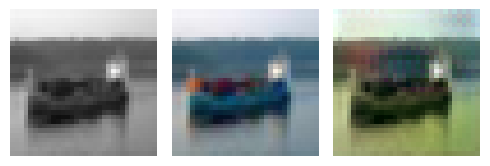

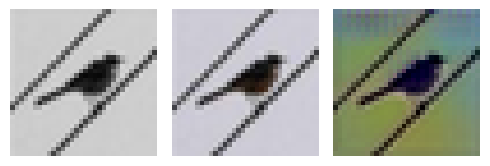

EPOCH: 53.510  trn_loss: 0.004  (6076.22s - 5279.03s remaining)

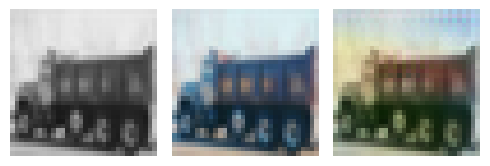

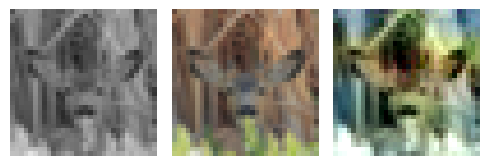

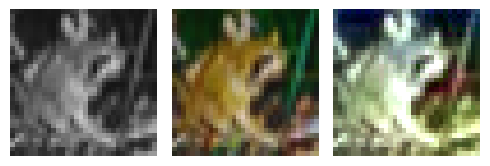

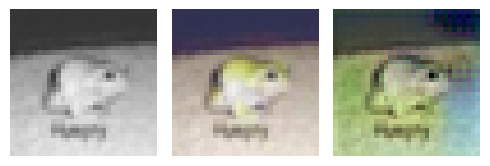

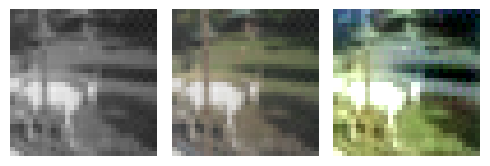

EPOCH: 53.760  trn_loss: 0.004  (6103.34s - 5249.55s remaining)

EPOCH: 53.765  trn_loss: 0.005  (6103.85s - 5248.92s remaining)

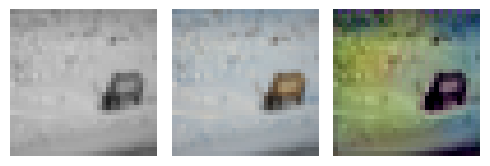

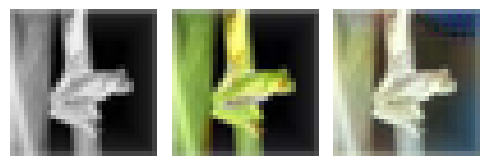

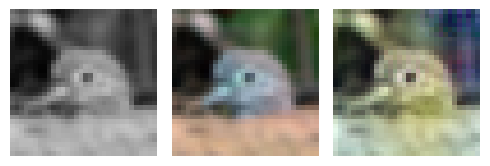

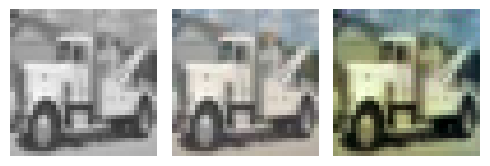

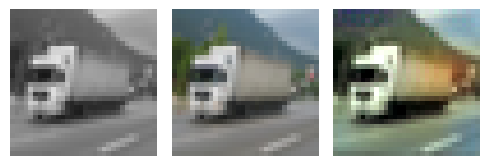

EPOCH: 53.925  val_loss: 0.005  (6135.95s - 5242.72s remaining)

EPOCH: 54.000  val_loss: 0.003  (6136.46s - 5227.35s remaining)

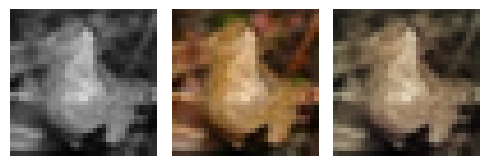

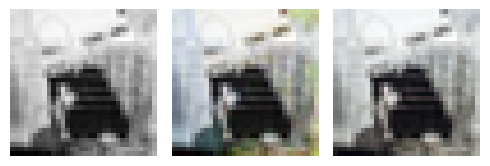

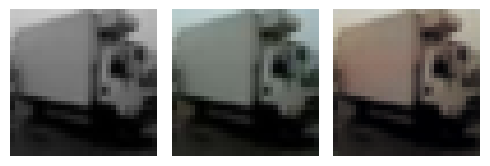

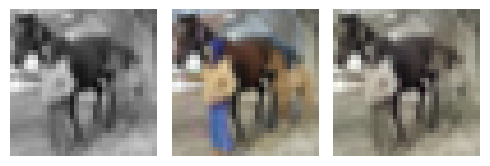

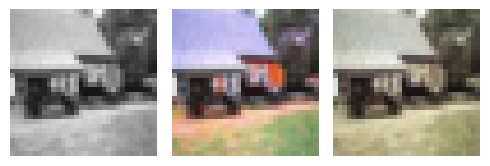

EPOCH: 54.245  trn_loss: 0.005  (6162.65s - 5198.15s remaining)

EPOCH: 54.255  trn_loss: 0.004  (6163.69s - 5196.88s remaining)

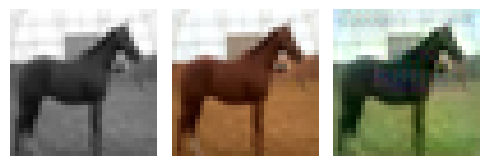

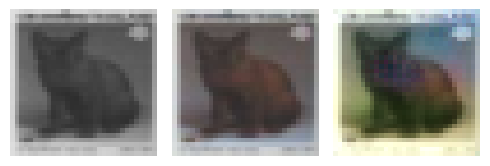

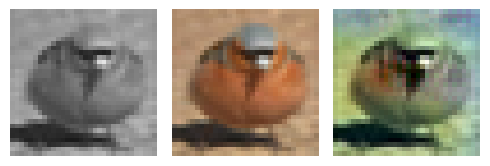

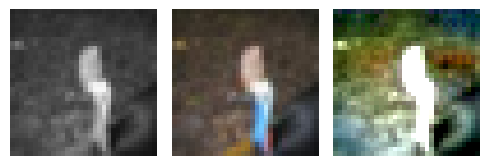

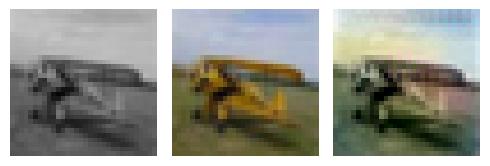

EPOCH: 54.510  trn_loss: 0.004  (6190.82s - 5166.35s remaining)

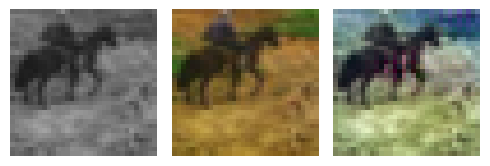

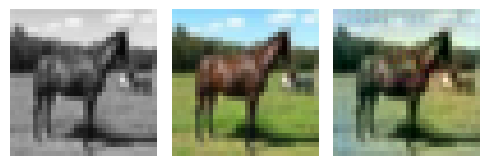

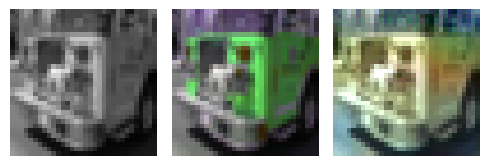

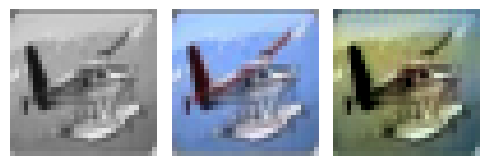

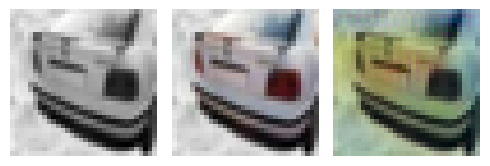

EPOCH: 54.760  trn_loss: 0.004  (6217.82s - 5136.82s remaining)

EPOCH: 54.765  trn_loss: 0.005  (6218.34s - 5136.18s remaining)

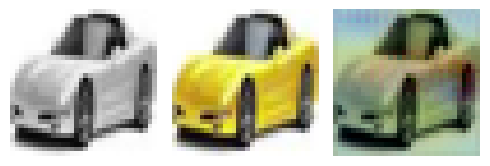

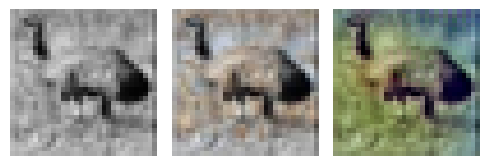

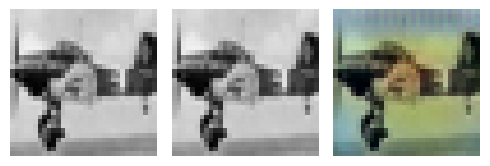

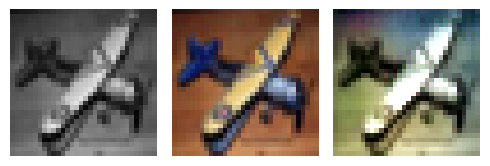

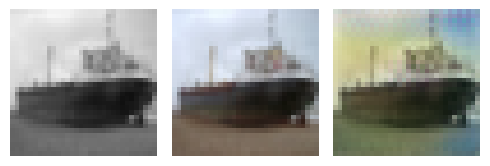

EPOCH: 55.000  trn_loss: 0.004  val_loss: 0.005  (6250.72s - 5114.22s remaining)


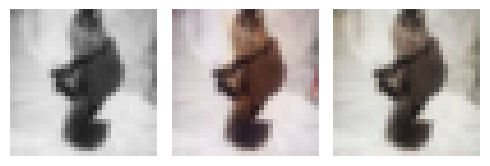

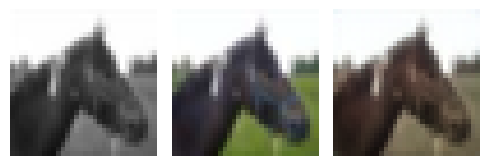

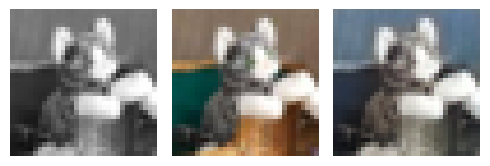

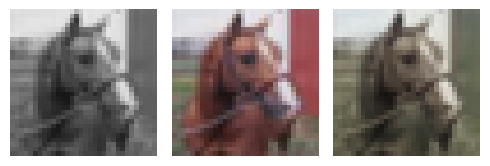

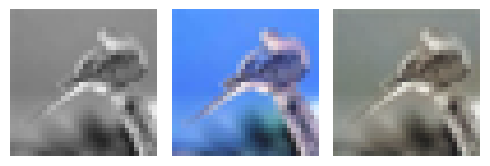

EPOCH: 55.250  trn_loss: 0.004  (6277.33s - 5084.35s remaining)

EPOCH: 55.255  trn_loss: 0.004  (6277.85s - 5083.73s remaining)

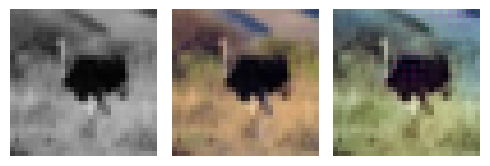

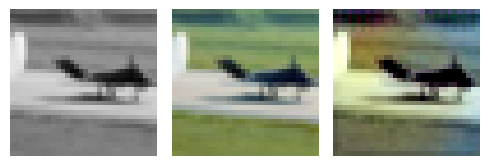

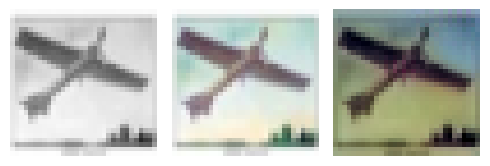

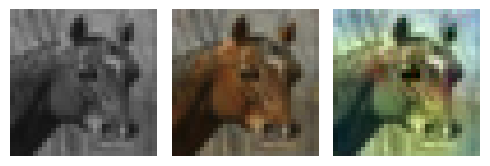

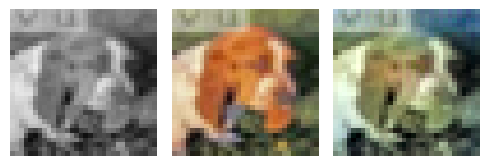

EPOCH: 55.505  trn_loss: 0.004  (6305.12s - 5054.41s remaining)

EPOCH: 55.510  trn_loss: 0.004  (6305.64s - 5053.79s remaining)

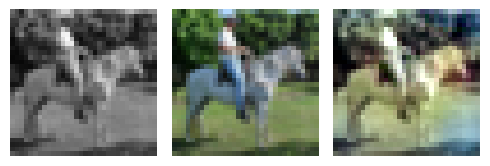

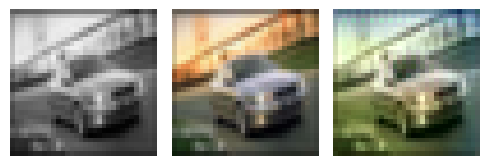

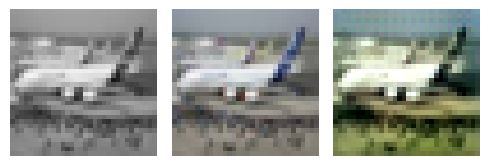

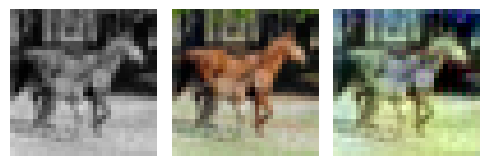

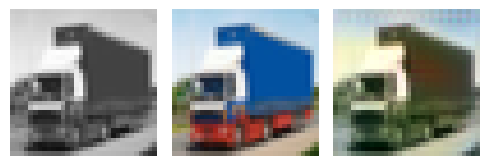

EPOCH: 55.760  trn_loss: 0.004  (6332.56s - 5024.21s remaining)

EPOCH: 55.765  trn_loss: 0.004  (6333.09s - 5023.59s remaining)

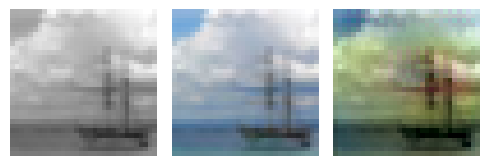

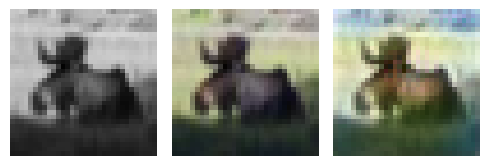

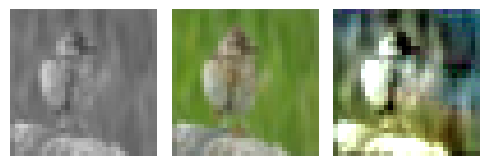

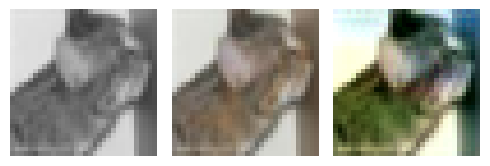

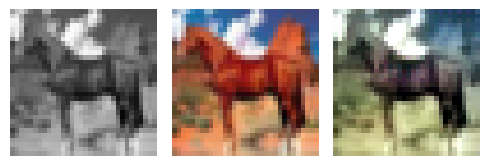

EPOCH: 56.000  val_loss: 0.003  (6365.68s - 5001.61s remaining)

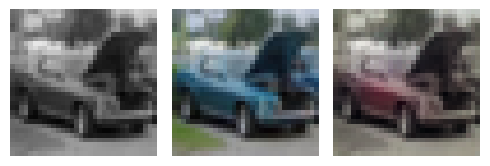

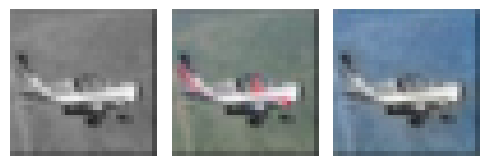

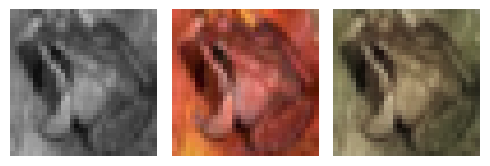

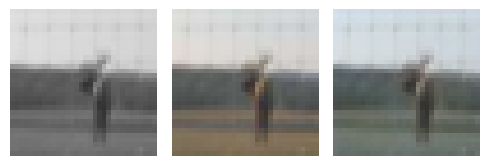

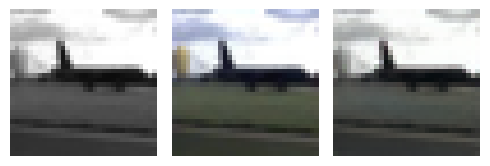

EPOCH: 56.250  trn_loss: 0.004  (6392.53s - 4971.97s remaining)

EPOCH: 56.255  trn_loss: 0.005  (6393.05s - 4971.34s remaining)

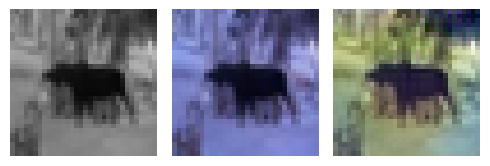

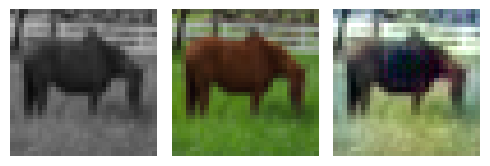

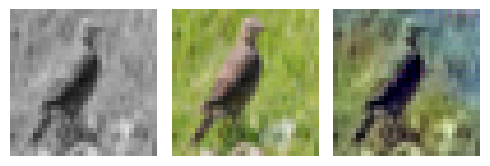

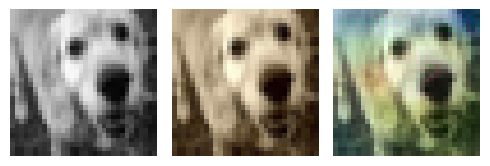

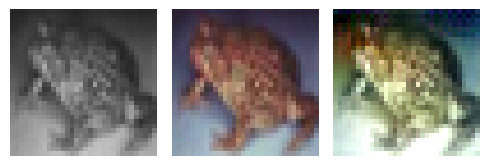

EPOCH: 56.505  trn_loss: 0.005  (6420.30s - 4942.04s remaining)

EPOCH: 56.510  trn_loss: 0.005  (6420.81s - 4941.41s remaining)

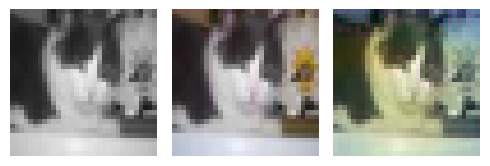

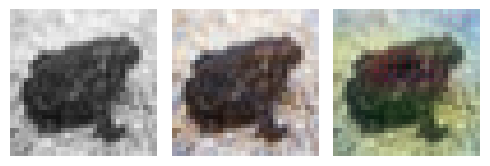

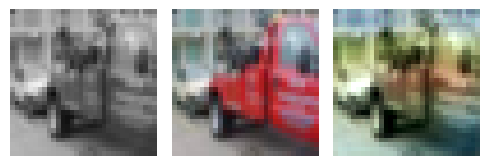

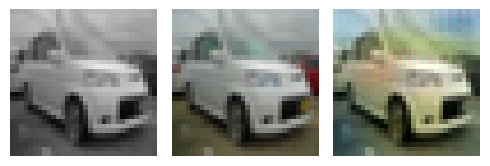

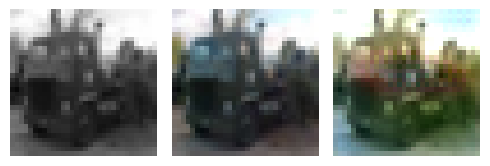

EPOCH: 56.760  trn_loss: 0.004  (6447.65s - 4911.80s remaining)

EPOCH: 56.765  trn_loss: 0.004  (6448.17s - 4911.18s remaining)

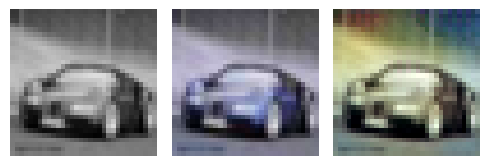

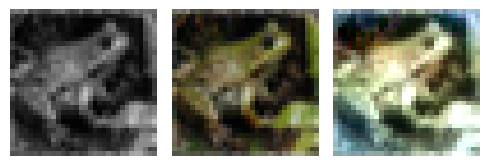

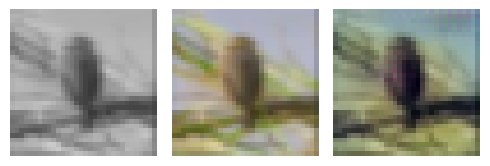

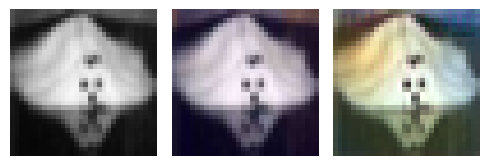

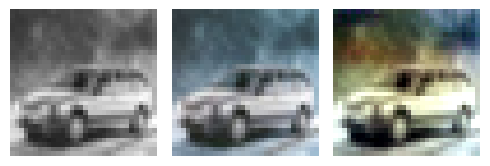

EPOCH: 57.000  val_loss: 0.003  (6480.72s - 4888.96s remaining)

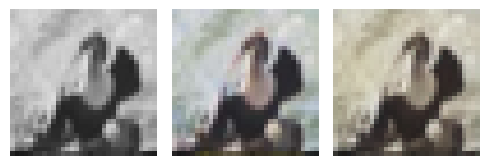

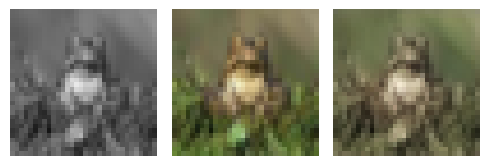

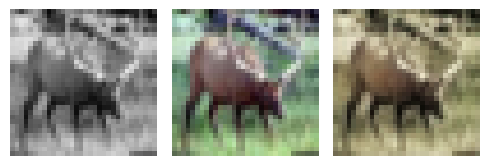

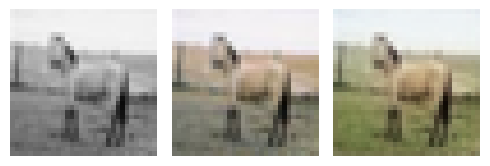

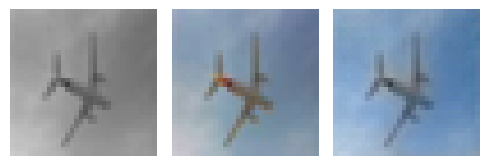

EPOCH: 57.250  trn_loss: 0.004  (6507.66s - 4859.43s remaining)

EPOCH: 57.255  trn_loss: 0.004  (6508.18s - 4858.80s remaining)

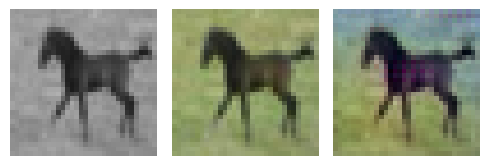

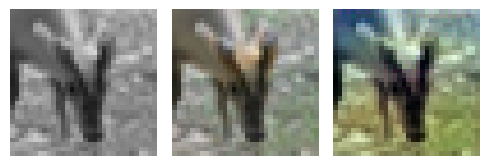

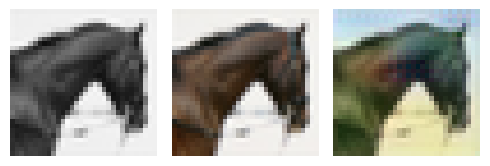

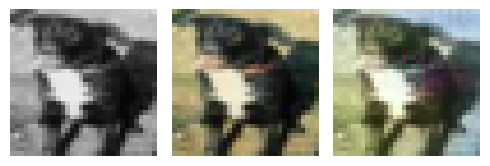

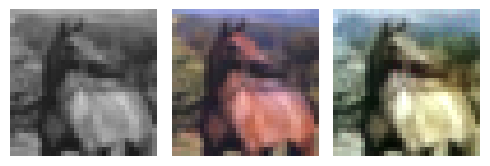

EPOCH: 57.505  trn_loss: 0.004  (6535.12s - 4829.30s remaining)

EPOCH: 57.510  trn_loss: 0.005  (6535.63s - 4828.67s remaining)

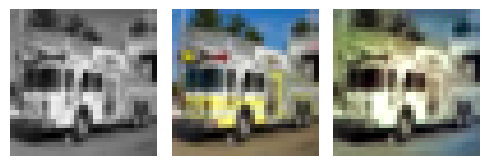

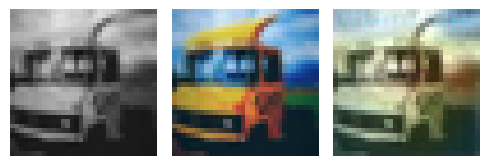

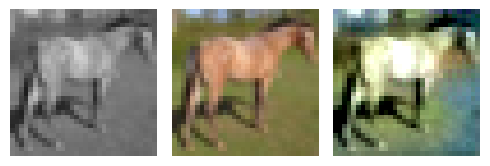

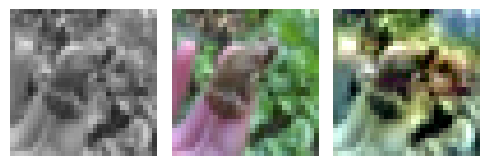

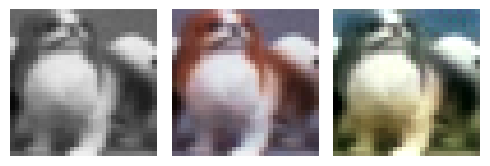

EPOCH: 57.760  trn_loss: 0.005  (6562.32s - 4799.00s remaining)

EPOCH: 57.765  trn_loss: 0.005  (6562.80s - 4798.35s remaining)

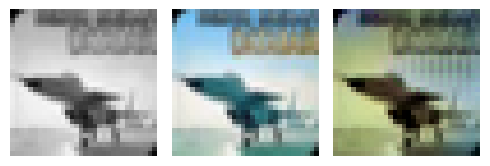

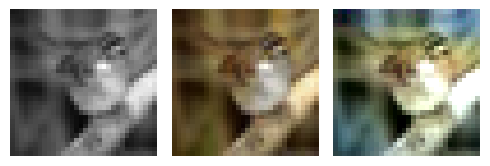

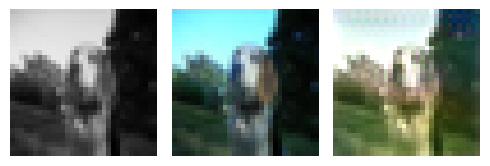

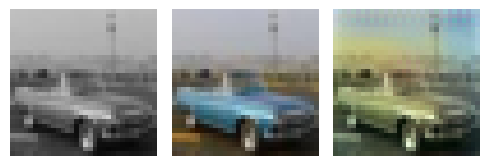

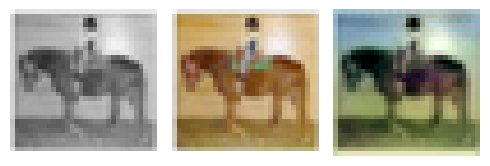

EPOCH: 57.950  val_loss: 0.005  (6594.73s - 4785.30s remaining)

EPOCH: 58.000  val_loss: 0.003  (6594.94s - 4775.64s remaining)

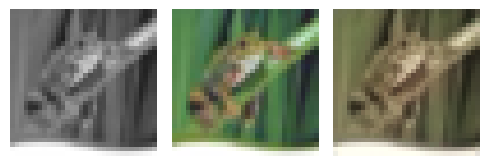

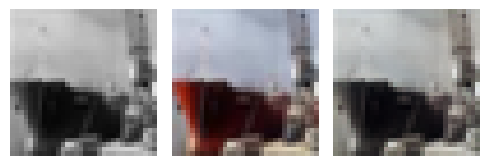

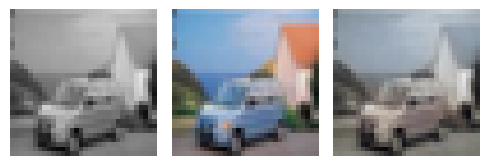

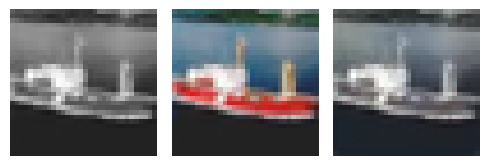

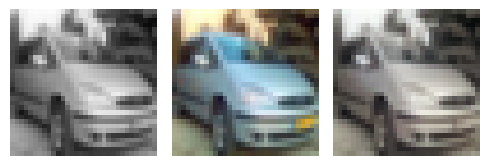

EPOCH: 58.250  trn_loss: 0.004  (6621.95s - 4746.20s remaining)

EPOCH: 58.255  trn_loss: 0.004  (6622.47s - 4745.58s remaining)

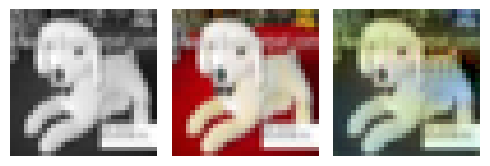

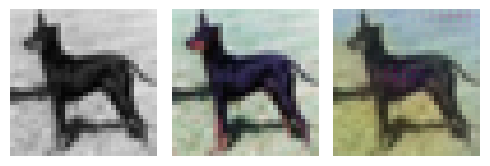

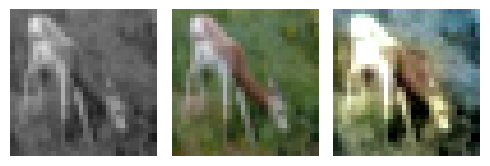

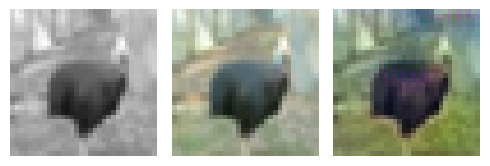

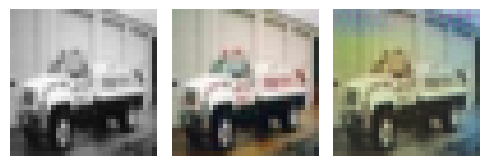

EPOCH: 58.505  trn_loss: 0.004  (6649.26s - 4716.01s remaining)

EPOCH: 58.510  trn_loss: 0.004  (6649.79s - 4715.39s remaining)

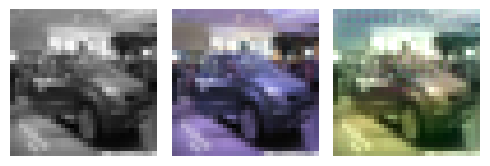

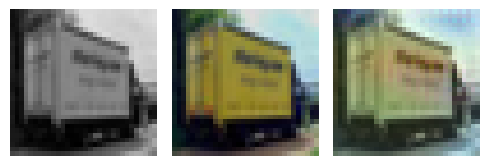

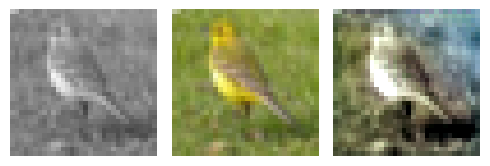

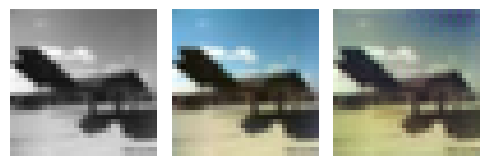

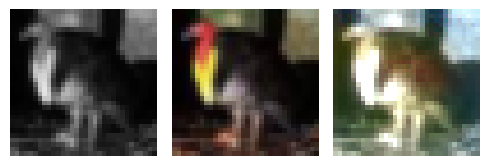

EPOCH: 58.765  trn_loss: 0.004  (6676.98s - 4685.13s remaining)

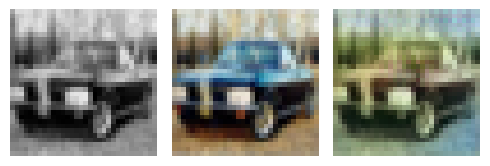

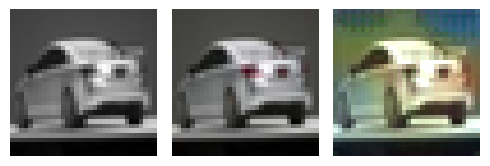

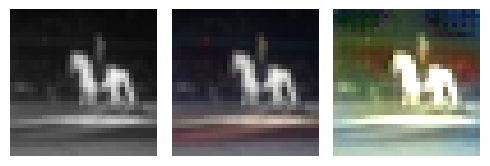

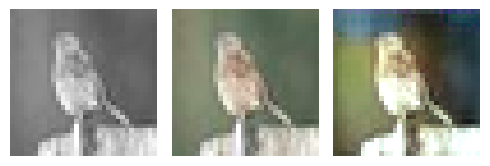

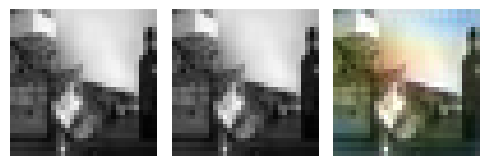

EPOCH: 58.975  val_loss: 0.005  (6709.62s - 4667.44s remaining)

EPOCH: 59.000  val_loss: 0.003  (6709.65s - 4662.64s remaining)

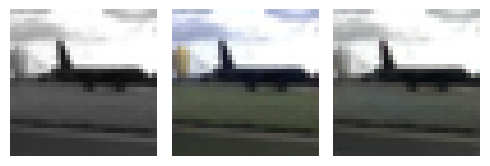

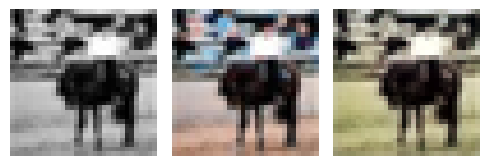

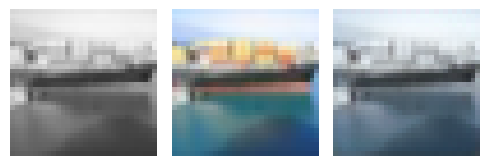

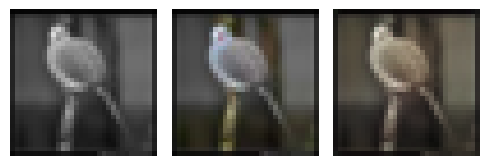

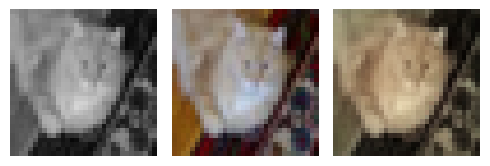

EPOCH: 59.250  trn_loss: 0.004  (6736.54s - 4633.15s remaining)

EPOCH: 59.255  trn_loss: 0.004  (6737.06s - 4632.53s remaining)

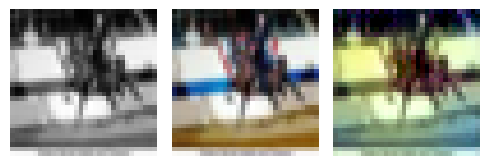

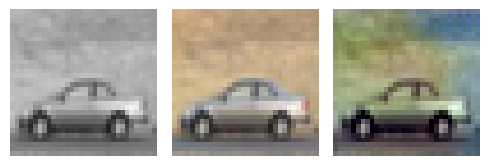

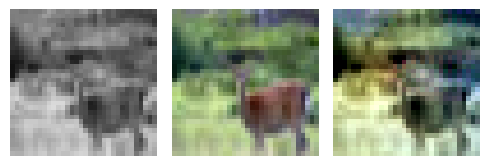

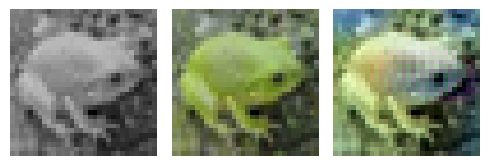

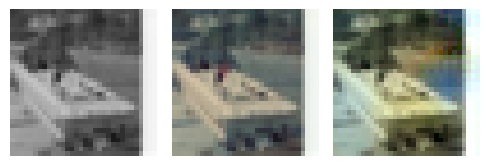

EPOCH: 59.505  trn_loss: 0.004  (6763.99s - 4603.09s remaining)

EPOCH: 59.510  trn_loss: 0.004  (6764.51s - 4602.47s remaining)

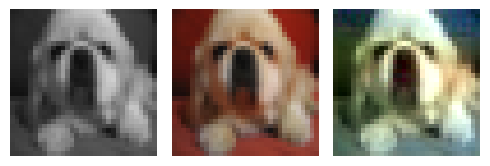

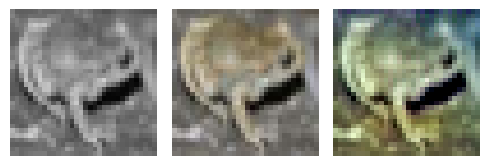

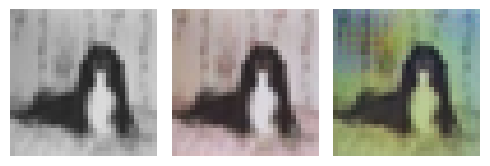

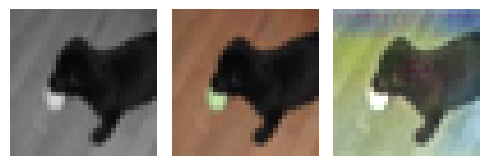

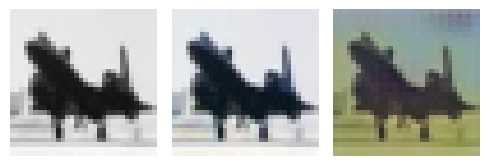

EPOCH: 59.755  trn_loss: 0.004  (6790.89s - 4573.65s remaining)

EPOCH: 59.765  trn_loss: 0.004  (6791.93s - 4572.41s remaining)

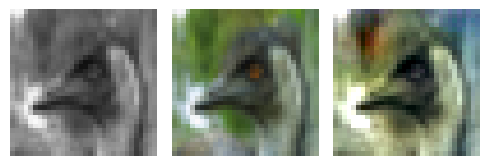

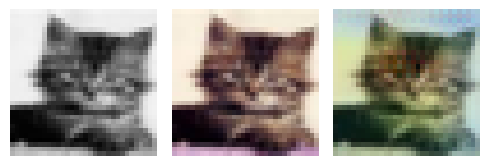

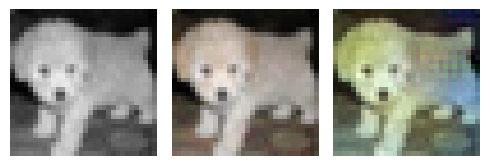

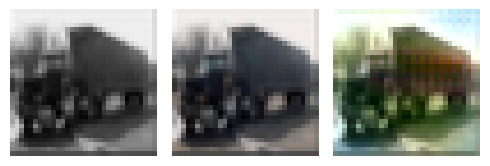

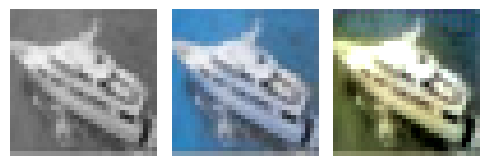

EPOCH: 59.975  val_loss: 0.005  (6824.51s - 4554.41s remaining)

EPOCH: 60.000  trn_loss: 0.004  val_loss: 0.005  (6824.54s - 4549.69s remaining)


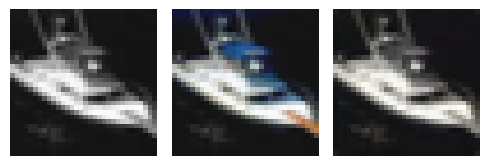

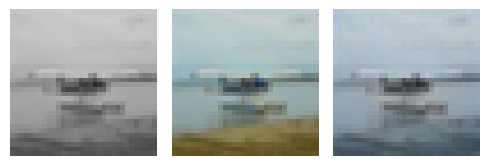

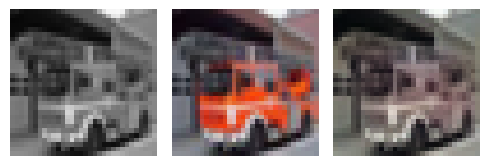

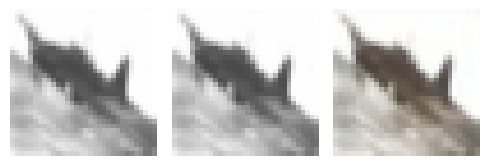

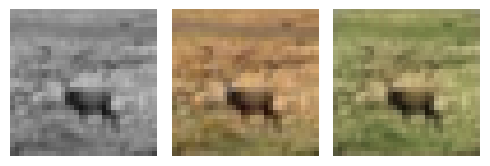

EPOCH: 60.250  trn_loss: 0.004  (6851.42s - 4520.23s remaining)

EPOCH: 60.255  trn_loss: 0.004  (6851.93s - 4519.61s remaining)

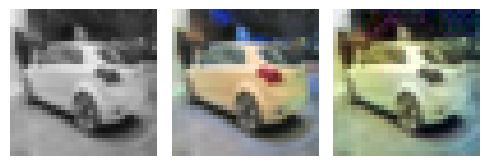

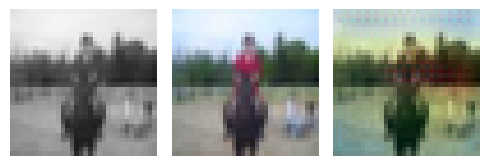

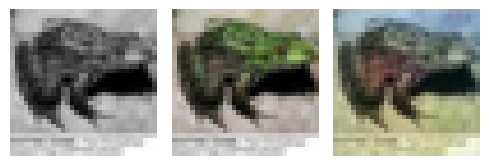

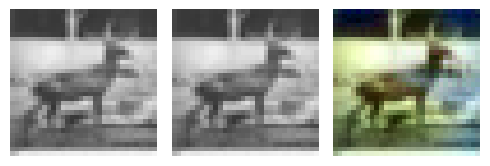

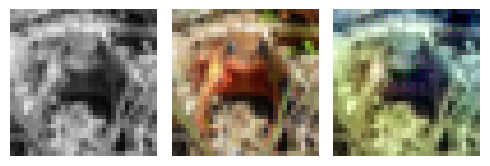

EPOCH: 60.510  trn_loss: 0.004  (6879.36s - 4489.57s remaining)

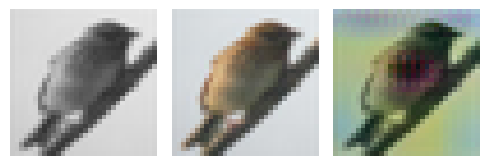

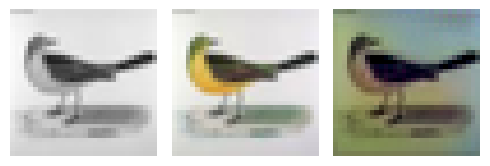

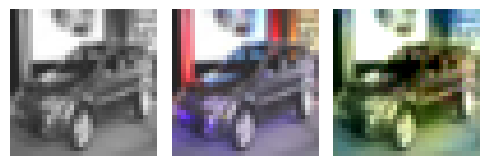

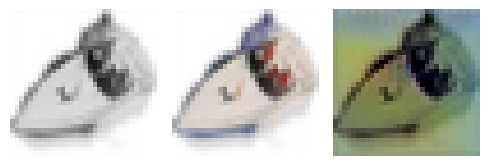

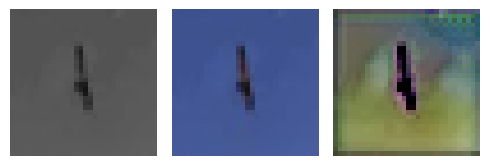

EPOCH: 60.760  trn_loss: 0.005  (6906.26s - 4460.16s remaining)

EPOCH: 60.765  trn_loss: 0.004  (6906.77s - 4459.53s remaining)

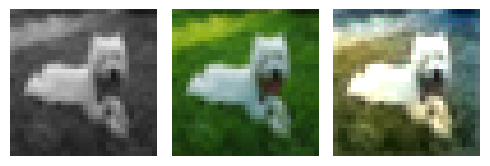

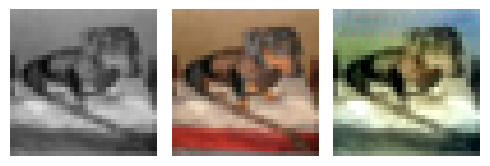

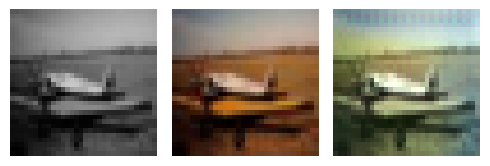

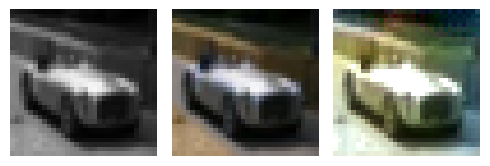

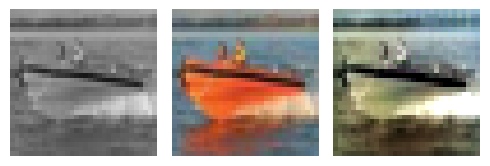

EPOCH: 60.975  val_loss: 0.005  (6938.99s - 4441.07s remaining)

EPOCH: 61.000  val_loss: 0.003  (6939.01s - 4436.42s remaining)

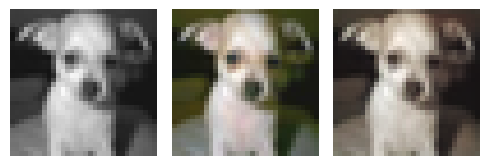

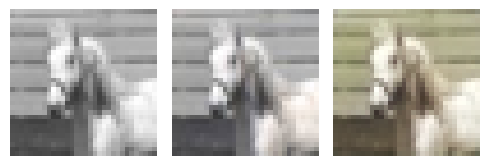

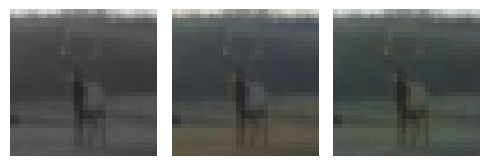

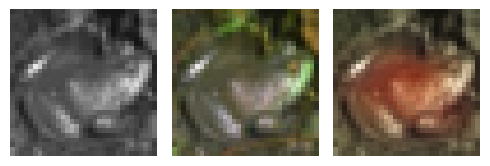

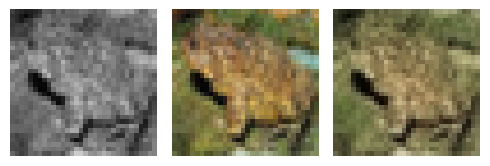

EPOCH: 61.255  trn_loss: 0.004  (6966.46s - 4406.41s remaining)

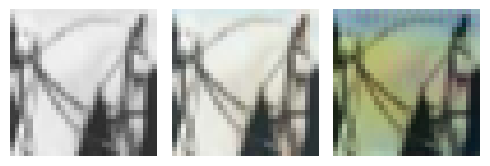

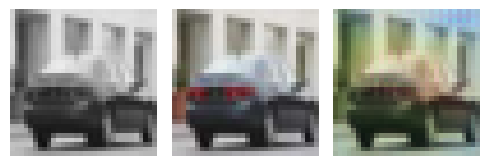

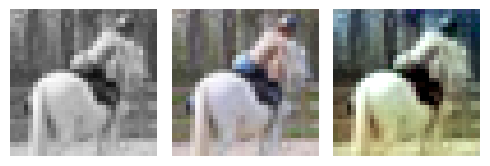

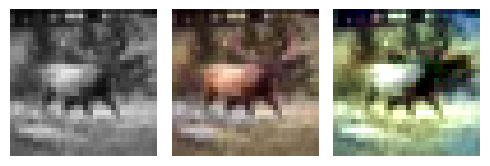

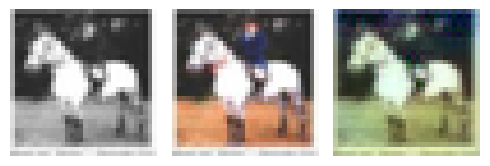

EPOCH: 61.510  trn_loss: 0.004  (6993.63s - 4376.24s remaining)

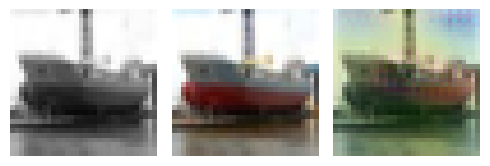

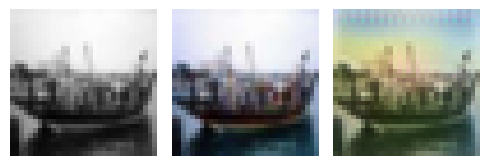

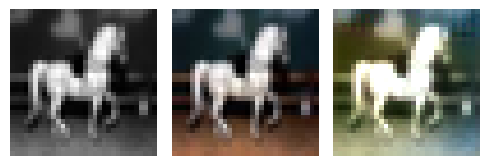

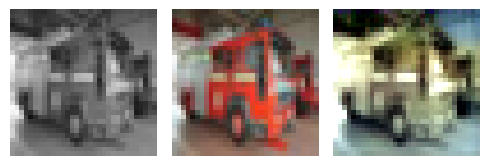

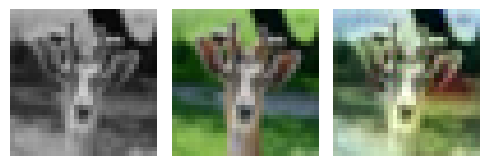

EPOCH: 61.765  trn_loss: 0.004  (7021.14s - 4346.31s remaining)

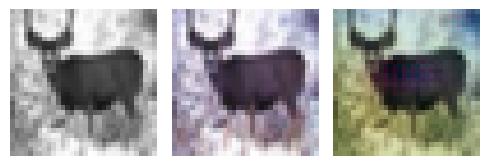

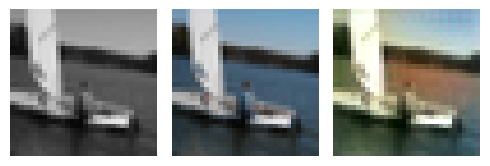

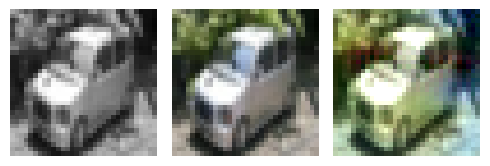

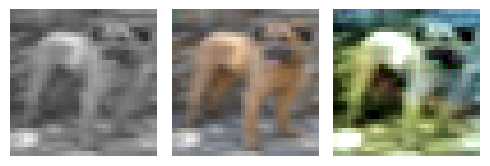

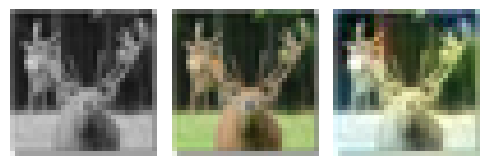

EPOCH: 61.950  val_loss: 0.005  (7053.38s - 4332.22s remaining)

EPOCH: 62.000  val_loss: 0.003  (7053.59s - 4323.17s remaining)

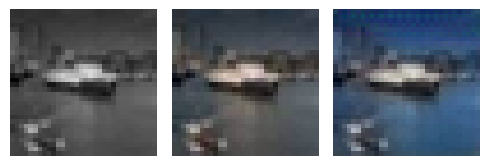

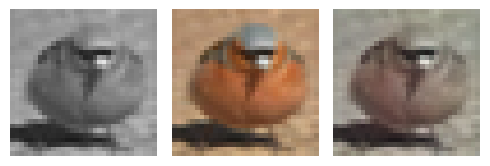

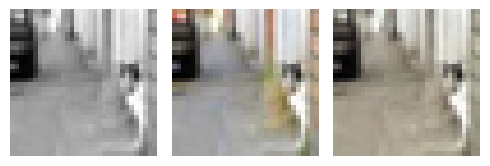

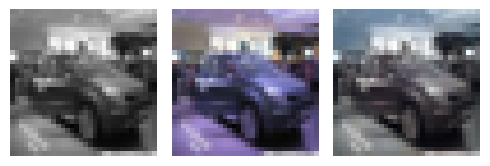

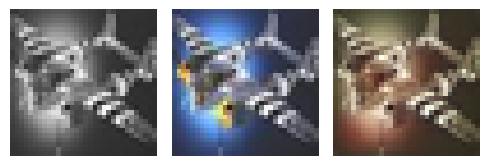

EPOCH: 62.245  trn_loss: 0.005  (7079.73s - 4294.26s remaining)

EPOCH: 62.255  trn_loss: 0.005  (7080.73s - 4293.01s remaining)

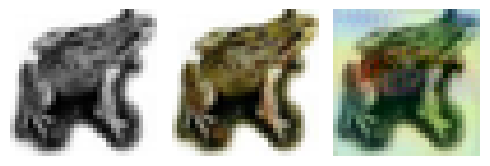

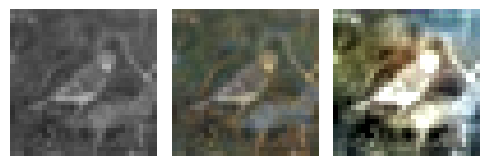

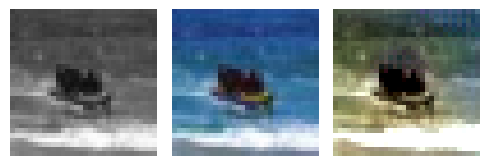

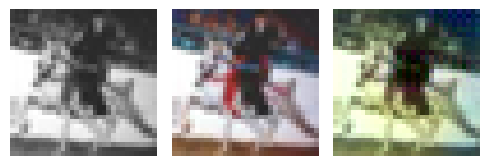

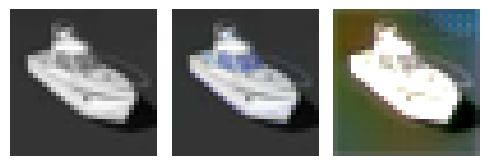

EPOCH: 62.510  trn_loss: 0.005  (7108.54s - 4263.27s remaining)

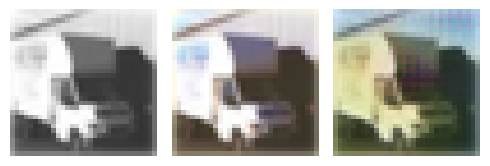

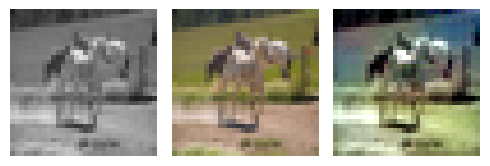

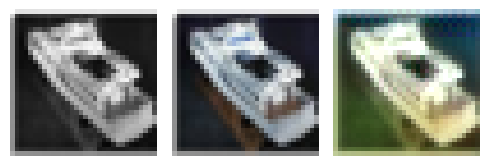

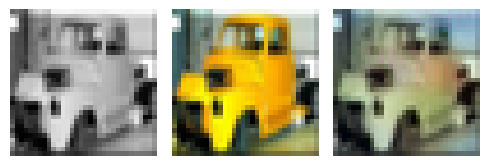

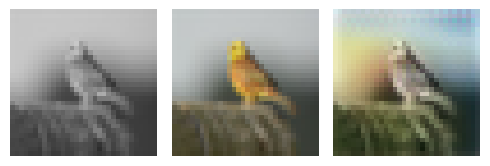

EPOCH: 62.760  trn_loss: 0.004  (7135.26s - 4233.82s remaining)

EPOCH: 62.765  trn_loss: 0.004  (7135.74s - 4233.19s remaining)

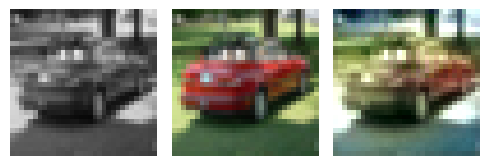

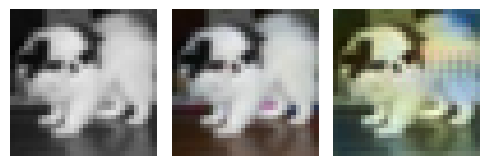

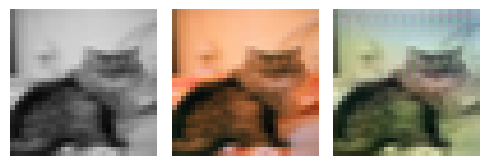

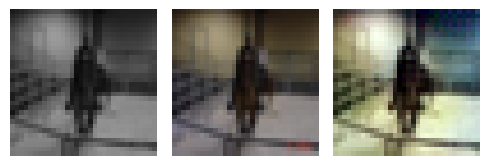

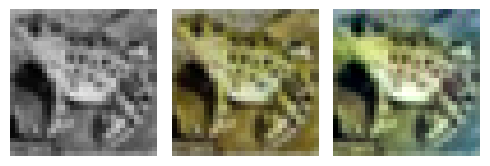

EPOCH: 63.000  val_loss: 0.003  (7168.40s - 4210.01s remaining)

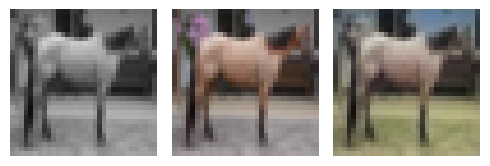

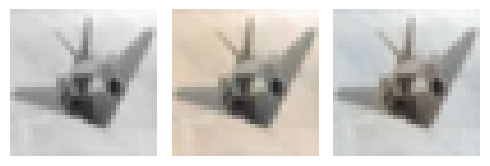

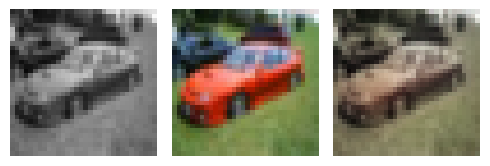

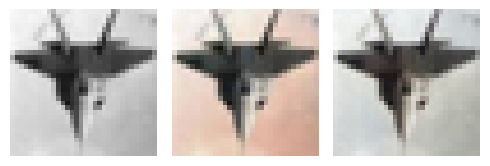

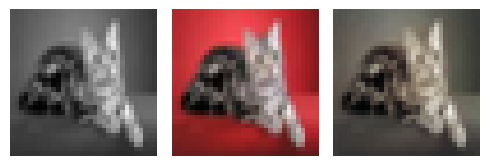

EPOCH: 63.250  trn_loss: 0.004  (7195.17s - 4180.59s remaining)

EPOCH: 63.255  trn_loss: 0.004  (7195.69s - 4179.98s remaining)

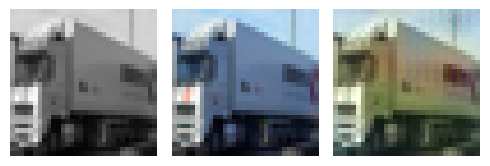

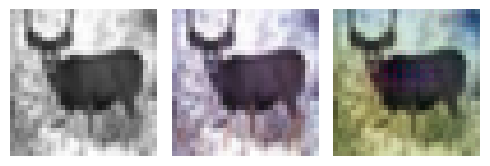

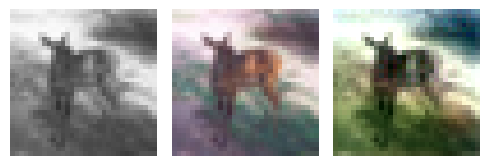

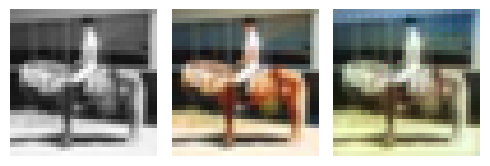

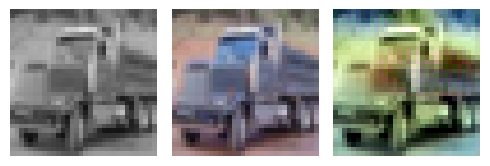

EPOCH: 63.500  trn_loss: 0.004  (7222.16s - 4151.32s remaining)

EPOCH: 63.510  trn_loss: 0.005  (7223.20s - 4150.09s remaining)

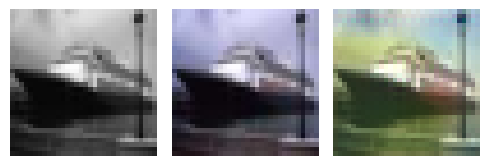

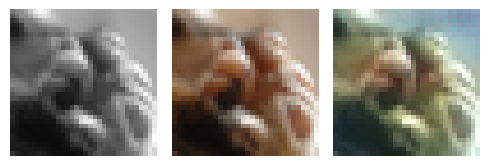

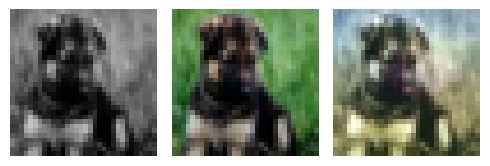

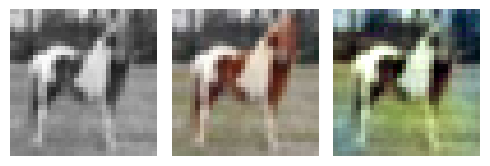

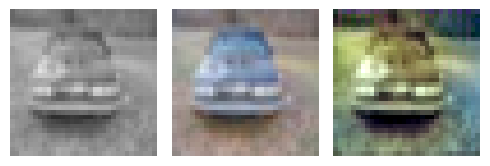

EPOCH: 63.760  trn_loss: 0.005  (7250.04s - 4120.75s remaining)

EPOCH: 63.765  trn_loss: 0.004  (7250.53s - 4120.12s remaining)

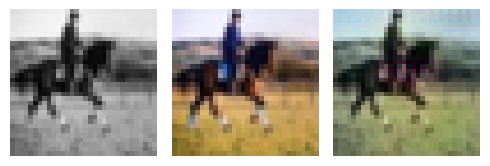

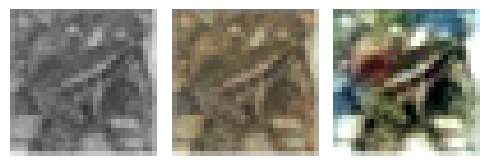

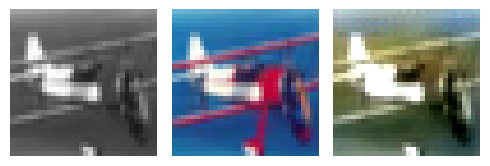

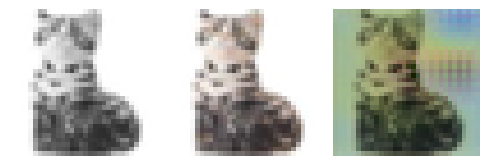

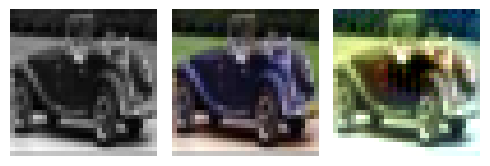

EPOCH: 64.000  val_loss: 0.003  (7283.04s - 4096.71s remaining)

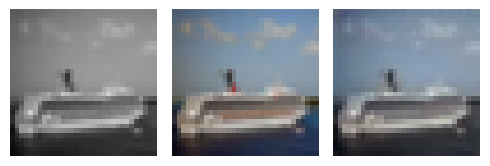

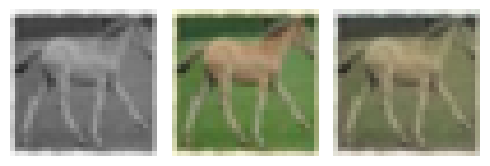

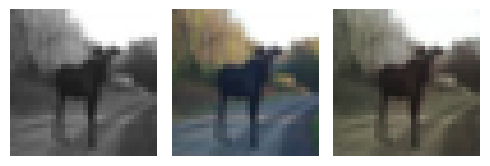

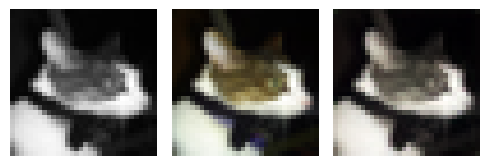

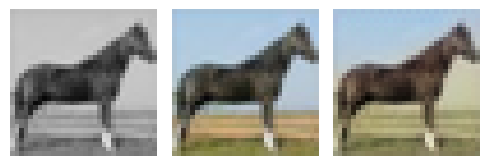

EPOCH: 64.250  trn_loss: 0.004  (7310.15s - 4067.51s remaining)

EPOCH: 64.255  trn_loss: 0.004  (7310.64s - 4066.89s remaining)

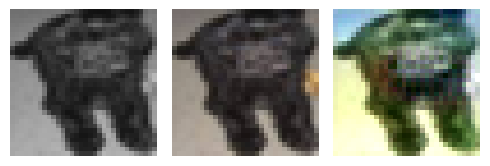

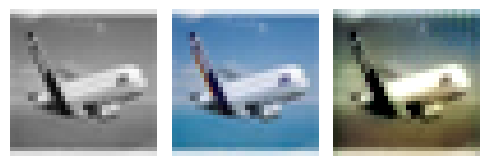

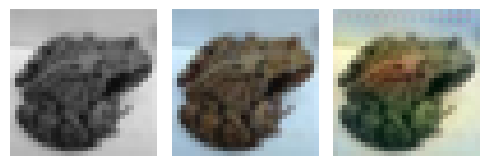

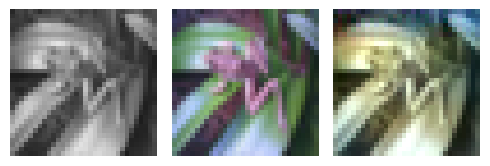

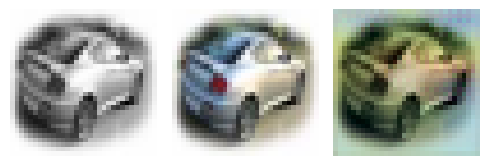

EPOCH: 64.505  trn_loss: 0.005  (7337.43s - 4037.53s remaining)

EPOCH: 64.510  trn_loss: 0.004  (7337.95s - 4036.92s remaining)

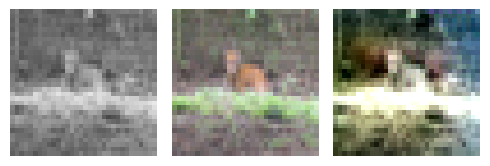

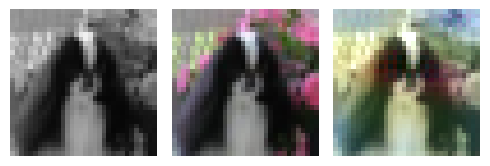

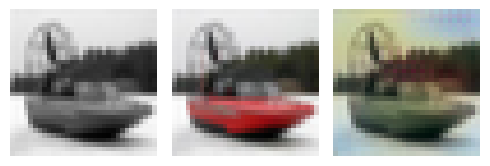

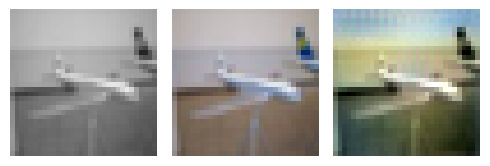

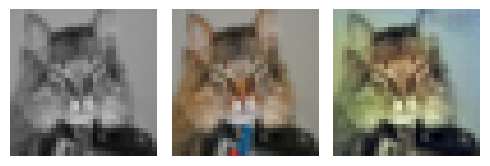

EPOCH: 64.760  trn_loss: 0.004  (7364.99s - 4007.72s remaining)

EPOCH: 64.765  trn_loss: 0.004  (7365.51s - 4007.11s remaining)

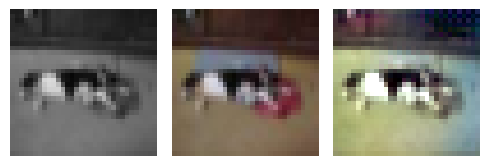

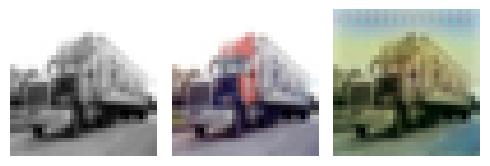

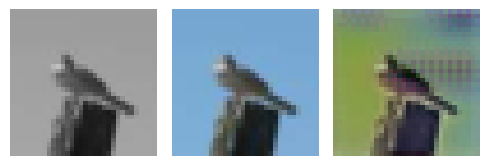

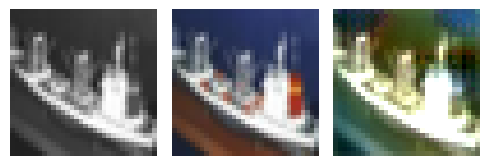

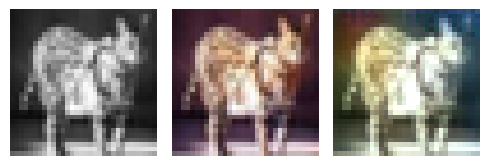

EPOCH: 65.000  trn_loss: 0.004  val_loss: 0.005  (7398.26s - 3983.68s remaining)


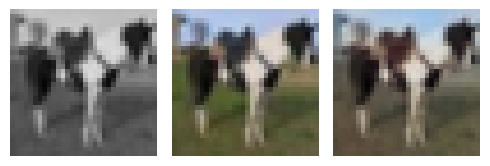

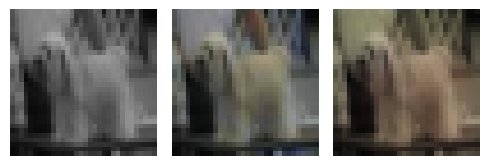

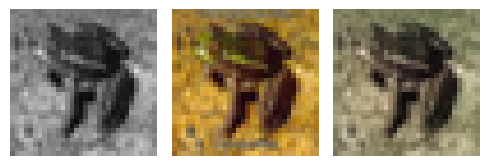

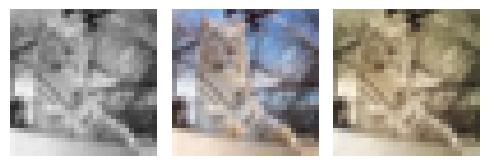

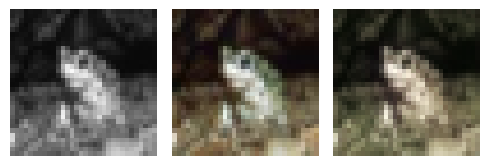

EPOCH: 65.250  trn_loss: 0.004  (7425.14s - 3954.39s remaining)

EPOCH: 65.255  trn_loss: 0.005  (7425.62s - 3953.75s remaining)

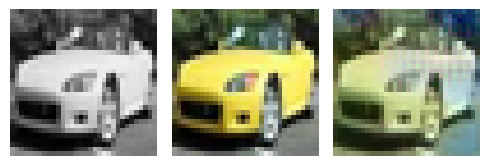

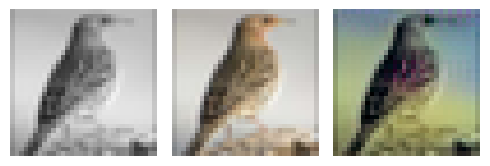

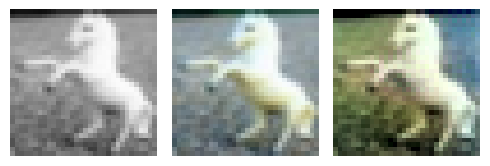

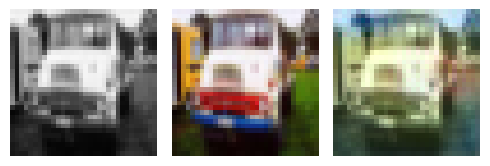

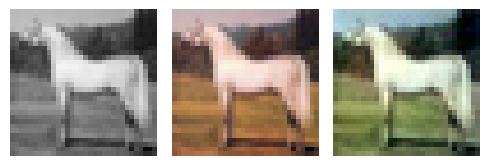

EPOCH: 65.505  trn_loss: 0.004  (7452.77s - 3924.62s remaining)

EPOCH: 65.510  trn_loss: 0.004  (7453.30s - 3924.01s remaining)

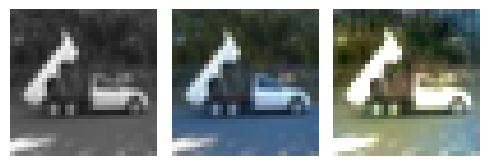

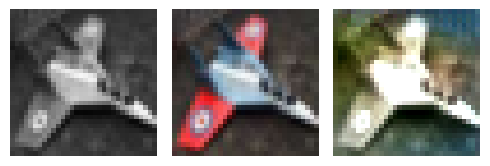

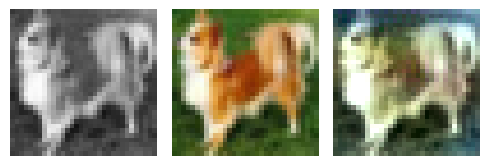

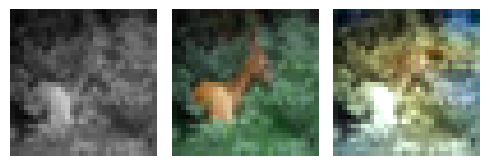

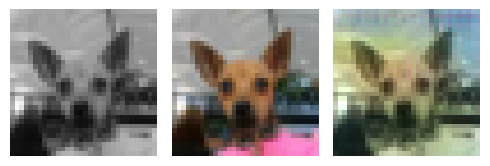

EPOCH: 65.760  trn_loss: 0.005  (7480.08s - 3894.70s remaining)

EPOCH: 65.765  trn_loss: 0.004  (7480.61s - 3894.10s remaining)

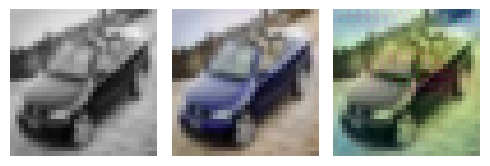

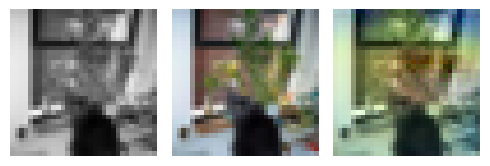

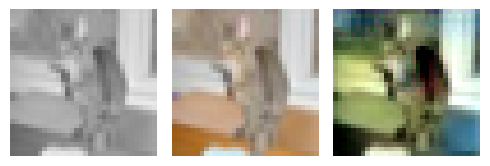

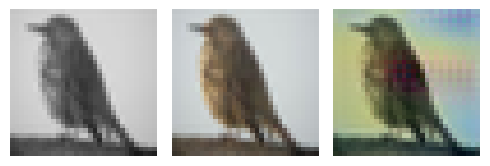

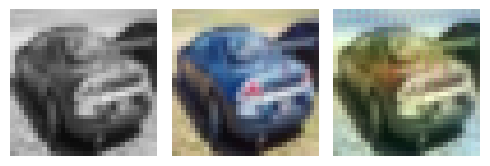

EPOCH: 66.000  val_loss: 0.003  (7513.35s - 3870.51s remaining)

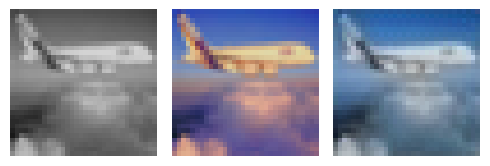

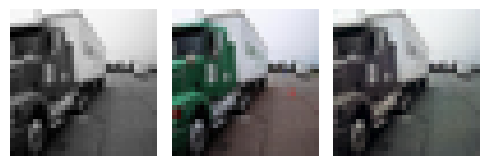

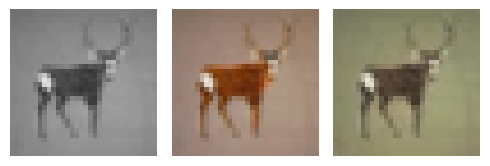

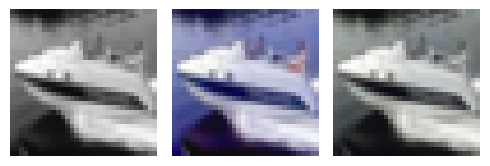

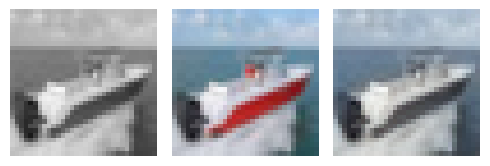

EPOCH: 66.245  trn_loss: 0.004  (7539.62s - 3841.82s remaining)

EPOCH: 66.255  trn_loss: 0.004  (7540.68s - 3840.60s remaining)

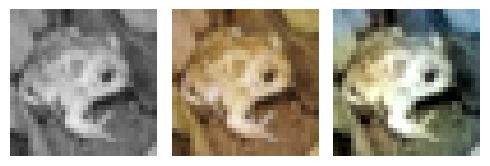

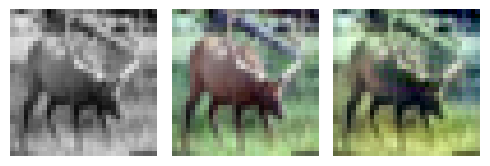

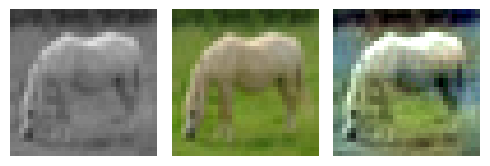

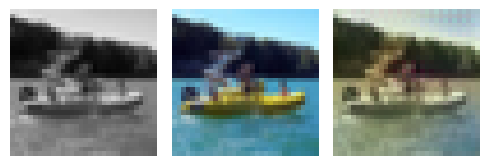

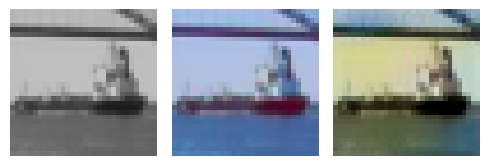

EPOCH: 66.505  trn_loss: 0.004  (7567.64s - 3811.40s remaining)

EPOCH: 66.510  trn_loss: 0.004  (7568.15s - 3810.78s remaining)

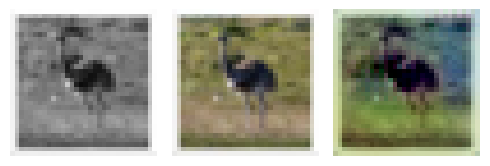

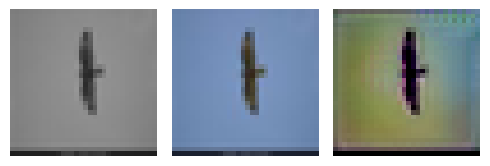

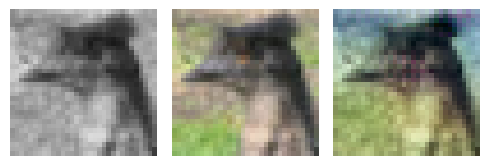

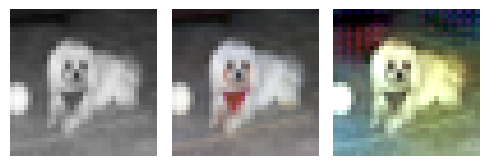

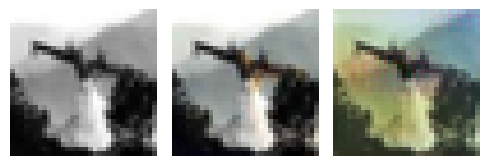

EPOCH: 66.765  trn_loss: 0.005  (7595.69s - 3781.01s remaining)

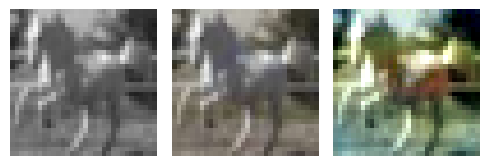

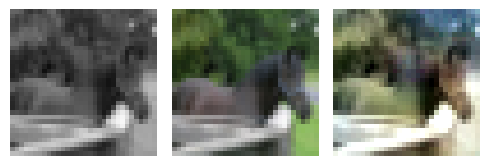

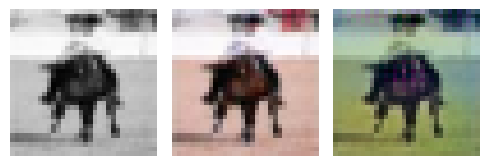

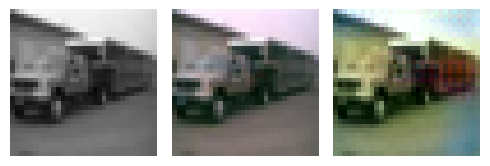

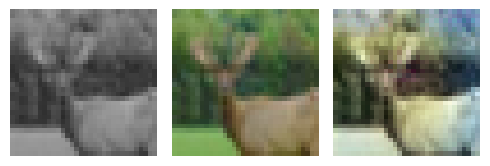

EPOCH: 67.000  val_loss: 0.003  (7628.57s - 3757.36s remaining)

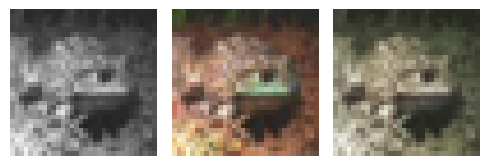

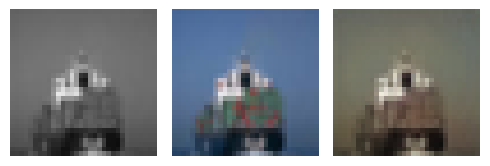

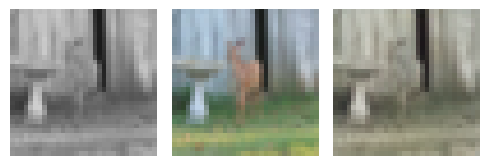

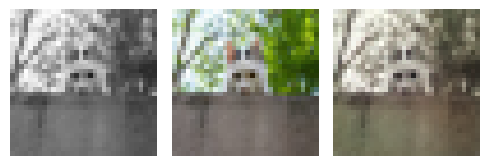

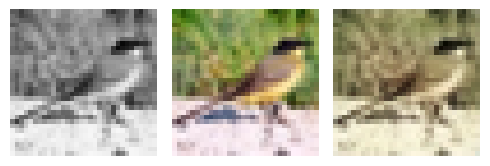

EPOCH: 67.250  trn_loss: 0.005  (7655.51s - 3728.15s remaining)

EPOCH: 67.255  trn_loss: 0.005  (7656.05s - 3727.55s remaining)

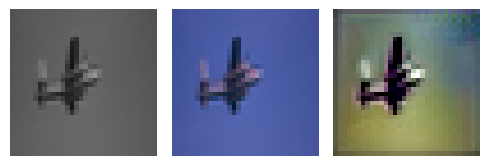

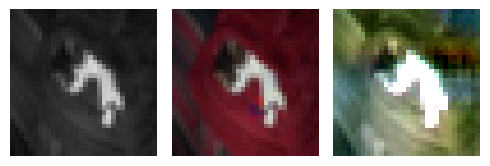

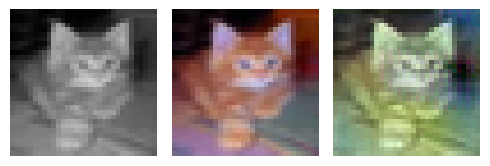

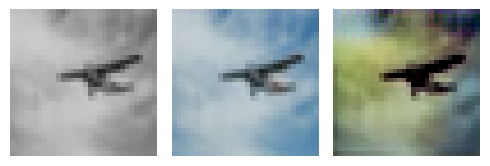

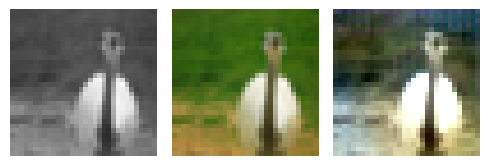

EPOCH: 67.429  trn_loss: 0.004  (7674.91s - 3707.37s remaining)

In [ ]:
model, optimizer, criterion = get_model()
exp_lr_scheduler = optim.lr_scheduler.StepLR(optimizer, step_size=10, gamma=0.1)

_val_dl = DataLoader(val_ds, batch_size=1, shuffle=True)

n_epochs = 100
log = Report(n_epochs)
for ex in range(n_epochs):
    N = len(trn_dl)
    for bx, data in enumerate(trn_dl):
        loss = train_batch(model, data, optimizer, criterion)
        log.record(ex+(bx+1)/N, trn_loss=loss, end='\r')
        if (bx+1)%50 == 0:
            for _ in range(5):
                a,b = next(iter(_val_dl))
                _b = model(a)
                subplots([a[0], b[0], _b[0]], nc=3, figsize=(5,5))

    N = len(val_dl)
    for bx, data in enumerate(val_dl):
        loss = validate_batch(model, data, criterion)
        log.record(ex+(bx+1)/N, val_loss=loss, end='\r')

    exp_lr_scheduler.step()
    if (ex+1) % 5 == 0: log.report_avgs(ex+1)

    for _ in range(5):
        a,b = next(iter(_val_dl))
        _b = model(a)
        subplots([a[0], b[0], _b[0]], nc=3, figsize=(5,5))

log.plot(log=True)

In [ ]:
log.plot_epochs()

---